# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

Já existe uma subpasta ou um arquivo data.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

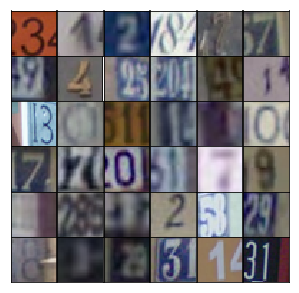

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        x = tf.reshape(x, (-1, 4, 4, 512))
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(x * alpha, x)
        
        x = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(x * alpha, x)
        
        x = tf.layers.conv2d_transpose(x, 128, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(x * alpha, x)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x = tf.maximum(alpha * x, x)
        
        x = tf.layers.conv2d(x, 128, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        
        x = tf.layers.conv2d(x, 256, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        
        x = tf.reshape(x, (-1, 4*4*256))
        logits = tf.layers.dense(x, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2667... Generator Loss: 0.7820
Epoch 1/25... Discriminator Loss: 0.2878... Generator Loss: 2.6274
Epoch 1/25... Discriminator Loss: 0.1774... Generator Loss: 2.4189
Epoch 1/25... Discriminator Loss: 0.1211... Generator Loss: 3.5577
Epoch 1/25... Discriminator Loss: 0.1422... Generator Loss: 2.9390
Epoch 1/25... Discriminator Loss: 0.1461... Generator Loss: 2.6351
Epoch 1/25... Discriminator Loss: 0.0923... Generator Loss: 3.2517
Epoch 1/25... Discriminator Loss: 0.1029... Generator Loss: 3.1475
Epoch 1/25... Discriminator Loss: 0.1471... Generator Loss: 3.4432
Epoch 1/25... Discriminator Loss: 0.1270... Generator Loss: 3.1254


c:\users\jonat\anaconda3\envs\dl-py35\lib\site-packages\matplotlib\axes\_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


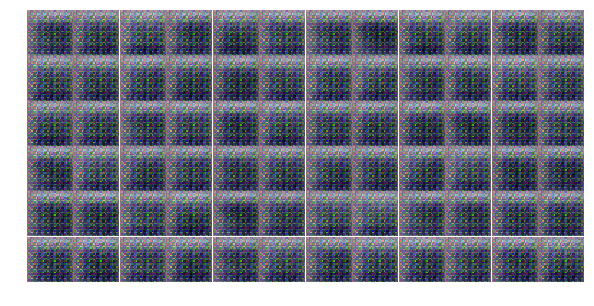

Epoch 1/25... Discriminator Loss: 0.1565... Generator Loss: 3.7192
Epoch 1/25... Discriminator Loss: 0.2995... Generator Loss: 2.7321
Epoch 1/25... Discriminator Loss: 0.7810... Generator Loss: 2.8466
Epoch 1/25... Discriminator Loss: 0.5995... Generator Loss: 1.8342
Epoch 1/25... Discriminator Loss: 0.7861... Generator Loss: 1.4361
Epoch 1/25... Discriminator Loss: 0.4455... Generator Loss: 1.7959
Epoch 1/25... Discriminator Loss: 0.6253... Generator Loss: 1.1352
Epoch 1/25... Discriminator Loss: 0.5923... Generator Loss: 3.8849
Epoch 1/25... Discriminator Loss: 0.4741... Generator Loss: 2.5781
Epoch 1/25... Discriminator Loss: 0.4195... Generator Loss: 2.6575


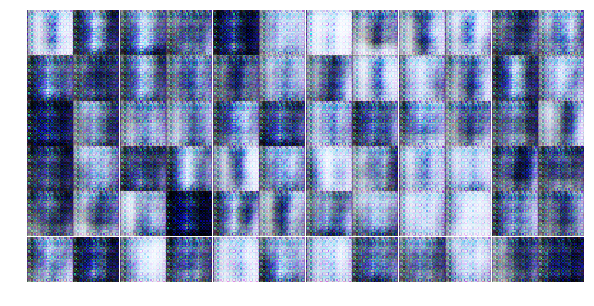

Epoch 1/25... Discriminator Loss: 0.7210... Generator Loss: 1.2595
Epoch 1/25... Discriminator Loss: 0.8146... Generator Loss: 4.0601
Epoch 1/25... Discriminator Loss: 0.9000... Generator Loss: 0.8191
Epoch 1/25... Discriminator Loss: 1.3367... Generator Loss: 4.6169
Epoch 1/25... Discriminator Loss: 1.8477... Generator Loss: 3.8754
Epoch 1/25... Discriminator Loss: 2.1034... Generator Loss: 0.3759
Epoch 1/25... Discriminator Loss: 1.2397... Generator Loss: 2.5824
Epoch 1/25... Discriminator Loss: 0.3818... Generator Loss: 2.6330
Epoch 1/25... Discriminator Loss: 0.4834... Generator Loss: 2.1684
Epoch 1/25... Discriminator Loss: 0.9612... Generator Loss: 1.6797


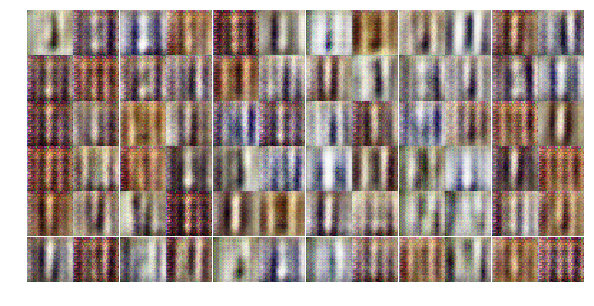

Epoch 1/25... Discriminator Loss: 1.0621... Generator Loss: 1.1627
Epoch 1/25... Discriminator Loss: 0.6901... Generator Loss: 1.6991
Epoch 1/25... Discriminator Loss: 0.9649... Generator Loss: 0.9452
Epoch 1/25... Discriminator Loss: 0.6858... Generator Loss: 1.8329
Epoch 1/25... Discriminator Loss: 0.8776... Generator Loss: 1.0683
Epoch 1/25... Discriminator Loss: 1.1829... Generator Loss: 0.6269
Epoch 1/25... Discriminator Loss: 1.6474... Generator Loss: 0.2903
Epoch 1/25... Discriminator Loss: 0.5214... Generator Loss: 1.7751
Epoch 1/25... Discriminator Loss: 0.7274... Generator Loss: 1.3260
Epoch 1/25... Discriminator Loss: 1.0857... Generator Loss: 1.5906


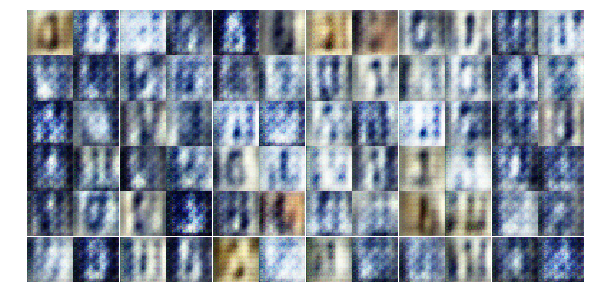

Epoch 1/25... Discriminator Loss: 1.0263... Generator Loss: 0.9579
Epoch 1/25... Discriminator Loss: 0.5446... Generator Loss: 1.4232
Epoch 1/25... Discriminator Loss: 0.7754... Generator Loss: 1.4362
Epoch 1/25... Discriminator Loss: 0.7646... Generator Loss: 1.1228
Epoch 1/25... Discriminator Loss: 0.8566... Generator Loss: 1.3689
Epoch 1/25... Discriminator Loss: 0.7766... Generator Loss: 0.9451
Epoch 1/25... Discriminator Loss: 0.7597... Generator Loss: 1.7599
Epoch 1/25... Discriminator Loss: 0.7253... Generator Loss: 1.3366
Epoch 1/25... Discriminator Loss: 1.1188... Generator Loss: 0.7271
Epoch 1/25... Discriminator Loss: 0.8949... Generator Loss: 0.8286


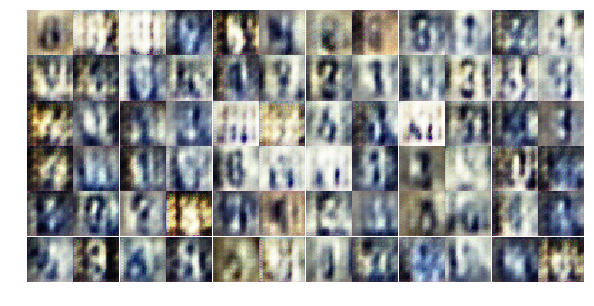

Epoch 1/25... Discriminator Loss: 0.7450... Generator Loss: 1.4452
Epoch 1/25... Discriminator Loss: 0.7720... Generator Loss: 1.2971
Epoch 1/25... Discriminator Loss: 0.8177... Generator Loss: 1.4393
Epoch 1/25... Discriminator Loss: 0.9877... Generator Loss: 1.0080
Epoch 1/25... Discriminator Loss: 1.0691... Generator Loss: 1.4095
Epoch 1/25... Discriminator Loss: 1.1217... Generator Loss: 1.2302
Epoch 1/25... Discriminator Loss: 0.9952... Generator Loss: 1.1004
Epoch 2/25... Discriminator Loss: 1.2390... Generator Loss: 0.9868
Epoch 2/25... Discriminator Loss: 0.6282... Generator Loss: 1.8151
Epoch 2/25... Discriminator Loss: 0.9412... Generator Loss: 1.0066


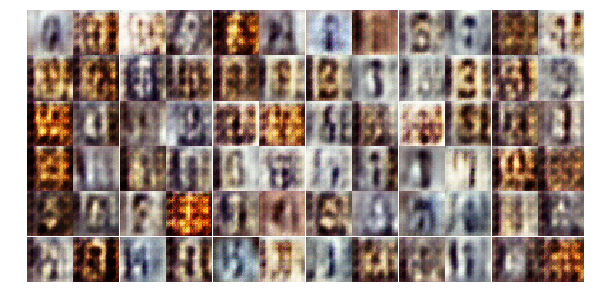

Epoch 2/25... Discriminator Loss: 0.9829... Generator Loss: 1.1593
Epoch 2/25... Discriminator Loss: 1.1835... Generator Loss: 0.9436
Epoch 2/25... Discriminator Loss: 1.1486... Generator Loss: 0.9177
Epoch 2/25... Discriminator Loss: 1.0021... Generator Loss: 1.1804
Epoch 2/25... Discriminator Loss: 1.0237... Generator Loss: 0.7633
Epoch 2/25... Discriminator Loss: 0.8252... Generator Loss: 1.1204
Epoch 2/25... Discriminator Loss: 0.8575... Generator Loss: 1.4329
Epoch 2/25... Discriminator Loss: 0.9944... Generator Loss: 0.8684
Epoch 2/25... Discriminator Loss: 0.8559... Generator Loss: 1.1151
Epoch 2/25... Discriminator Loss: 0.8183... Generator Loss: 1.2575


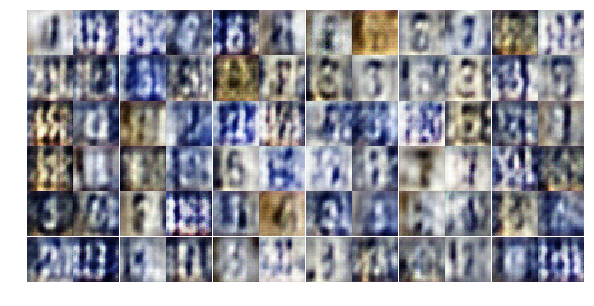

Epoch 2/25... Discriminator Loss: 1.0875... Generator Loss: 0.9294
Epoch 2/25... Discriminator Loss: 0.8328... Generator Loss: 1.3954
Epoch 2/25... Discriminator Loss: 1.1088... Generator Loss: 0.8706
Epoch 2/25... Discriminator Loss: 0.9686... Generator Loss: 0.9357
Epoch 2/25... Discriminator Loss: 1.3837... Generator Loss: 0.7067
Epoch 2/25... Discriminator Loss: 1.3331... Generator Loss: 0.9841
Epoch 2/25... Discriminator Loss: 1.2066... Generator Loss: 0.7412
Epoch 2/25... Discriminator Loss: 1.4253... Generator Loss: 0.6803
Epoch 2/25... Discriminator Loss: 1.4362... Generator Loss: 0.6503
Epoch 2/25... Discriminator Loss: 1.5631... Generator Loss: 0.5167


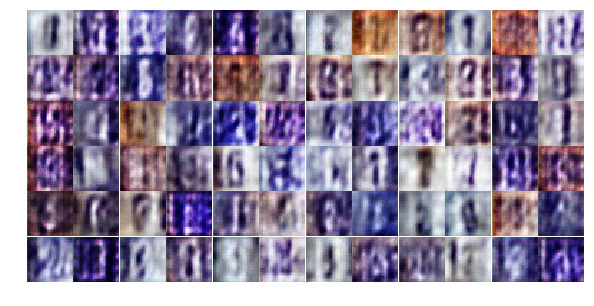

Epoch 2/25... Discriminator Loss: 1.5409... Generator Loss: 0.6950
Epoch 2/25... Discriminator Loss: 1.0459... Generator Loss: 0.9726
Epoch 2/25... Discriminator Loss: 1.3553... Generator Loss: 0.9171
Epoch 2/25... Discriminator Loss: 0.9279... Generator Loss: 1.0577
Epoch 2/25... Discriminator Loss: 1.1461... Generator Loss: 0.8333
Epoch 2/25... Discriminator Loss: 0.9257... Generator Loss: 1.0211
Epoch 2/25... Discriminator Loss: 1.0313... Generator Loss: 0.8674
Epoch 2/25... Discriminator Loss: 1.4753... Generator Loss: 0.4157
Epoch 2/25... Discriminator Loss: 1.2226... Generator Loss: 0.8577
Epoch 2/25... Discriminator Loss: 1.0493... Generator Loss: 0.9143


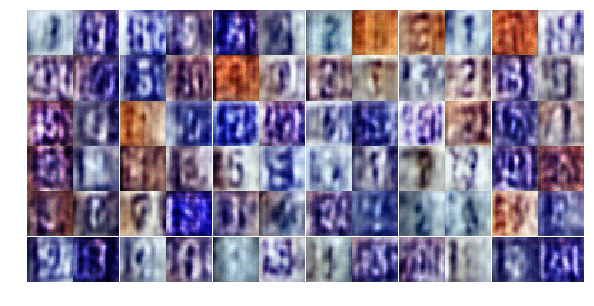

Epoch 2/25... Discriminator Loss: 1.1273... Generator Loss: 1.0427
Epoch 2/25... Discriminator Loss: 1.0970... Generator Loss: 1.0272
Epoch 2/25... Discriminator Loss: 0.9468... Generator Loss: 0.8982
Epoch 2/25... Discriminator Loss: 1.3346... Generator Loss: 0.5641
Epoch 2/25... Discriminator Loss: 1.0311... Generator Loss: 1.1052
Epoch 2/25... Discriminator Loss: 1.1930... Generator Loss: 0.8429
Epoch 2/25... Discriminator Loss: 1.1684... Generator Loss: 0.8827
Epoch 2/25... Discriminator Loss: 0.9639... Generator Loss: 1.3670
Epoch 2/25... Discriminator Loss: 1.0268... Generator Loss: 0.8633
Epoch 2/25... Discriminator Loss: 1.2101... Generator Loss: 0.7231


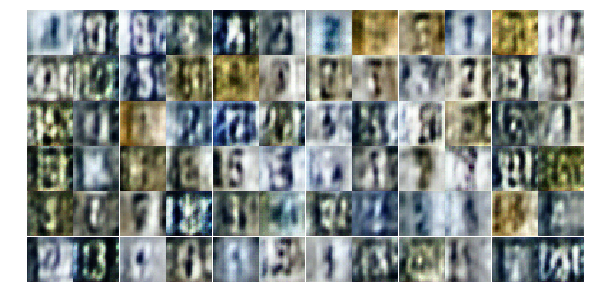

Epoch 2/25... Discriminator Loss: 0.9122... Generator Loss: 1.3224
Epoch 2/25... Discriminator Loss: 1.2274... Generator Loss: 0.8114
Epoch 2/25... Discriminator Loss: 0.7606... Generator Loss: 1.0703
Epoch 2/25... Discriminator Loss: 0.9865... Generator Loss: 1.0886
Epoch 2/25... Discriminator Loss: 1.2370... Generator Loss: 1.8414
Epoch 2/25... Discriminator Loss: 0.9798... Generator Loss: 0.9836
Epoch 2/25... Discriminator Loss: 1.1771... Generator Loss: 1.9171
Epoch 2/25... Discriminator Loss: 0.8906... Generator Loss: 1.4352
Epoch 2/25... Discriminator Loss: 1.1229... Generator Loss: 0.5728
Epoch 2/25... Discriminator Loss: 0.9503... Generator Loss: 0.8913


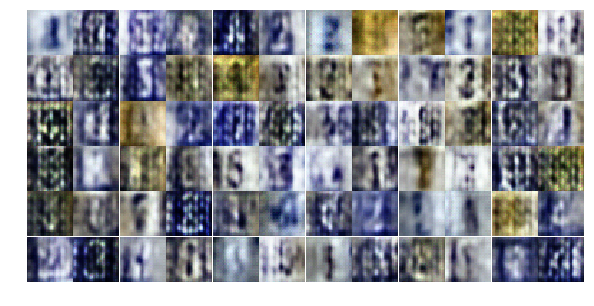

Epoch 2/25... Discriminator Loss: 1.2253... Generator Loss: 1.1852
Epoch 2/25... Discriminator Loss: 0.9230... Generator Loss: 0.9121
Epoch 2/25... Discriminator Loss: 1.5782... Generator Loss: 0.4129
Epoch 2/25... Discriminator Loss: 0.9541... Generator Loss: 0.9539
Epoch 3/25... Discriminator Loss: 0.9471... Generator Loss: 2.0665
Epoch 3/25... Discriminator Loss: 0.9341... Generator Loss: 1.1470
Epoch 3/25... Discriminator Loss: 0.8952... Generator Loss: 1.4240
Epoch 3/25... Discriminator Loss: 0.8015... Generator Loss: 0.9515
Epoch 3/25... Discriminator Loss: 0.6518... Generator Loss: 1.6765
Epoch 3/25... Discriminator Loss: 0.7284... Generator Loss: 1.2667


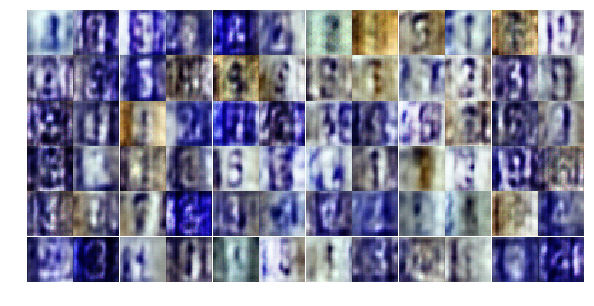

Epoch 3/25... Discriminator Loss: 0.6596... Generator Loss: 1.3944
Epoch 3/25... Discriminator Loss: 0.7489... Generator Loss: 1.7216
Epoch 3/25... Discriminator Loss: 0.8018... Generator Loss: 1.3062
Epoch 3/25... Discriminator Loss: 0.6795... Generator Loss: 1.3653
Epoch 3/25... Discriminator Loss: 0.7149... Generator Loss: 2.1555
Epoch 3/25... Discriminator Loss: 1.0349... Generator Loss: 0.9282
Epoch 3/25... Discriminator Loss: 1.0700... Generator Loss: 0.6721
Epoch 3/25... Discriminator Loss: 0.5595... Generator Loss: 1.3380
Epoch 3/25... Discriminator Loss: 1.1319... Generator Loss: 0.5487
Epoch 3/25... Discriminator Loss: 0.6654... Generator Loss: 1.1482


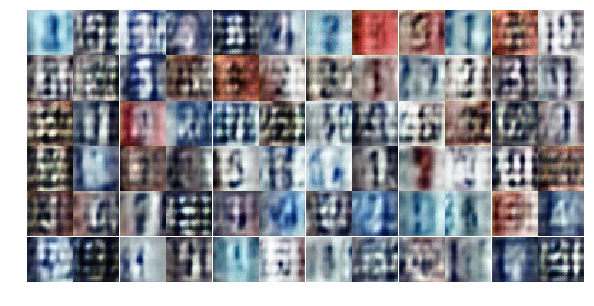

Epoch 3/25... Discriminator Loss: 0.8677... Generator Loss: 2.3474
Epoch 3/25... Discriminator Loss: 0.4537... Generator Loss: 1.6953
Epoch 3/25... Discriminator Loss: 0.6061... Generator Loss: 1.8104
Epoch 3/25... Discriminator Loss: 0.7294... Generator Loss: 2.0344
Epoch 3/25... Discriminator Loss: 0.8557... Generator Loss: 2.0836
Epoch 3/25... Discriminator Loss: 0.3035... Generator Loss: 3.2127
Epoch 3/25... Discriminator Loss: 1.1900... Generator Loss: 0.4804
Epoch 3/25... Discriminator Loss: 0.8884... Generator Loss: 1.6810
Epoch 3/25... Discriminator Loss: 0.4535... Generator Loss: 2.7314
Epoch 3/25... Discriminator Loss: 0.7067... Generator Loss: 0.9820


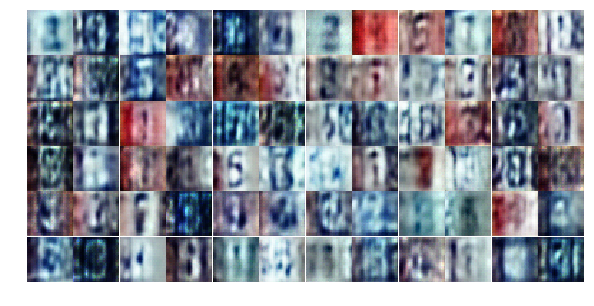

Epoch 3/25... Discriminator Loss: 0.3435... Generator Loss: 1.9291
Epoch 3/25... Discriminator Loss: 1.2773... Generator Loss: 0.5174
Epoch 3/25... Discriminator Loss: 0.5804... Generator Loss: 1.2007
Epoch 3/25... Discriminator Loss: 1.5458... Generator Loss: 0.3220
Epoch 3/25... Discriminator Loss: 0.4673... Generator Loss: 1.5208
Epoch 3/25... Discriminator Loss: 0.9916... Generator Loss: 0.6512
Epoch 3/25... Discriminator Loss: 0.6747... Generator Loss: 1.5027
Epoch 3/25... Discriminator Loss: 1.3459... Generator Loss: 0.8210
Epoch 3/25... Discriminator Loss: 0.8506... Generator Loss: 2.6448
Epoch 3/25... Discriminator Loss: 1.3522... Generator Loss: 0.5093


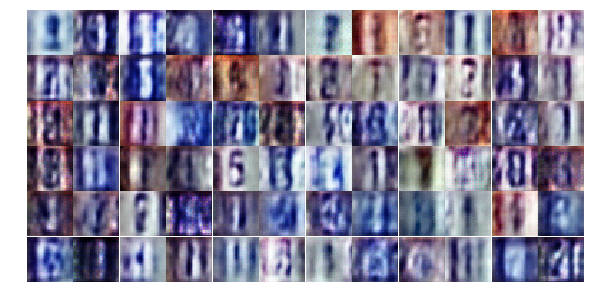

Epoch 3/25... Discriminator Loss: 0.6870... Generator Loss: 1.5529
Epoch 3/25... Discriminator Loss: 0.5661... Generator Loss: 2.2656
Epoch 3/25... Discriminator Loss: 1.3103... Generator Loss: 0.5939
Epoch 3/25... Discriminator Loss: 0.5433... Generator Loss: 1.6062
Epoch 3/25... Discriminator Loss: 0.2887... Generator Loss: 2.4641
Epoch 3/25... Discriminator Loss: 0.6685... Generator Loss: 1.1083
Epoch 3/25... Discriminator Loss: 0.5337... Generator Loss: 1.6166
Epoch 3/25... Discriminator Loss: 0.6144... Generator Loss: 1.4073
Epoch 3/25... Discriminator Loss: 0.6832... Generator Loss: 1.3043
Epoch 3/25... Discriminator Loss: 0.4756... Generator Loss: 2.1589


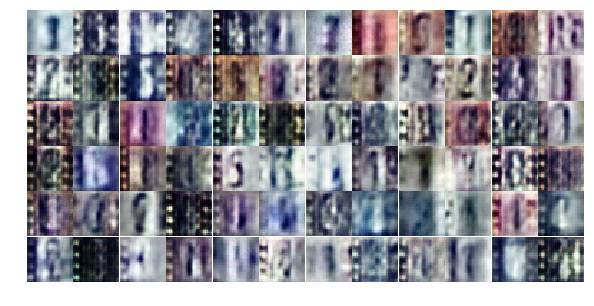

Epoch 3/25... Discriminator Loss: 0.4132... Generator Loss: 1.9241
Epoch 3/25... Discriminator Loss: 1.1143... Generator Loss: 0.9062
Epoch 3/25... Discriminator Loss: 0.2441... Generator Loss: 2.5496
Epoch 3/25... Discriminator Loss: 0.6261... Generator Loss: 1.4948
Epoch 3/25... Discriminator Loss: 0.6603... Generator Loss: 2.1662
Epoch 3/25... Discriminator Loss: 0.4477... Generator Loss: 2.0190
Epoch 3/25... Discriminator Loss: 0.3571... Generator Loss: 2.2540
Epoch 3/25... Discriminator Loss: 0.8098... Generator Loss: 3.9163
Epoch 3/25... Discriminator Loss: 0.7470... Generator Loss: 3.0471
Epoch 3/25... Discriminator Loss: 0.5272... Generator Loss: 1.8686


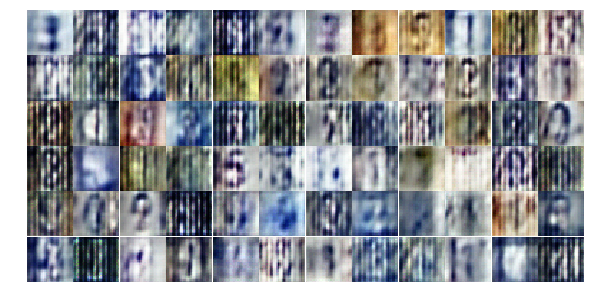

Epoch 3/25... Discriminator Loss: 0.8439... Generator Loss: 0.9395
Epoch 4/25... Discriminator Loss: 0.8424... Generator Loss: 0.8337
Epoch 4/25... Discriminator Loss: 0.3870... Generator Loss: 2.1718
Epoch 4/25... Discriminator Loss: 0.7400... Generator Loss: 1.9656
Epoch 4/25... Discriminator Loss: 0.8477... Generator Loss: 1.4334
Epoch 4/25... Discriminator Loss: 0.5788... Generator Loss: 1.7386
Epoch 4/25... Discriminator Loss: 0.3954... Generator Loss: 1.6838
Epoch 4/25... Discriminator Loss: 0.5175... Generator Loss: 2.6044
Epoch 4/25... Discriminator Loss: 0.3529... Generator Loss: 1.6854
Epoch 4/25... Discriminator Loss: 0.4545... Generator Loss: 1.6674


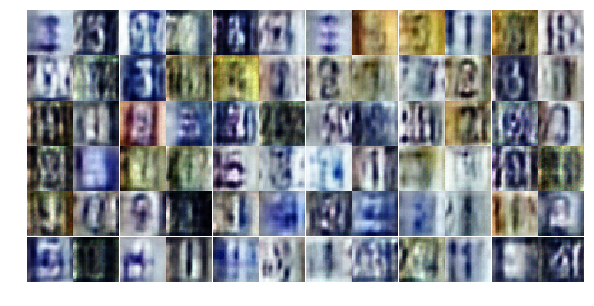

Epoch 4/25... Discriminator Loss: 0.5208... Generator Loss: 1.9268
Epoch 4/25... Discriminator Loss: 0.7162... Generator Loss: 1.3418
Epoch 4/25... Discriminator Loss: 0.7474... Generator Loss: 1.1100
Epoch 4/25... Discriminator Loss: 0.5810... Generator Loss: 1.9199
Epoch 4/25... Discriminator Loss: 0.7154... Generator Loss: 2.6217
Epoch 4/25... Discriminator Loss: 1.5575... Generator Loss: 0.3452
Epoch 4/25... Discriminator Loss: 0.8887... Generator Loss: 1.2172
Epoch 4/25... Discriminator Loss: 0.5622... Generator Loss: 1.8169
Epoch 4/25... Discriminator Loss: 2.1364... Generator Loss: 3.4205
Epoch 4/25... Discriminator Loss: 1.0364... Generator Loss: 2.0636


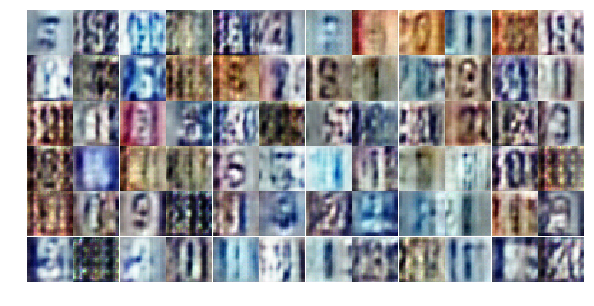

Epoch 4/25... Discriminator Loss: 0.3641... Generator Loss: 2.3850
Epoch 4/25... Discriminator Loss: 0.6082... Generator Loss: 2.1223
Epoch 4/25... Discriminator Loss: 0.9364... Generator Loss: 0.7783
Epoch 4/25... Discriminator Loss: 0.6531... Generator Loss: 1.5849
Epoch 4/25... Discriminator Loss: 0.5816... Generator Loss: 1.6687
Epoch 4/25... Discriminator Loss: 0.5442... Generator Loss: 2.5747
Epoch 4/25... Discriminator Loss: 0.2960... Generator Loss: 2.0890
Epoch 4/25... Discriminator Loss: 0.7135... Generator Loss: 2.3023
Epoch 4/25... Discriminator Loss: 0.4696... Generator Loss: 1.9982
Epoch 4/25... Discriminator Loss: 0.4257... Generator Loss: 1.6545


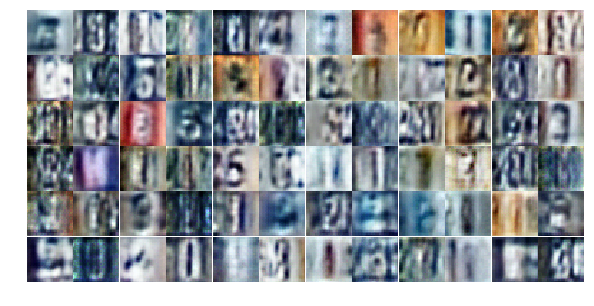

Epoch 4/25... Discriminator Loss: 0.5371... Generator Loss: 1.4892
Epoch 4/25... Discriminator Loss: 0.5923... Generator Loss: 1.6930
Epoch 4/25... Discriminator Loss: 0.5411... Generator Loss: 1.3915
Epoch 4/25... Discriminator Loss: 0.5255... Generator Loss: 1.8808
Epoch 4/25... Discriminator Loss: 0.4696... Generator Loss: 2.3085
Epoch 4/25... Discriminator Loss: 0.4481... Generator Loss: 2.4746
Epoch 4/25... Discriminator Loss: 0.4357... Generator Loss: 2.0235
Epoch 4/25... Discriminator Loss: 0.7872... Generator Loss: 0.9417
Epoch 4/25... Discriminator Loss: 0.6853... Generator Loss: 1.1718
Epoch 4/25... Discriminator Loss: 0.8645... Generator Loss: 1.0490


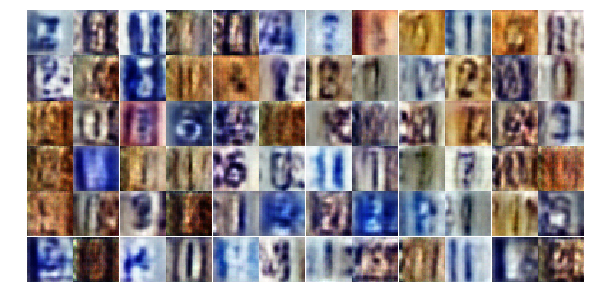

Epoch 4/25... Discriminator Loss: 1.1963... Generator Loss: 0.5673
Epoch 4/25... Discriminator Loss: 0.4999... Generator Loss: 1.7808
Epoch 4/25... Discriminator Loss: 0.3659... Generator Loss: 2.0259
Epoch 4/25... Discriminator Loss: 0.7525... Generator Loss: 1.1191
Epoch 4/25... Discriminator Loss: 0.5393... Generator Loss: 1.7443
Epoch 4/25... Discriminator Loss: 0.8735... Generator Loss: 0.8558
Epoch 4/25... Discriminator Loss: 0.4935... Generator Loss: 1.3051
Epoch 4/25... Discriminator Loss: 0.4214... Generator Loss: 2.2572
Epoch 4/25... Discriminator Loss: 1.7278... Generator Loss: 0.2598
Epoch 4/25... Discriminator Loss: 0.6433... Generator Loss: 1.6336


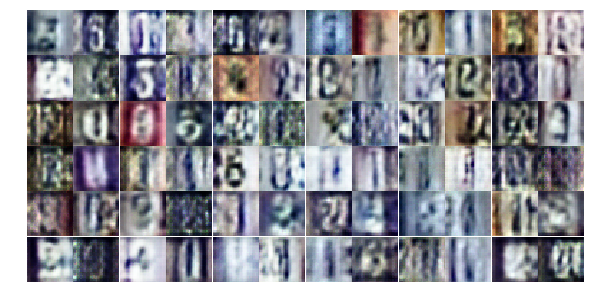

Epoch 4/25... Discriminator Loss: 0.5933... Generator Loss: 1.1401
Epoch 4/25... Discriminator Loss: 0.4677... Generator Loss: 2.4458
Epoch 4/25... Discriminator Loss: 0.6205... Generator Loss: 2.2109
Epoch 4/25... Discriminator Loss: 0.6499... Generator Loss: 1.2775
Epoch 4/25... Discriminator Loss: 0.8522... Generator Loss: 0.8359
Epoch 4/25... Discriminator Loss: 0.6999... Generator Loss: 1.5549
Epoch 4/25... Discriminator Loss: 1.1893... Generator Loss: 0.5100
Epoch 4/25... Discriminator Loss: 1.4113... Generator Loss: 0.3783
Epoch 4/25... Discriminator Loss: 0.5657... Generator Loss: 2.0111
Epoch 5/25... Discriminator Loss: 0.6306... Generator Loss: 1.0425


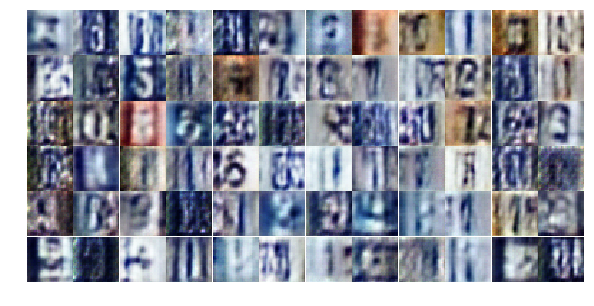

Epoch 5/25... Discriminator Loss: 0.4994... Generator Loss: 1.4661
Epoch 5/25... Discriminator Loss: 0.7222... Generator Loss: 0.8678
Epoch 5/25... Discriminator Loss: 0.5135... Generator Loss: 1.3807
Epoch 5/25... Discriminator Loss: 0.5432... Generator Loss: 1.1610
Epoch 5/25... Discriminator Loss: 0.3303... Generator Loss: 2.2346
Epoch 5/25... Discriminator Loss: 0.5019... Generator Loss: 1.2704
Epoch 5/25... Discriminator Loss: 1.8396... Generator Loss: 0.3387
Epoch 5/25... Discriminator Loss: 0.6902... Generator Loss: 1.6842
Epoch 5/25... Discriminator Loss: 0.7003... Generator Loss: 1.0735
Epoch 5/25... Discriminator Loss: 0.8308... Generator Loss: 0.8500


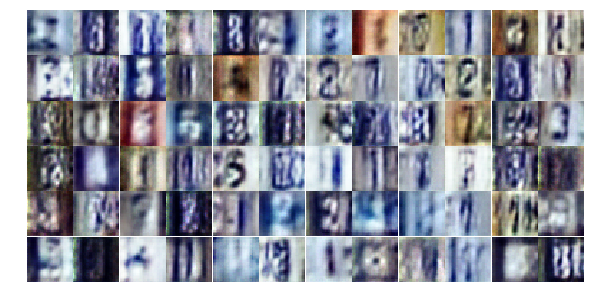

Epoch 5/25... Discriminator Loss: 0.5871... Generator Loss: 1.3322
Epoch 5/25... Discriminator Loss: 0.4412... Generator Loss: 1.7581
Epoch 5/25... Discriminator Loss: 0.4200... Generator Loss: 1.8204
Epoch 5/25... Discriminator Loss: 2.2537... Generator Loss: 0.2527
Epoch 5/25... Discriminator Loss: 0.6512... Generator Loss: 1.4933
Epoch 5/25... Discriminator Loss: 1.5636... Generator Loss: 0.3307
Epoch 5/25... Discriminator Loss: 0.5265... Generator Loss: 1.3471
Epoch 5/25... Discriminator Loss: 0.5461... Generator Loss: 1.7567
Epoch 5/25... Discriminator Loss: 0.5975... Generator Loss: 1.3604
Epoch 5/25... Discriminator Loss: 0.4928... Generator Loss: 1.5546


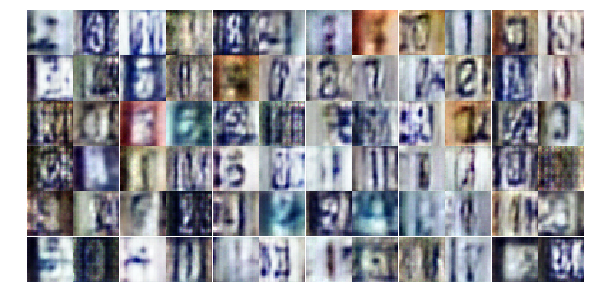

Epoch 5/25... Discriminator Loss: 0.5965... Generator Loss: 1.0752
Epoch 5/25... Discriminator Loss: 1.0193... Generator Loss: 0.6633
Epoch 5/25... Discriminator Loss: 0.6541... Generator Loss: 1.1367
Epoch 5/25... Discriminator Loss: 0.6041... Generator Loss: 1.1604
Epoch 5/25... Discriminator Loss: 0.7538... Generator Loss: 0.9586
Epoch 5/25... Discriminator Loss: 0.6499... Generator Loss: 1.0091
Epoch 5/25... Discriminator Loss: 0.9362... Generator Loss: 0.6225
Epoch 5/25... Discriminator Loss: 0.7148... Generator Loss: 1.6613
Epoch 5/25... Discriminator Loss: 0.9094... Generator Loss: 0.7324
Epoch 5/25... Discriminator Loss: 0.4764... Generator Loss: 1.4076


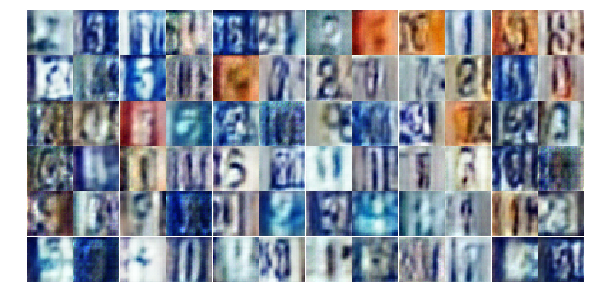

Epoch 5/25... Discriminator Loss: 0.6696... Generator Loss: 1.4342
Epoch 5/25... Discriminator Loss: 0.4758... Generator Loss: 1.5396
Epoch 5/25... Discriminator Loss: 0.5855... Generator Loss: 1.1629
Epoch 5/25... Discriminator Loss: 0.6253... Generator Loss: 1.0799
Epoch 5/25... Discriminator Loss: 0.7825... Generator Loss: 2.1452
Epoch 5/25... Discriminator Loss: 0.8411... Generator Loss: 2.2793
Epoch 5/25... Discriminator Loss: 0.9189... Generator Loss: 0.6635
Epoch 5/25... Discriminator Loss: 0.5301... Generator Loss: 1.2793
Epoch 5/25... Discriminator Loss: 0.8365... Generator Loss: 0.8503
Epoch 5/25... Discriminator Loss: 0.3877... Generator Loss: 1.7057


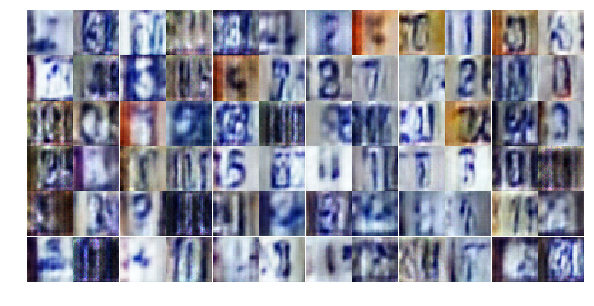

Epoch 5/25... Discriminator Loss: 0.5683... Generator Loss: 1.3909
Epoch 5/25... Discriminator Loss: 0.5934... Generator Loss: 1.4419
Epoch 5/25... Discriminator Loss: 0.5304... Generator Loss: 1.4029
Epoch 5/25... Discriminator Loss: 1.2598... Generator Loss: 0.4936
Epoch 5/25... Discriminator Loss: 1.1950... Generator Loss: 0.5405
Epoch 5/25... Discriminator Loss: 0.8169... Generator Loss: 1.4259
Epoch 5/25... Discriminator Loss: 0.7356... Generator Loss: 1.4371
Epoch 5/25... Discriminator Loss: 0.4193... Generator Loss: 1.7857
Epoch 5/25... Discriminator Loss: 0.9200... Generator Loss: 0.6943
Epoch 5/25... Discriminator Loss: 0.6164... Generator Loss: 1.5563


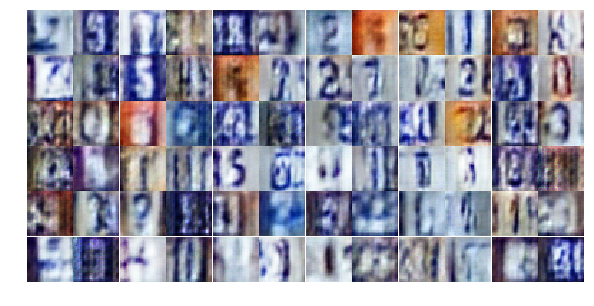

Epoch 5/25... Discriminator Loss: 0.6124... Generator Loss: 1.1365
Epoch 5/25... Discriminator Loss: 1.0369... Generator Loss: 0.6215
Epoch 5/25... Discriminator Loss: 0.8769... Generator Loss: 1.8249
Epoch 5/25... Discriminator Loss: 1.0633... Generator Loss: 0.6252
Epoch 5/25... Discriminator Loss: 0.5991... Generator Loss: 1.3835
Epoch 5/25... Discriminator Loss: 0.7842... Generator Loss: 1.3945
Epoch 6/25... Discriminator Loss: 0.9503... Generator Loss: 1.5394
Epoch 6/25... Discriminator Loss: 0.6029... Generator Loss: 2.0917
Epoch 6/25... Discriminator Loss: 0.6528... Generator Loss: 1.3336
Epoch 6/25... Discriminator Loss: 0.7522... Generator Loss: 1.0280


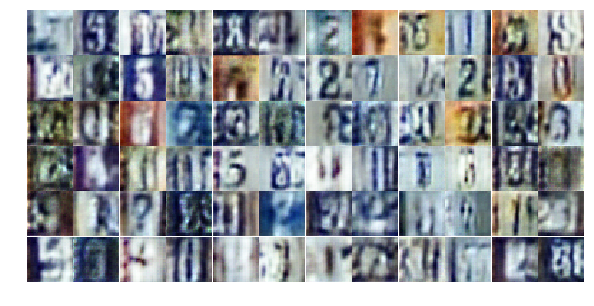

Epoch 6/25... Discriminator Loss: 0.6981... Generator Loss: 1.0446
Epoch 6/25... Discriminator Loss: 0.7586... Generator Loss: 1.1074
Epoch 6/25... Discriminator Loss: 0.6258... Generator Loss: 1.1021
Epoch 6/25... Discriminator Loss: 0.7708... Generator Loss: 1.0253
Epoch 6/25... Discriminator Loss: 0.6681... Generator Loss: 1.0312
Epoch 6/25... Discriminator Loss: 0.5397... Generator Loss: 1.2209
Epoch 6/25... Discriminator Loss: 0.5631... Generator Loss: 1.5367
Epoch 6/25... Discriminator Loss: 0.6902... Generator Loss: 1.6667
Epoch 6/25... Discriminator Loss: 0.6372... Generator Loss: 1.1005
Epoch 6/25... Discriminator Loss: 0.4828... Generator Loss: 1.4077


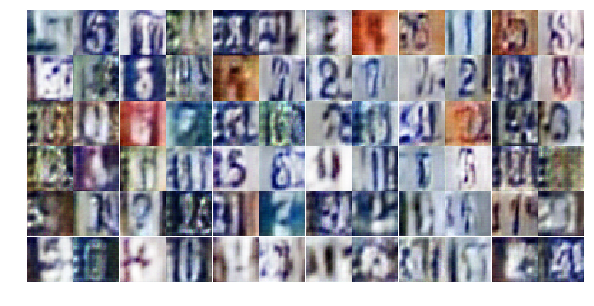

Epoch 6/25... Discriminator Loss: 0.6179... Generator Loss: 1.1927
Epoch 6/25... Discriminator Loss: 2.7124... Generator Loss: 4.6649
Epoch 6/25... Discriminator Loss: 1.5639... Generator Loss: 0.3229
Epoch 6/25... Discriminator Loss: 0.3401... Generator Loss: 1.8794
Epoch 6/25... Discriminator Loss: 0.5044... Generator Loss: 1.7629
Epoch 6/25... Discriminator Loss: 0.6189... Generator Loss: 1.5892
Epoch 6/25... Discriminator Loss: 0.6628... Generator Loss: 1.1644
Epoch 6/25... Discriminator Loss: 0.7944... Generator Loss: 0.8915
Epoch 6/25... Discriminator Loss: 0.7280... Generator Loss: 1.8426
Epoch 6/25... Discriminator Loss: 0.7500... Generator Loss: 1.1936


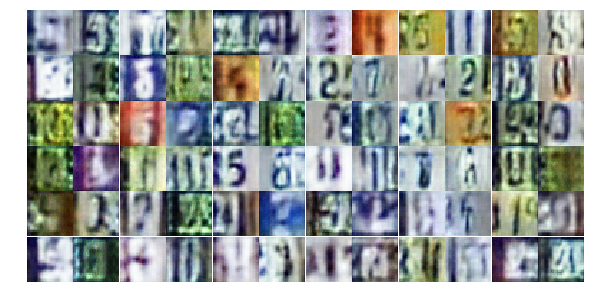

Epoch 6/25... Discriminator Loss: 0.9547... Generator Loss: 0.6498
Epoch 6/25... Discriminator Loss: 1.0654... Generator Loss: 0.5772
Epoch 6/25... Discriminator Loss: 0.8074... Generator Loss: 0.8203
Epoch 6/25... Discriminator Loss: 0.9363... Generator Loss: 0.6619
Epoch 6/25... Discriminator Loss: 0.5528... Generator Loss: 1.5677
Epoch 6/25... Discriminator Loss: 0.7401... Generator Loss: 0.9662
Epoch 6/25... Discriminator Loss: 0.7068... Generator Loss: 1.3140
Epoch 6/25... Discriminator Loss: 0.3736... Generator Loss: 1.8845
Epoch 6/25... Discriminator Loss: 0.6005... Generator Loss: 1.5234
Epoch 6/25... Discriminator Loss: 0.4786... Generator Loss: 1.5702


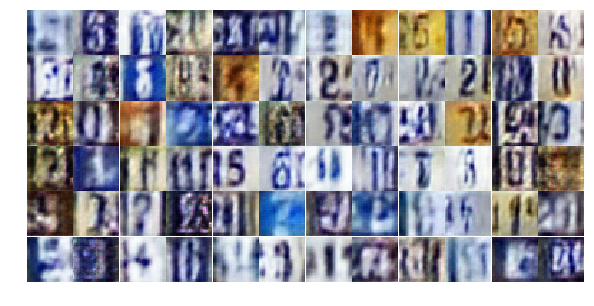

Epoch 6/25... Discriminator Loss: 1.6119... Generator Loss: 0.3049
Epoch 6/25... Discriminator Loss: 0.5748... Generator Loss: 1.6785
Epoch 6/25... Discriminator Loss: 0.7494... Generator Loss: 1.4586
Epoch 6/25... Discriminator Loss: 0.6158... Generator Loss: 1.3480
Epoch 6/25... Discriminator Loss: 0.7650... Generator Loss: 0.9042
Epoch 6/25... Discriminator Loss: 0.5486... Generator Loss: 1.3637
Epoch 6/25... Discriminator Loss: 0.5612... Generator Loss: 1.5012
Epoch 6/25... Discriminator Loss: 0.5415... Generator Loss: 1.6453
Epoch 6/25... Discriminator Loss: 1.0448... Generator Loss: 0.6121
Epoch 6/25... Discriminator Loss: 0.5482... Generator Loss: 1.1638


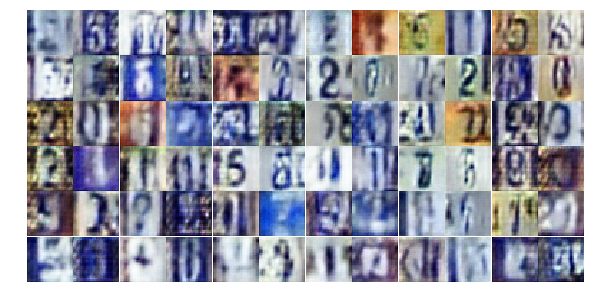

Epoch 6/25... Discriminator Loss: 0.7218... Generator Loss: 1.1930
Epoch 6/25... Discriminator Loss: 0.7773... Generator Loss: 1.6638
Epoch 6/25... Discriminator Loss: 1.0640... Generator Loss: 0.6663
Epoch 6/25... Discriminator Loss: 0.9100... Generator Loss: 2.6255
Epoch 6/25... Discriminator Loss: 0.4021... Generator Loss: 1.9686
Epoch 6/25... Discriminator Loss: 0.5623... Generator Loss: 1.7472
Epoch 6/25... Discriminator Loss: 0.7388... Generator Loss: 0.9028
Epoch 6/25... Discriminator Loss: 1.2537... Generator Loss: 0.4726
Epoch 6/25... Discriminator Loss: 0.6057... Generator Loss: 1.1657
Epoch 6/25... Discriminator Loss: 1.9354... Generator Loss: 0.2107


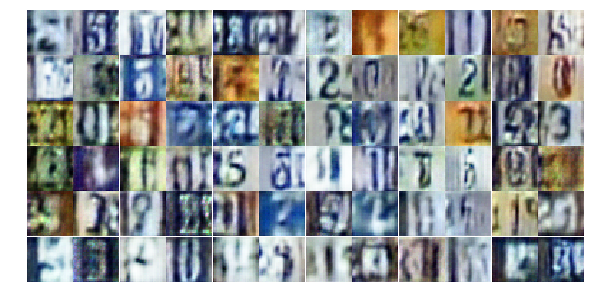

Epoch 6/25... Discriminator Loss: 0.6363... Generator Loss: 1.3531
Epoch 6/25... Discriminator Loss: 0.6594... Generator Loss: 1.1642
Epoch 6/25... Discriminator Loss: 0.6700... Generator Loss: 1.7241
Epoch 7/25... Discriminator Loss: 0.7983... Generator Loss: 1.9599
Epoch 7/25... Discriminator Loss: 0.6799... Generator Loss: 1.1491
Epoch 7/25... Discriminator Loss: 0.5784... Generator Loss: 1.4049
Epoch 7/25... Discriminator Loss: 0.5933... Generator Loss: 1.2031
Epoch 7/25... Discriminator Loss: 0.4484... Generator Loss: 1.5035
Epoch 7/25... Discriminator Loss: 0.5130... Generator Loss: 1.7973
Epoch 7/25... Discriminator Loss: 1.4415... Generator Loss: 0.4183


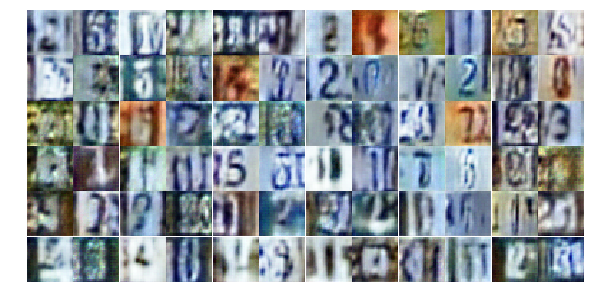

Epoch 7/25... Discriminator Loss: 0.5950... Generator Loss: 2.1830
Epoch 7/25... Discriminator Loss: 0.8670... Generator Loss: 0.7828
Epoch 7/25... Discriminator Loss: 0.7630... Generator Loss: 1.5742
Epoch 7/25... Discriminator Loss: 0.8347... Generator Loss: 0.8907
Epoch 7/25... Discriminator Loss: 0.4891... Generator Loss: 1.7021
Epoch 7/25... Discriminator Loss: 0.5199... Generator Loss: 1.3695
Epoch 7/25... Discriminator Loss: 0.8108... Generator Loss: 1.0387
Epoch 7/25... Discriminator Loss: 0.9152... Generator Loss: 2.5174
Epoch 7/25... Discriminator Loss: 0.5129... Generator Loss: 2.1018
Epoch 7/25... Discriminator Loss: 0.4827... Generator Loss: 1.7527


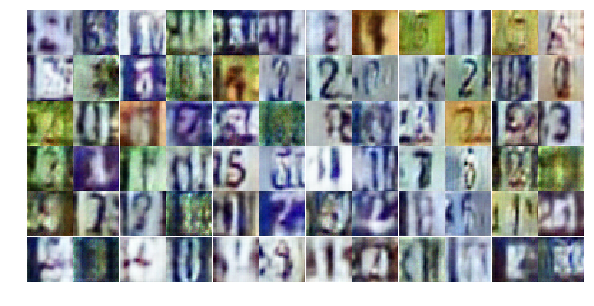

Epoch 7/25... Discriminator Loss: 0.8348... Generator Loss: 0.8158
Epoch 7/25... Discriminator Loss: 0.5544... Generator Loss: 1.2270
Epoch 7/25... Discriminator Loss: 0.9264... Generator Loss: 2.1217
Epoch 7/25... Discriminator Loss: 0.6029... Generator Loss: 1.3616
Epoch 7/25... Discriminator Loss: 0.3736... Generator Loss: 1.9419
Epoch 7/25... Discriminator Loss: 0.5718... Generator Loss: 1.6816
Epoch 7/25... Discriminator Loss: 0.5589... Generator Loss: 1.2155
Epoch 7/25... Discriminator Loss: 1.1304... Generator Loss: 0.5731
Epoch 7/25... Discriminator Loss: 0.5139... Generator Loss: 1.6718
Epoch 7/25... Discriminator Loss: 0.6830... Generator Loss: 2.9240


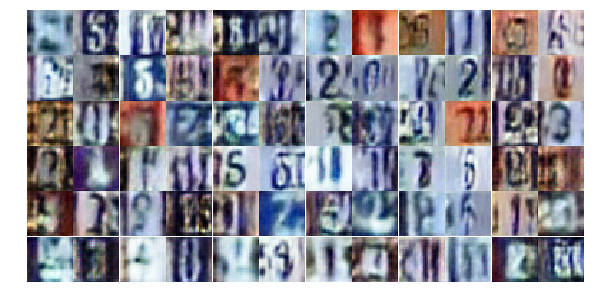

Epoch 7/25... Discriminator Loss: 0.8890... Generator Loss: 0.7792
Epoch 7/25... Discriminator Loss: 0.7230... Generator Loss: 0.9966
Epoch 7/25... Discriminator Loss: 0.3669... Generator Loss: 1.7711
Epoch 7/25... Discriminator Loss: 0.6620... Generator Loss: 1.3254
Epoch 7/25... Discriminator Loss: 0.5163... Generator Loss: 1.9064
Epoch 7/25... Discriminator Loss: 1.0155... Generator Loss: 0.5568
Epoch 7/25... Discriminator Loss: 0.8056... Generator Loss: 0.7670
Epoch 7/25... Discriminator Loss: 0.6493... Generator Loss: 1.2395
Epoch 7/25... Discriminator Loss: 0.8584... Generator Loss: 1.0771
Epoch 7/25... Discriminator Loss: 0.4844... Generator Loss: 1.9207


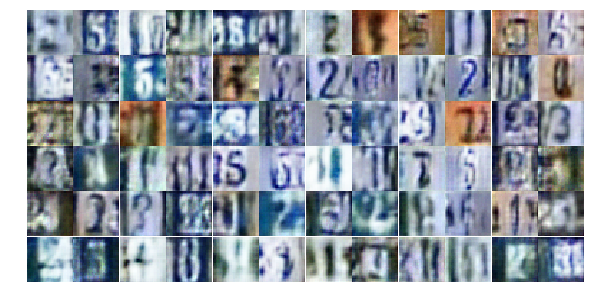

Epoch 7/25... Discriminator Loss: 0.6768... Generator Loss: 1.2146
Epoch 7/25... Discriminator Loss: 0.8229... Generator Loss: 0.8809
Epoch 7/25... Discriminator Loss: 0.5517... Generator Loss: 1.8301
Epoch 7/25... Discriminator Loss: 0.4913... Generator Loss: 1.5339
Epoch 7/25... Discriminator Loss: 0.7039... Generator Loss: 1.2569
Epoch 7/25... Discriminator Loss: 0.3868... Generator Loss: 2.1102
Epoch 7/25... Discriminator Loss: 0.9464... Generator Loss: 0.6617
Epoch 7/25... Discriminator Loss: 1.3455... Generator Loss: 0.4354
Epoch 7/25... Discriminator Loss: 0.4291... Generator Loss: 1.6761
Epoch 7/25... Discriminator Loss: 0.6014... Generator Loss: 1.2570


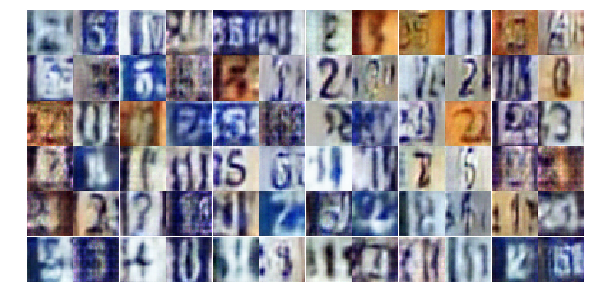

Epoch 7/25... Discriminator Loss: 0.3597... Generator Loss: 1.6588
Epoch 7/25... Discriminator Loss: 0.5443... Generator Loss: 1.3468
Epoch 7/25... Discriminator Loss: 1.0230... Generator Loss: 0.6163
Epoch 7/25... Discriminator Loss: 0.5693... Generator Loss: 1.2466
Epoch 7/25... Discriminator Loss: 0.4724... Generator Loss: 1.6181
Epoch 7/25... Discriminator Loss: 1.9676... Generator Loss: 0.2659
Epoch 7/25... Discriminator Loss: 1.7328... Generator Loss: 0.2797
Epoch 7/25... Discriminator Loss: 0.6155... Generator Loss: 2.0880
Epoch 7/25... Discriminator Loss: 0.8103... Generator Loss: 1.0921
Epoch 7/25... Discriminator Loss: 0.9676... Generator Loss: 0.6478


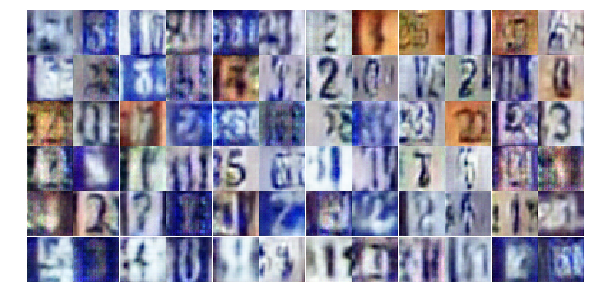

Epoch 7/25... Discriminator Loss: 0.5405... Generator Loss: 1.6672
Epoch 8/25... Discriminator Loss: 0.7173... Generator Loss: 1.0323
Epoch 8/25... Discriminator Loss: 0.7769... Generator Loss: 0.8509
Epoch 8/25... Discriminator Loss: 0.6490... Generator Loss: 1.3300
Epoch 8/25... Discriminator Loss: 0.6184... Generator Loss: 1.1095
Epoch 8/25... Discriminator Loss: 0.9524... Generator Loss: 0.7417
Epoch 8/25... Discriminator Loss: 0.7017... Generator Loss: 1.1040
Epoch 8/25... Discriminator Loss: 0.5430... Generator Loss: 1.3815
Epoch 8/25... Discriminator Loss: 0.9068... Generator Loss: 0.7376
Epoch 8/25... Discriminator Loss: 0.9653... Generator Loss: 0.6364


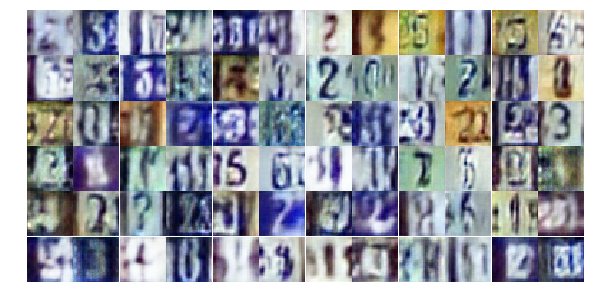

Epoch 8/25... Discriminator Loss: 0.4535... Generator Loss: 1.9147
Epoch 8/25... Discriminator Loss: 0.4272... Generator Loss: 1.8700
Epoch 8/25... Discriminator Loss: 0.9340... Generator Loss: 0.7145
Epoch 8/25... Discriminator Loss: 0.3390... Generator Loss: 1.8488
Epoch 8/25... Discriminator Loss: 0.6175... Generator Loss: 1.1596
Epoch 8/25... Discriminator Loss: 0.5903... Generator Loss: 1.8357
Epoch 8/25... Discriminator Loss: 0.7812... Generator Loss: 0.7963
Epoch 8/25... Discriminator Loss: 0.6076... Generator Loss: 1.3038
Epoch 8/25... Discriminator Loss: 1.0028... Generator Loss: 0.6457
Epoch 8/25... Discriminator Loss: 1.3034... Generator Loss: 0.4597


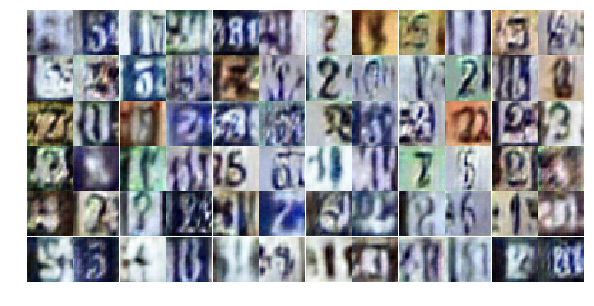

Epoch 8/25... Discriminator Loss: 0.5915... Generator Loss: 1.4910
Epoch 8/25... Discriminator Loss: 0.5779... Generator Loss: 1.4625
Epoch 8/25... Discriminator Loss: 0.6204... Generator Loss: 1.1101
Epoch 8/25... Discriminator Loss: 0.5743... Generator Loss: 1.5320
Epoch 8/25... Discriminator Loss: 0.4360... Generator Loss: 1.5857
Epoch 8/25... Discriminator Loss: 0.5625... Generator Loss: 1.3842
Epoch 8/25... Discriminator Loss: 0.5348... Generator Loss: 1.4017
Epoch 8/25... Discriminator Loss: 0.5517... Generator Loss: 1.2338
Epoch 8/25... Discriminator Loss: 1.1720... Generator Loss: 2.9504
Epoch 8/25... Discriminator Loss: 0.9170... Generator Loss: 0.7443


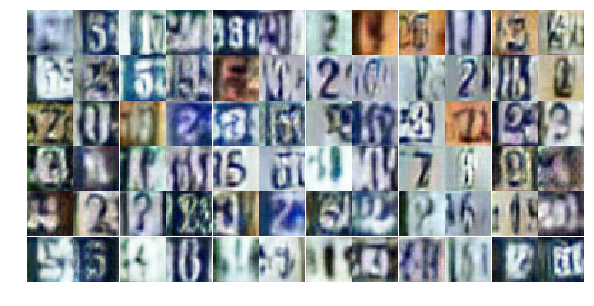

Epoch 8/25... Discriminator Loss: 0.5729... Generator Loss: 1.1416
Epoch 8/25... Discriminator Loss: 1.1932... Generator Loss: 0.4874
Epoch 8/25... Discriminator Loss: 0.5373... Generator Loss: 1.4782
Epoch 8/25... Discriminator Loss: 0.6849... Generator Loss: 1.1431
Epoch 8/25... Discriminator Loss: 1.0630... Generator Loss: 0.5828
Epoch 8/25... Discriminator Loss: 0.5439... Generator Loss: 1.2640
Epoch 8/25... Discriminator Loss: 0.7535... Generator Loss: 1.0169
Epoch 8/25... Discriminator Loss: 0.5730... Generator Loss: 1.3971
Epoch 8/25... Discriminator Loss: 0.7346... Generator Loss: 1.0125
Epoch 8/25... Discriminator Loss: 0.5566... Generator Loss: 1.3594


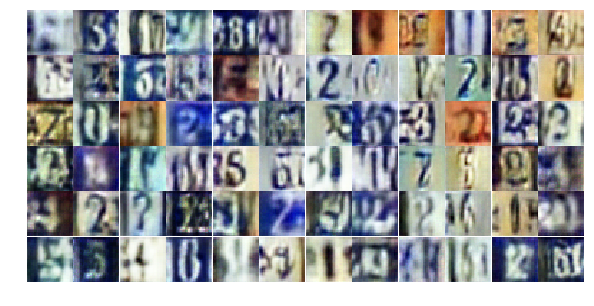

Epoch 8/25... Discriminator Loss: 0.5466... Generator Loss: 1.1948
Epoch 8/25... Discriminator Loss: 1.2671... Generator Loss: 0.4929
Epoch 8/25... Discriminator Loss: 0.3784... Generator Loss: 1.5815
Epoch 8/25... Discriminator Loss: 0.6063... Generator Loss: 1.1270
Epoch 8/25... Discriminator Loss: 2.4935... Generator Loss: 4.0431
Epoch 8/25... Discriminator Loss: 0.7654... Generator Loss: 1.1029
Epoch 8/25... Discriminator Loss: 0.4893... Generator Loss: 1.5908
Epoch 8/25... Discriminator Loss: 0.5647... Generator Loss: 1.5954
Epoch 8/25... Discriminator Loss: 0.8112... Generator Loss: 0.9337
Epoch 8/25... Discriminator Loss: 0.6966... Generator Loss: 1.1663


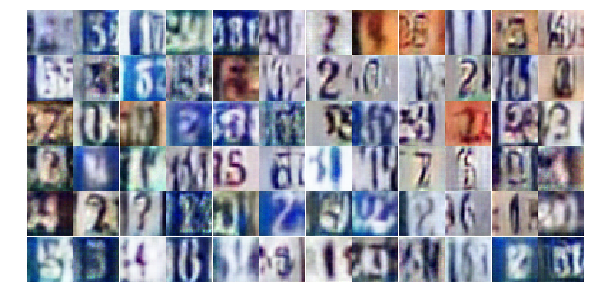

Epoch 8/25... Discriminator Loss: 0.5265... Generator Loss: 1.4014
Epoch 8/25... Discriminator Loss: 0.5129... Generator Loss: 1.4203
Epoch 8/25... Discriminator Loss: 0.6238... Generator Loss: 1.4857
Epoch 8/25... Discriminator Loss: 1.3226... Generator Loss: 0.4232
Epoch 8/25... Discriminator Loss: 0.5709... Generator Loss: 1.8430
Epoch 8/25... Discriminator Loss: 0.9794... Generator Loss: 0.9955
Epoch 8/25... Discriminator Loss: 0.4426... Generator Loss: 1.4292
Epoch 8/25... Discriminator Loss: 0.7418... Generator Loss: 1.8843
Epoch 9/25... Discriminator Loss: 0.6650... Generator Loss: 1.3304
Epoch 9/25... Discriminator Loss: 0.7491... Generator Loss: 1.0334


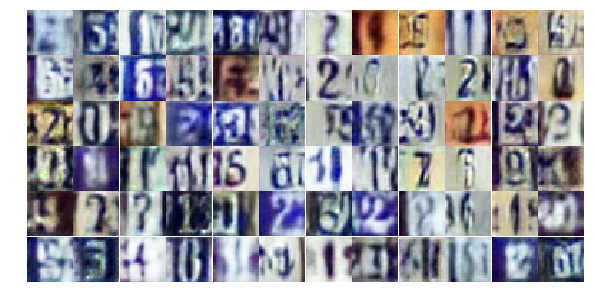

Epoch 9/25... Discriminator Loss: 0.7488... Generator Loss: 0.8449
Epoch 9/25... Discriminator Loss: 0.7161... Generator Loss: 1.0450
Epoch 9/25... Discriminator Loss: 1.1503... Generator Loss: 0.5024
Epoch 9/25... Discriminator Loss: 0.4134... Generator Loss: 1.8048
Epoch 9/25... Discriminator Loss: 1.2054... Generator Loss: 0.4726
Epoch 9/25... Discriminator Loss: 0.5081... Generator Loss: 1.6868
Epoch 9/25... Discriminator Loss: 0.7075... Generator Loss: 0.9445
Epoch 9/25... Discriminator Loss: 0.4775... Generator Loss: 1.3978
Epoch 9/25... Discriminator Loss: 0.8775... Generator Loss: 0.7340
Epoch 9/25... Discriminator Loss: 0.6069... Generator Loss: 1.3675


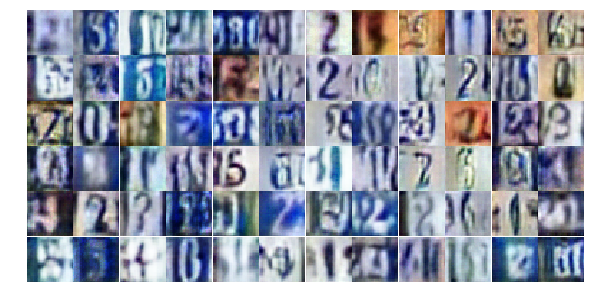

Epoch 9/25... Discriminator Loss: 0.8551... Generator Loss: 0.7269
Epoch 9/25... Discriminator Loss: 1.1231... Generator Loss: 1.9677
Epoch 9/25... Discriminator Loss: 0.8435... Generator Loss: 0.8136
Epoch 9/25... Discriminator Loss: 0.6057... Generator Loss: 1.1988
Epoch 9/25... Discriminator Loss: 0.5330... Generator Loss: 1.7455
Epoch 9/25... Discriminator Loss: 0.5930... Generator Loss: 1.7732
Epoch 9/25... Discriminator Loss: 0.7498... Generator Loss: 1.0035
Epoch 9/25... Discriminator Loss: 0.4520... Generator Loss: 1.7999
Epoch 9/25... Discriminator Loss: 0.9953... Generator Loss: 0.6202
Epoch 9/25... Discriminator Loss: 0.9932... Generator Loss: 0.6092


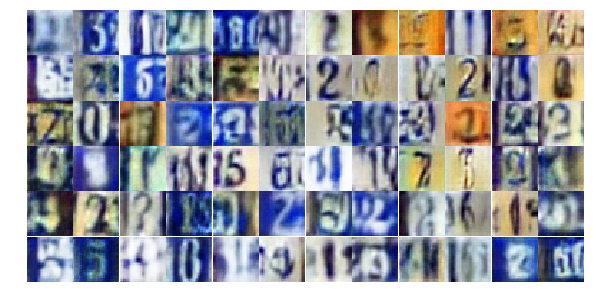

Epoch 9/25... Discriminator Loss: 1.1175... Generator Loss: 0.5532
Epoch 9/25... Discriminator Loss: 0.6750... Generator Loss: 1.0233
Epoch 9/25... Discriminator Loss: 0.5088... Generator Loss: 1.9129
Epoch 9/25... Discriminator Loss: 0.8969... Generator Loss: 1.0272
Epoch 9/25... Discriminator Loss: 0.5449... Generator Loss: 2.4582
Epoch 9/25... Discriminator Loss: 0.5662... Generator Loss: 1.3677
Epoch 9/25... Discriminator Loss: 1.4958... Generator Loss: 0.4326
Epoch 9/25... Discriminator Loss: 0.5357... Generator Loss: 1.4323
Epoch 9/25... Discriminator Loss: 0.6224... Generator Loss: 1.1323
Epoch 9/25... Discriminator Loss: 0.5752... Generator Loss: 1.0812


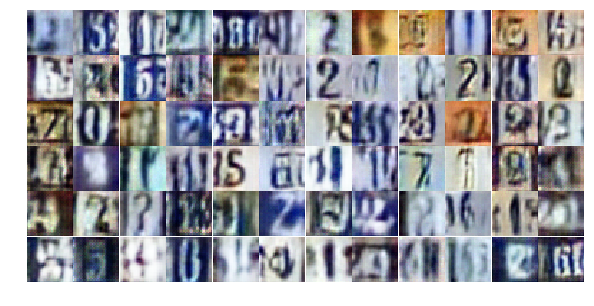

Epoch 9/25... Discriminator Loss: 0.5787... Generator Loss: 1.1978
Epoch 9/25... Discriminator Loss: 0.7416... Generator Loss: 0.9381
Epoch 9/25... Discriminator Loss: 1.1366... Generator Loss: 0.5589
Epoch 9/25... Discriminator Loss: 0.6568... Generator Loss: 0.9452
Epoch 9/25... Discriminator Loss: 0.6317... Generator Loss: 1.3680
Epoch 9/25... Discriminator Loss: 0.6611... Generator Loss: 1.1618
Epoch 9/25... Discriminator Loss: 0.7126... Generator Loss: 2.1406
Epoch 9/25... Discriminator Loss: 0.4590... Generator Loss: 1.3995
Epoch 9/25... Discriminator Loss: 0.9717... Generator Loss: 0.6625
Epoch 9/25... Discriminator Loss: 0.7298... Generator Loss: 0.8840


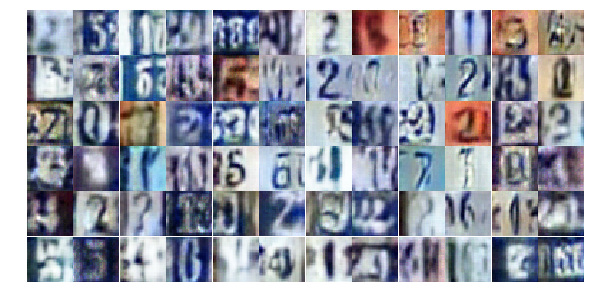

Epoch 9/25... Discriminator Loss: 0.6743... Generator Loss: 1.1974
Epoch 9/25... Discriminator Loss: 0.5296... Generator Loss: 1.5752
Epoch 9/25... Discriminator Loss: 0.8498... Generator Loss: 2.7038
Epoch 9/25... Discriminator Loss: 0.6635... Generator Loss: 1.0746
Epoch 9/25... Discriminator Loss: 0.4197... Generator Loss: 1.9710
Epoch 9/25... Discriminator Loss: 0.8634... Generator Loss: 0.8018
Epoch 9/25... Discriminator Loss: 0.6091... Generator Loss: 1.0765
Epoch 9/25... Discriminator Loss: 0.8708... Generator Loss: 0.7164
Epoch 9/25... Discriminator Loss: 0.6655... Generator Loss: 1.0113
Epoch 9/25... Discriminator Loss: 0.8012... Generator Loss: 2.6348


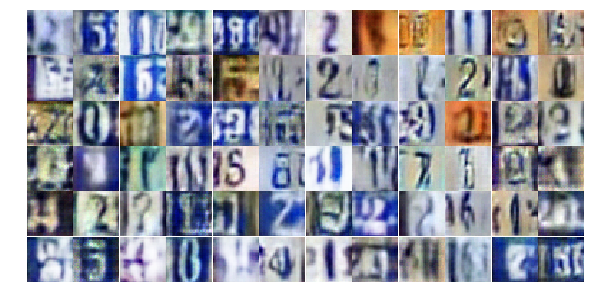

Epoch 9/25... Discriminator Loss: 3.2445... Generator Loss: 0.0725
Epoch 9/25... Discriminator Loss: 1.0527... Generator Loss: 1.9806
Epoch 9/25... Discriminator Loss: 0.6049... Generator Loss: 1.2610
Epoch 9/25... Discriminator Loss: 1.2743... Generator Loss: 0.4361
Epoch 9/25... Discriminator Loss: 0.7036... Generator Loss: 1.4240
Epoch 10/25... Discriminator Loss: 0.5850... Generator Loss: 1.6934
Epoch 10/25... Discriminator Loss: 0.6451... Generator Loss: 1.0845
Epoch 10/25... Discriminator Loss: 0.4996... Generator Loss: 1.2907
Epoch 10/25... Discriminator Loss: 0.9075... Generator Loss: 0.7283
Epoch 10/25... Discriminator Loss: 1.5166... Generator Loss: 0.3247


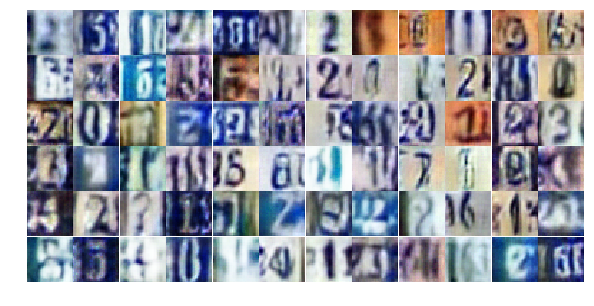

Epoch 10/25... Discriminator Loss: 0.6577... Generator Loss: 1.0667
Epoch 10/25... Discriminator Loss: 0.6299... Generator Loss: 1.0618
Epoch 10/25... Discriminator Loss: 0.5693... Generator Loss: 1.2449
Epoch 10/25... Discriminator Loss: 0.6953... Generator Loss: 1.1042
Epoch 10/25... Discriminator Loss: 0.4726... Generator Loss: 1.7678
Epoch 10/25... Discriminator Loss: 0.7744... Generator Loss: 1.0794
Epoch 10/25... Discriminator Loss: 0.4918... Generator Loss: 1.2024
Epoch 10/25... Discriminator Loss: 0.7180... Generator Loss: 0.8631
Epoch 10/25... Discriminator Loss: 1.1313... Generator Loss: 0.5902
Epoch 10/25... Discriminator Loss: 1.3080... Generator Loss: 0.5020


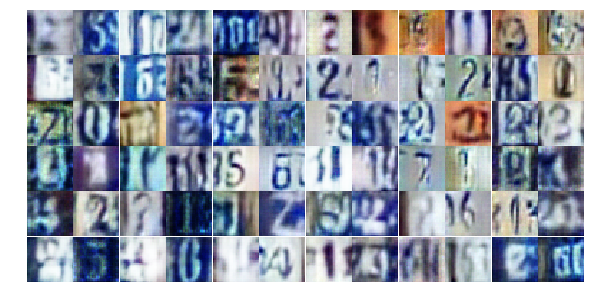

Epoch 10/25... Discriminator Loss: 2.5153... Generator Loss: 0.1360
Epoch 10/25... Discriminator Loss: 1.0054... Generator Loss: 0.7071
Epoch 10/25... Discriminator Loss: 0.7824... Generator Loss: 0.8958
Epoch 10/25... Discriminator Loss: 1.0615... Generator Loss: 0.5842
Epoch 10/25... Discriminator Loss: 0.7352... Generator Loss: 1.3018
Epoch 10/25... Discriminator Loss: 0.4914... Generator Loss: 1.5843
Epoch 10/25... Discriminator Loss: 0.7594... Generator Loss: 0.9781
Epoch 10/25... Discriminator Loss: 0.5227... Generator Loss: 1.3280
Epoch 10/25... Discriminator Loss: 0.6102... Generator Loss: 1.2573
Epoch 10/25... Discriminator Loss: 0.4259... Generator Loss: 1.9490


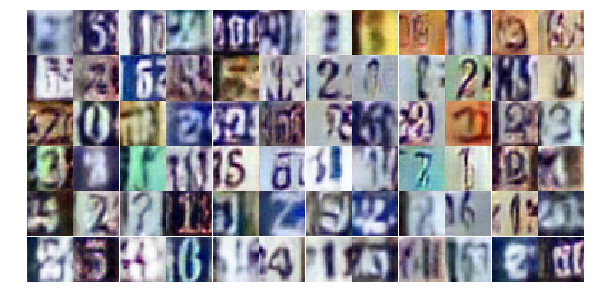

Epoch 10/25... Discriminator Loss: 1.1596... Generator Loss: 0.4835
Epoch 10/25... Discriminator Loss: 0.8100... Generator Loss: 0.8701
Epoch 10/25... Discriminator Loss: 0.4406... Generator Loss: 1.6324
Epoch 10/25... Discriminator Loss: 0.3611... Generator Loss: 2.2129
Epoch 10/25... Discriminator Loss: 1.3179... Generator Loss: 0.4098
Epoch 10/25... Discriminator Loss: 0.6004... Generator Loss: 1.1714
Epoch 10/25... Discriminator Loss: 0.3583... Generator Loss: 1.8275
Epoch 10/25... Discriminator Loss: 0.6646... Generator Loss: 1.1340
Epoch 10/25... Discriminator Loss: 0.6465... Generator Loss: 1.0395
Epoch 10/25... Discriminator Loss: 0.9111... Generator Loss: 0.6962


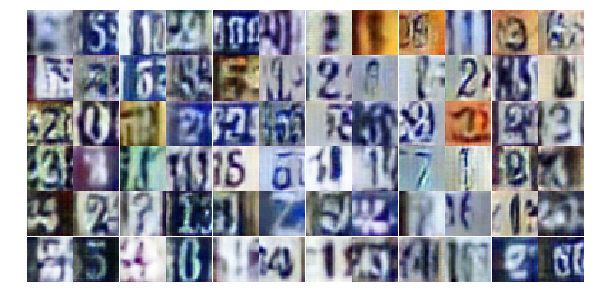

Epoch 10/25... Discriminator Loss: 0.5949... Generator Loss: 1.6832
Epoch 10/25... Discriminator Loss: 0.8254... Generator Loss: 1.0614
Epoch 10/25... Discriminator Loss: 0.5744... Generator Loss: 1.2268
Epoch 10/25... Discriminator Loss: 0.4949... Generator Loss: 2.1422
Epoch 10/25... Discriminator Loss: 0.5521... Generator Loss: 1.2885
Epoch 10/25... Discriminator Loss: 0.6971... Generator Loss: 1.0385
Epoch 10/25... Discriminator Loss: 0.8647... Generator Loss: 0.7205
Epoch 10/25... Discriminator Loss: 1.2364... Generator Loss: 0.5072
Epoch 10/25... Discriminator Loss: 0.6350... Generator Loss: 1.1391
Epoch 10/25... Discriminator Loss: 0.9520... Generator Loss: 0.8828


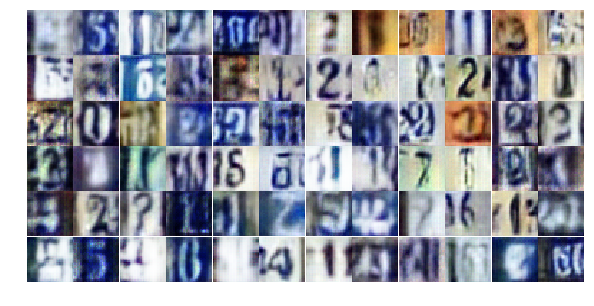

Epoch 10/25... Discriminator Loss: 1.5159... Generator Loss: 0.3894
Epoch 10/25... Discriminator Loss: 0.6180... Generator Loss: 1.3314
Epoch 10/25... Discriminator Loss: 1.0325... Generator Loss: 0.6103
Epoch 10/25... Discriminator Loss: 0.7813... Generator Loss: 0.9440
Epoch 10/25... Discriminator Loss: 0.4658... Generator Loss: 1.6667
Epoch 10/25... Discriminator Loss: 0.7237... Generator Loss: 0.8894
Epoch 10/25... Discriminator Loss: 0.6473... Generator Loss: 1.1450
Epoch 10/25... Discriminator Loss: 0.5294... Generator Loss: 1.2749
Epoch 10/25... Discriminator Loss: 0.2754... Generator Loss: 2.5059
Epoch 10/25... Discriminator Loss: 0.5138... Generator Loss: 1.6447


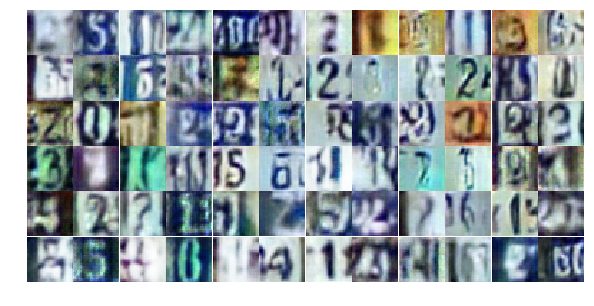

Epoch 10/25... Discriminator Loss: 1.1005... Generator Loss: 1.6652
Epoch 10/25... Discriminator Loss: 0.5956... Generator Loss: 1.0579
Epoch 10/25... Discriminator Loss: 0.4111... Generator Loss: 1.5513
Epoch 11/25... Discriminator Loss: 0.9240... Generator Loss: 0.7604
Epoch 11/25... Discriminator Loss: 0.5444... Generator Loss: 1.4418
Epoch 11/25... Discriminator Loss: 1.0645... Generator Loss: 0.5712
Epoch 11/25... Discriminator Loss: 0.6300... Generator Loss: 1.1747
Epoch 11/25... Discriminator Loss: 0.6715... Generator Loss: 1.5118
Epoch 11/25... Discriminator Loss: 1.1945... Generator Loss: 1.2327
Epoch 11/25... Discriminator Loss: 1.1734... Generator Loss: 0.7647


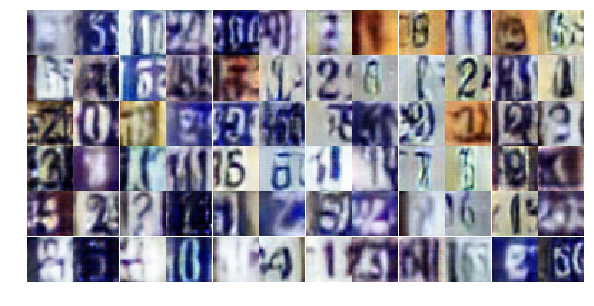

Epoch 11/25... Discriminator Loss: 0.7215... Generator Loss: 1.1511
Epoch 11/25... Discriminator Loss: 0.8526... Generator Loss: 0.8256
Epoch 11/25... Discriminator Loss: 0.5601... Generator Loss: 1.1765
Epoch 11/25... Discriminator Loss: 0.7287... Generator Loss: 1.0121
Epoch 11/25... Discriminator Loss: 0.8405... Generator Loss: 0.8112
Epoch 11/25... Discriminator Loss: 0.3440... Generator Loss: 1.7854
Epoch 11/25... Discriminator Loss: 0.6354... Generator Loss: 1.1294
Epoch 11/25... Discriminator Loss: 0.2757... Generator Loss: 2.1487
Epoch 11/25... Discriminator Loss: 0.9306... Generator Loss: 0.6629
Epoch 11/25... Discriminator Loss: 1.9710... Generator Loss: 0.2270


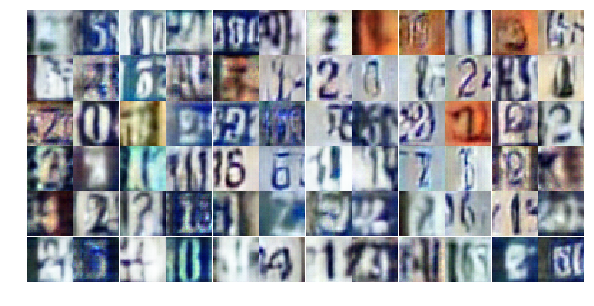

Epoch 11/25... Discriminator Loss: 0.8559... Generator Loss: 0.9848
Epoch 11/25... Discriminator Loss: 0.4504... Generator Loss: 2.2516
Epoch 11/25... Discriminator Loss: 0.6363... Generator Loss: 1.0398
Epoch 11/25... Discriminator Loss: 0.6623... Generator Loss: 1.0813
Epoch 11/25... Discriminator Loss: 0.4199... Generator Loss: 1.6889
Epoch 11/25... Discriminator Loss: 0.3329... Generator Loss: 2.0897
Epoch 11/25... Discriminator Loss: 0.4842... Generator Loss: 1.4544
Epoch 11/25... Discriminator Loss: 0.9013... Generator Loss: 1.3737
Epoch 11/25... Discriminator Loss: 0.5238... Generator Loss: 1.2757
Epoch 11/25... Discriminator Loss: 1.0304... Generator Loss: 0.6257


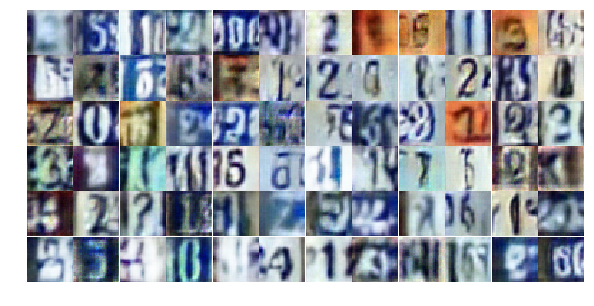

Epoch 11/25... Discriminator Loss: 0.6144... Generator Loss: 1.7214
Epoch 11/25... Discriminator Loss: 0.6596... Generator Loss: 1.2118
Epoch 11/25... Discriminator Loss: 0.9293... Generator Loss: 0.8746
Epoch 11/25... Discriminator Loss: 0.5176... Generator Loss: 1.3331
Epoch 11/25... Discriminator Loss: 1.1204... Generator Loss: 0.5432
Epoch 11/25... Discriminator Loss: 1.3406... Generator Loss: 0.4167
Epoch 11/25... Discriminator Loss: 0.9313... Generator Loss: 0.8651
Epoch 11/25... Discriminator Loss: 1.0347... Generator Loss: 0.5978
Epoch 11/25... Discriminator Loss: 0.5808... Generator Loss: 1.6300
Epoch 11/25... Discriminator Loss: 0.9490... Generator Loss: 0.6435


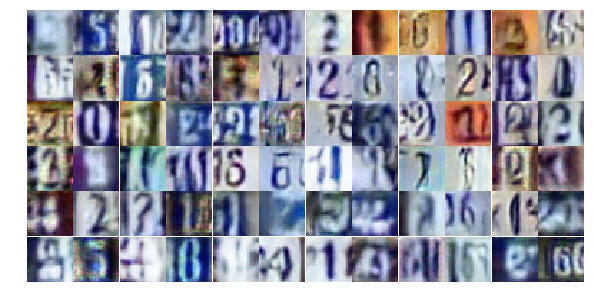

Epoch 11/25... Discriminator Loss: 0.3857... Generator Loss: 1.6602
Epoch 11/25... Discriminator Loss: 0.4361... Generator Loss: 1.4961
Epoch 11/25... Discriminator Loss: 0.7383... Generator Loss: 1.0165
Epoch 11/25... Discriminator Loss: 0.8814... Generator Loss: 0.8151
Epoch 11/25... Discriminator Loss: 0.8415... Generator Loss: 0.8110
Epoch 11/25... Discriminator Loss: 0.5869... Generator Loss: 1.2991
Epoch 11/25... Discriminator Loss: 0.3080... Generator Loss: 2.4308
Epoch 11/25... Discriminator Loss: 0.6872... Generator Loss: 1.1940
Epoch 11/25... Discriminator Loss: 1.5800... Generator Loss: 0.3479
Epoch 11/25... Discriminator Loss: 0.6919... Generator Loss: 1.2483


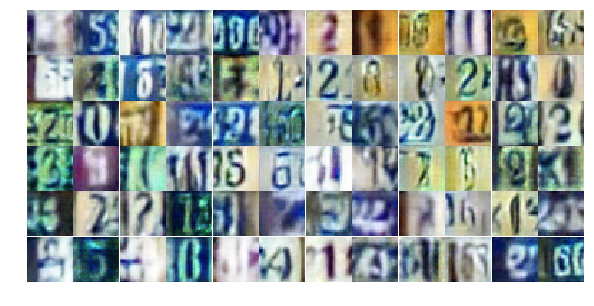

Epoch 11/25... Discriminator Loss: 0.8285... Generator Loss: 0.8275
Epoch 11/25... Discriminator Loss: 0.5087... Generator Loss: 1.6043
Epoch 11/25... Discriminator Loss: 0.6780... Generator Loss: 1.1776
Epoch 11/25... Discriminator Loss: 0.6802... Generator Loss: 1.2099
Epoch 11/25... Discriminator Loss: 1.6503... Generator Loss: 0.3339
Epoch 11/25... Discriminator Loss: 1.1102... Generator Loss: 1.8619
Epoch 11/25... Discriminator Loss: 1.1126... Generator Loss: 0.5930
Epoch 11/25... Discriminator Loss: 0.6328... Generator Loss: 1.2967
Epoch 11/25... Discriminator Loss: 0.7512... Generator Loss: 1.0889
Epoch 11/25... Discriminator Loss: 0.7259... Generator Loss: 1.0636


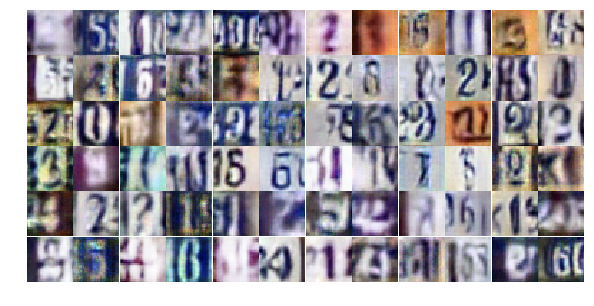

Epoch 12/25... Discriminator Loss: 0.7191... Generator Loss: 0.9727
Epoch 12/25... Discriminator Loss: 0.7329... Generator Loss: 0.9685
Epoch 12/25... Discriminator Loss: 0.8811... Generator Loss: 0.7785
Epoch 12/25... Discriminator Loss: 0.4562... Generator Loss: 1.5156
Epoch 12/25... Discriminator Loss: 0.4812... Generator Loss: 1.3963
Epoch 12/25... Discriminator Loss: 0.8551... Generator Loss: 0.7915
Epoch 12/25... Discriminator Loss: 0.5948... Generator Loss: 1.3270
Epoch 12/25... Discriminator Loss: 0.5168... Generator Loss: 1.5786
Epoch 12/25... Discriminator Loss: 0.6945... Generator Loss: 1.4223
Epoch 12/25... Discriminator Loss: 0.9594... Generator Loss: 0.7256


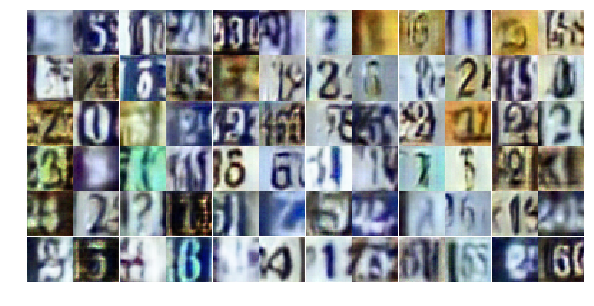

Epoch 12/25... Discriminator Loss: 0.5904... Generator Loss: 1.0652
Epoch 12/25... Discriminator Loss: 0.8371... Generator Loss: 0.7724
Epoch 12/25... Discriminator Loss: 0.5301... Generator Loss: 1.6037
Epoch 12/25... Discriminator Loss: 0.6770... Generator Loss: 2.0031
Epoch 12/25... Discriminator Loss: 0.4024... Generator Loss: 2.1618
Epoch 12/25... Discriminator Loss: 0.8779... Generator Loss: 1.1784
Epoch 12/25... Discriminator Loss: 1.5760... Generator Loss: 0.3470
Epoch 12/25... Discriminator Loss: 0.6407... Generator Loss: 2.1309
Epoch 12/25... Discriminator Loss: 0.6629... Generator Loss: 1.0213
Epoch 12/25... Discriminator Loss: 0.9448... Generator Loss: 0.6918


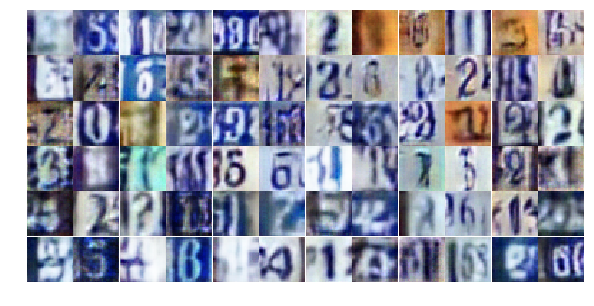

Epoch 12/25... Discriminator Loss: 0.3953... Generator Loss: 1.4646
Epoch 12/25... Discriminator Loss: 0.4699... Generator Loss: 1.5070
Epoch 12/25... Discriminator Loss: 0.6706... Generator Loss: 1.0901
Epoch 12/25... Discriminator Loss: 0.4218... Generator Loss: 1.7534
Epoch 12/25... Discriminator Loss: 0.4958... Generator Loss: 1.3758
Epoch 12/25... Discriminator Loss: 0.5346... Generator Loss: 1.6667
Epoch 12/25... Discriminator Loss: 0.5858... Generator Loss: 1.2815
Epoch 12/25... Discriminator Loss: 0.3984... Generator Loss: 1.7744
Epoch 12/25... Discriminator Loss: 0.5468... Generator Loss: 1.3117
Epoch 12/25... Discriminator Loss: 0.7370... Generator Loss: 0.9305


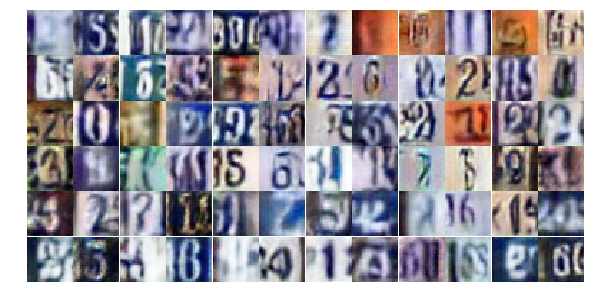

Epoch 12/25... Discriminator Loss: 0.6326... Generator Loss: 1.0688
Epoch 12/25... Discriminator Loss: 0.8332... Generator Loss: 0.9713
Epoch 12/25... Discriminator Loss: 0.9160... Generator Loss: 0.7060
Epoch 12/25... Discriminator Loss: 1.7753... Generator Loss: 0.2543
Epoch 12/25... Discriminator Loss: 0.7018... Generator Loss: 1.9660
Epoch 12/25... Discriminator Loss: 1.0200... Generator Loss: 0.6180
Epoch 12/25... Discriminator Loss: 0.6168... Generator Loss: 1.0890
Epoch 12/25... Discriminator Loss: 0.7996... Generator Loss: 0.9131
Epoch 12/25... Discriminator Loss: 0.6226... Generator Loss: 1.2636
Epoch 12/25... Discriminator Loss: 0.3402... Generator Loss: 1.7959


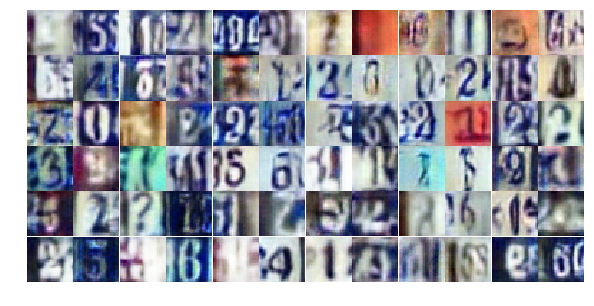

Epoch 12/25... Discriminator Loss: 0.5511... Generator Loss: 1.5446
Epoch 12/25... Discriminator Loss: 0.4790... Generator Loss: 1.2746
Epoch 12/25... Discriminator Loss: 0.4049... Generator Loss: 1.4758
Epoch 12/25... Discriminator Loss: 0.9750... Generator Loss: 0.7214
Epoch 12/25... Discriminator Loss: 1.0574... Generator Loss: 0.6606
Epoch 12/25... Discriminator Loss: 0.9317... Generator Loss: 0.6960
Epoch 12/25... Discriminator Loss: 0.8306... Generator Loss: 0.8902
Epoch 12/25... Discriminator Loss: 0.7410... Generator Loss: 1.1953
Epoch 12/25... Discriminator Loss: 0.9142... Generator Loss: 0.7236
Epoch 12/25... Discriminator Loss: 0.6536... Generator Loss: 0.9778


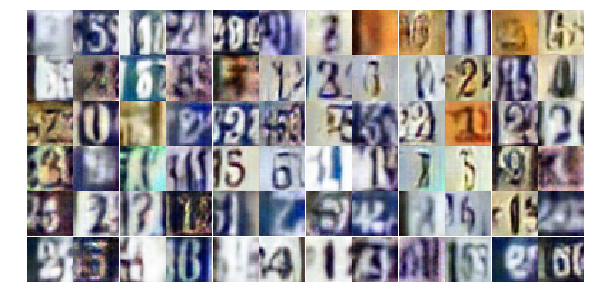

Epoch 12/25... Discriminator Loss: 1.0505... Generator Loss: 0.6087
Epoch 12/25... Discriminator Loss: 0.4218... Generator Loss: 1.5080
Epoch 12/25... Discriminator Loss: 0.5555... Generator Loss: 1.6662
Epoch 12/25... Discriminator Loss: 2.0963... Generator Loss: 0.2295
Epoch 12/25... Discriminator Loss: 0.8546... Generator Loss: 0.8516
Epoch 12/25... Discriminator Loss: 0.6785... Generator Loss: 1.7507
Epoch 12/25... Discriminator Loss: 0.7438... Generator Loss: 0.9646
Epoch 13/25... Discriminator Loss: 0.4437... Generator Loss: 1.6629
Epoch 13/25... Discriminator Loss: 0.4407... Generator Loss: 1.4319
Epoch 13/25... Discriminator Loss: 0.8474... Generator Loss: 0.7766


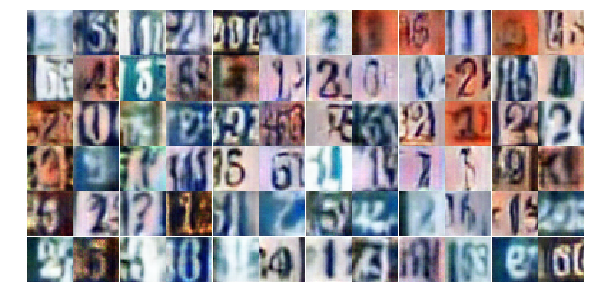

Epoch 13/25... Discriminator Loss: 0.7574... Generator Loss: 0.8964
Epoch 13/25... Discriminator Loss: 0.5253... Generator Loss: 1.9867
Epoch 13/25... Discriminator Loss: 0.9271... Generator Loss: 1.0657
Epoch 13/25... Discriminator Loss: 0.8792... Generator Loss: 0.7874
Epoch 13/25... Discriminator Loss: 0.6253... Generator Loss: 1.2328
Epoch 13/25... Discriminator Loss: 0.5374... Generator Loss: 1.4513
Epoch 13/25... Discriminator Loss: 0.4607... Generator Loss: 1.6743
Epoch 13/25... Discriminator Loss: 0.8597... Generator Loss: 0.7514
Epoch 13/25... Discriminator Loss: 0.5405... Generator Loss: 1.1678
Epoch 13/25... Discriminator Loss: 0.6033... Generator Loss: 1.3338


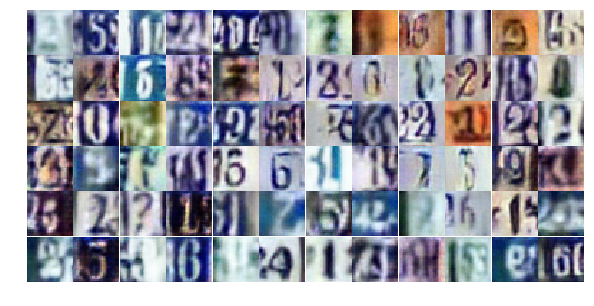

Epoch 13/25... Discriminator Loss: 0.7821... Generator Loss: 2.1411
Epoch 13/25... Discriminator Loss: 0.6208... Generator Loss: 1.0873
Epoch 13/25... Discriminator Loss: 1.1102... Generator Loss: 0.6075
Epoch 13/25... Discriminator Loss: 0.9663... Generator Loss: 0.6836
Epoch 13/25... Discriminator Loss: 0.6093... Generator Loss: 1.6051
Epoch 13/25... Discriminator Loss: 0.8482... Generator Loss: 1.2622
Epoch 13/25... Discriminator Loss: 0.5660... Generator Loss: 1.3776
Epoch 13/25... Discriminator Loss: 0.8538... Generator Loss: 0.8331
Epoch 13/25... Discriminator Loss: 0.6195... Generator Loss: 1.1820
Epoch 13/25... Discriminator Loss: 1.3529... Generator Loss: 0.4110


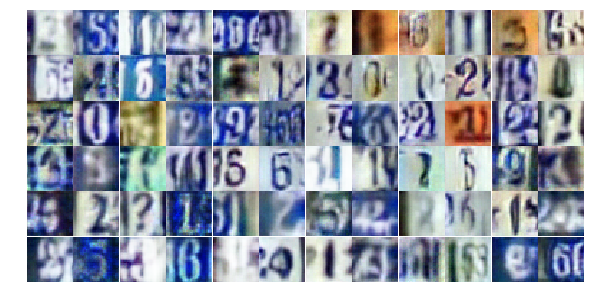

Epoch 13/25... Discriminator Loss: 0.8474... Generator Loss: 0.8650
Epoch 13/25... Discriminator Loss: 0.4779... Generator Loss: 1.4709
Epoch 13/25... Discriminator Loss: 0.6016... Generator Loss: 1.3676
Epoch 13/25... Discriminator Loss: 0.7293... Generator Loss: 1.0302
Epoch 13/25... Discriminator Loss: 0.7435... Generator Loss: 0.9419
Epoch 13/25... Discriminator Loss: 0.7945... Generator Loss: 0.8677
Epoch 13/25... Discriminator Loss: 0.8026... Generator Loss: 1.5588
Epoch 13/25... Discriminator Loss: 0.5273... Generator Loss: 1.4665
Epoch 13/25... Discriminator Loss: 0.9767... Generator Loss: 0.6555
Epoch 13/25... Discriminator Loss: 0.5961... Generator Loss: 1.1877


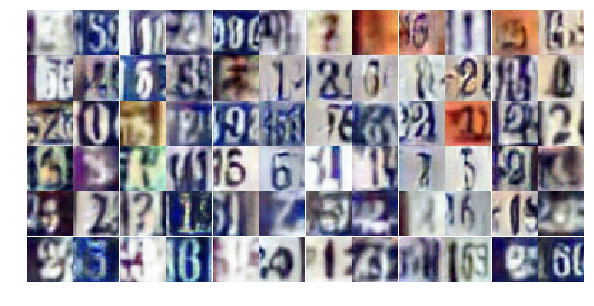

Epoch 13/25... Discriminator Loss: 1.1235... Generator Loss: 0.5186
Epoch 13/25... Discriminator Loss: 0.8896... Generator Loss: 1.7067
Epoch 13/25... Discriminator Loss: 0.8485... Generator Loss: 0.8054
Epoch 13/25... Discriminator Loss: 1.0640... Generator Loss: 0.5856
Epoch 13/25... Discriminator Loss: 0.7088... Generator Loss: 0.9756
Epoch 13/25... Discriminator Loss: 0.4804... Generator Loss: 1.7443
Epoch 13/25... Discriminator Loss: 0.4763... Generator Loss: 1.3882
Epoch 13/25... Discriminator Loss: 0.8481... Generator Loss: 0.8776
Epoch 13/25... Discriminator Loss: 0.6167... Generator Loss: 1.2259
Epoch 13/25... Discriminator Loss: 1.0620... Generator Loss: 0.6079


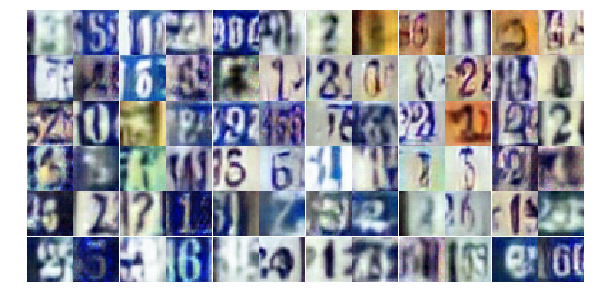

Epoch 13/25... Discriminator Loss: 0.5355... Generator Loss: 1.2994
Epoch 13/25... Discriminator Loss: 1.0276... Generator Loss: 1.2818
Epoch 13/25... Discriminator Loss: 0.8693... Generator Loss: 0.7610
Epoch 13/25... Discriminator Loss: 0.5662... Generator Loss: 1.9230
Epoch 13/25... Discriminator Loss: 1.0017... Generator Loss: 0.6586
Epoch 13/25... Discriminator Loss: 0.9790... Generator Loss: 0.7082
Epoch 13/25... Discriminator Loss: 0.5476... Generator Loss: 1.2316
Epoch 13/25... Discriminator Loss: 0.6956... Generator Loss: 1.0021
Epoch 13/25... Discriminator Loss: 0.7043... Generator Loss: 0.9337
Epoch 13/25... Discriminator Loss: 0.7776... Generator Loss: 0.8521


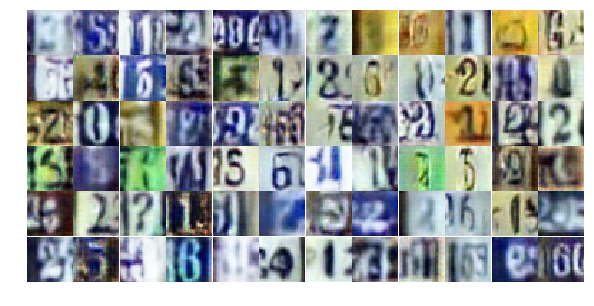

Epoch 13/25... Discriminator Loss: 0.4668... Generator Loss: 1.9669
Epoch 13/25... Discriminator Loss: 1.2895... Generator Loss: 0.4426
Epoch 13/25... Discriminator Loss: 0.6706... Generator Loss: 1.1518
Epoch 13/25... Discriminator Loss: 0.8463... Generator Loss: 0.7453
Epoch 14/25... Discriminator Loss: 1.2254... Generator Loss: 0.5147
Epoch 14/25... Discriminator Loss: 0.6018... Generator Loss: 1.3219
Epoch 14/25... Discriminator Loss: 0.7992... Generator Loss: 0.9084
Epoch 14/25... Discriminator Loss: 0.7634... Generator Loss: 2.0568
Epoch 14/25... Discriminator Loss: 0.8352... Generator Loss: 0.8293
Epoch 14/25... Discriminator Loss: 0.6402... Generator Loss: 1.0863


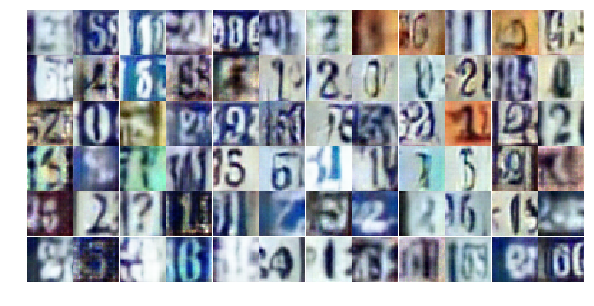

Epoch 14/25... Discriminator Loss: 0.7700... Generator Loss: 1.8916
Epoch 14/25... Discriminator Loss: 0.9249... Generator Loss: 0.7783
Epoch 14/25... Discriminator Loss: 0.6275... Generator Loss: 1.1364
Epoch 14/25... Discriminator Loss: 0.9088... Generator Loss: 0.7036
Epoch 14/25... Discriminator Loss: 0.9647... Generator Loss: 0.6900
Epoch 14/25... Discriminator Loss: 0.3016... Generator Loss: 1.9191
Epoch 14/25... Discriminator Loss: 0.5232... Generator Loss: 1.9117
Epoch 14/25... Discriminator Loss: 1.6220... Generator Loss: 0.3036
Epoch 14/25... Discriminator Loss: 1.4448... Generator Loss: 0.3882
Epoch 14/25... Discriminator Loss: 1.5279... Generator Loss: 0.3873


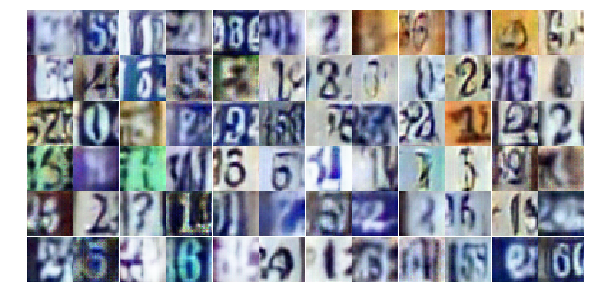

Epoch 14/25... Discriminator Loss: 0.4689... Generator Loss: 1.3376
Epoch 14/25... Discriminator Loss: 0.6208... Generator Loss: 2.5624
Epoch 14/25... Discriminator Loss: 1.2707... Generator Loss: 0.5219
Epoch 14/25... Discriminator Loss: 0.6047... Generator Loss: 1.1482
Epoch 14/25... Discriminator Loss: 0.8092... Generator Loss: 0.8745
Epoch 14/25... Discriminator Loss: 0.7981... Generator Loss: 0.8550
Epoch 14/25... Discriminator Loss: 0.6665... Generator Loss: 1.1160
Epoch 14/25... Discriminator Loss: 0.5840... Generator Loss: 1.1724
Epoch 14/25... Discriminator Loss: 0.5784... Generator Loss: 1.2550
Epoch 14/25... Discriminator Loss: 0.4376... Generator Loss: 1.2334


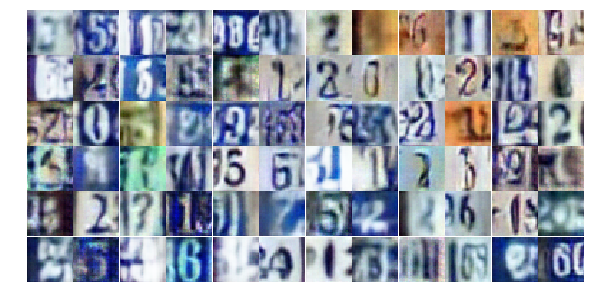

Epoch 14/25... Discriminator Loss: 1.1174... Generator Loss: 0.6285
Epoch 14/25... Discriminator Loss: 0.5334... Generator Loss: 1.2720
Epoch 14/25... Discriminator Loss: 0.4682... Generator Loss: 1.5641
Epoch 14/25... Discriminator Loss: 0.4883... Generator Loss: 1.3005
Epoch 14/25... Discriminator Loss: 0.6331... Generator Loss: 1.1336
Epoch 14/25... Discriminator Loss: 0.6456... Generator Loss: 1.1473
Epoch 14/25... Discriminator Loss: 0.6211... Generator Loss: 1.1218
Epoch 14/25... Discriminator Loss: 0.3225... Generator Loss: 1.9300
Epoch 14/25... Discriminator Loss: 0.3725... Generator Loss: 2.6756
Epoch 14/25... Discriminator Loss: 0.8258... Generator Loss: 1.0100


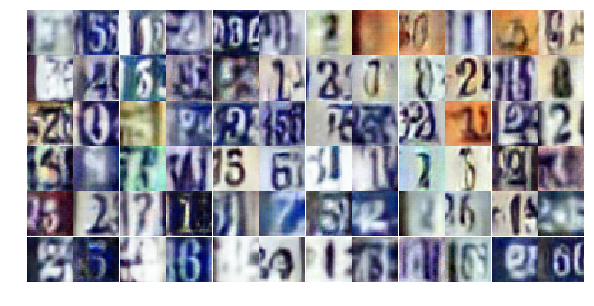

Epoch 14/25... Discriminator Loss: 1.2029... Generator Loss: 0.5025
Epoch 14/25... Discriminator Loss: 0.7563... Generator Loss: 1.1534
Epoch 14/25... Discriminator Loss: 0.9176... Generator Loss: 0.7326
Epoch 14/25... Discriminator Loss: 0.6879... Generator Loss: 1.0046
Epoch 14/25... Discriminator Loss: 1.2269... Generator Loss: 0.4658
Epoch 14/25... Discriminator Loss: 0.5345... Generator Loss: 1.2135
Epoch 14/25... Discriminator Loss: 0.6435... Generator Loss: 1.0808
Epoch 14/25... Discriminator Loss: 0.4648... Generator Loss: 1.4421
Epoch 14/25... Discriminator Loss: 4.7334... Generator Loss: 5.6393
Epoch 14/25... Discriminator Loss: 2.0957... Generator Loss: 0.2326


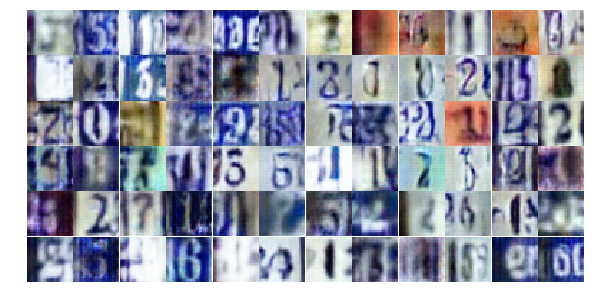

Epoch 14/25... Discriminator Loss: 0.8552... Generator Loss: 1.6022
Epoch 14/25... Discriminator Loss: 1.2391... Generator Loss: 0.4972
Epoch 14/25... Discriminator Loss: 0.6445... Generator Loss: 1.1698
Epoch 14/25... Discriminator Loss: 0.8505... Generator Loss: 0.9067
Epoch 14/25... Discriminator Loss: 0.7091... Generator Loss: 1.0237
Epoch 14/25... Discriminator Loss: 0.7476... Generator Loss: 0.9255
Epoch 14/25... Discriminator Loss: 0.8691... Generator Loss: 1.0380
Epoch 14/25... Discriminator Loss: 0.8329... Generator Loss: 0.8293
Epoch 14/25... Discriminator Loss: 1.2469... Generator Loss: 0.5029
Epoch 14/25... Discriminator Loss: 1.0526... Generator Loss: 0.6314


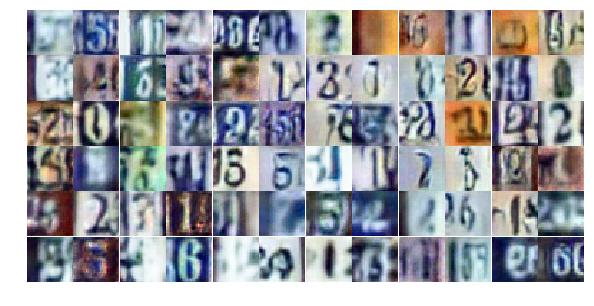

Epoch 14/25... Discriminator Loss: 0.9760... Generator Loss: 0.7267
Epoch 14/25... Discriminator Loss: 1.2824... Generator Loss: 0.4582
Epoch 15/25... Discriminator Loss: 0.6182... Generator Loss: 1.0944
Epoch 15/25... Discriminator Loss: 0.4128... Generator Loss: 1.6329
Epoch 15/25... Discriminator Loss: 0.6064... Generator Loss: 1.1882
Epoch 15/25... Discriminator Loss: 1.1451... Generator Loss: 0.5329
Epoch 15/25... Discriminator Loss: 0.8890... Generator Loss: 0.6960
Epoch 15/25... Discriminator Loss: 0.5868... Generator Loss: 1.1252
Epoch 15/25... Discriminator Loss: 1.1081... Generator Loss: 0.5575
Epoch 15/25... Discriminator Loss: 0.5874... Generator Loss: 1.1236


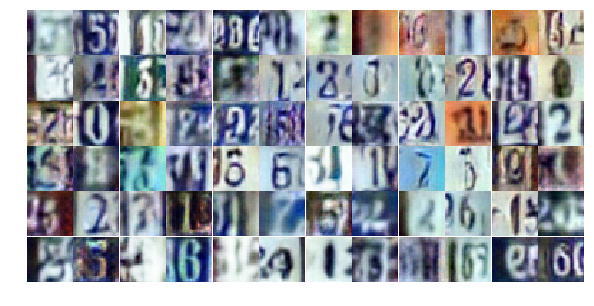

Epoch 15/25... Discriminator Loss: 0.7903... Generator Loss: 0.9074
Epoch 15/25... Discriminator Loss: 0.6904... Generator Loss: 2.2475
Epoch 15/25... Discriminator Loss: 0.9813... Generator Loss: 0.7312
Epoch 15/25... Discriminator Loss: 0.5307... Generator Loss: 1.4013
Epoch 15/25... Discriminator Loss: 0.7858... Generator Loss: 0.8987
Epoch 15/25... Discriminator Loss: 0.4191... Generator Loss: 1.6924
Epoch 15/25... Discriminator Loss: 0.8102... Generator Loss: 0.9140
Epoch 15/25... Discriminator Loss: 0.6234... Generator Loss: 1.1693
Epoch 15/25... Discriminator Loss: 0.8060... Generator Loss: 3.2026
Epoch 15/25... Discriminator Loss: 1.9222... Generator Loss: 0.2378


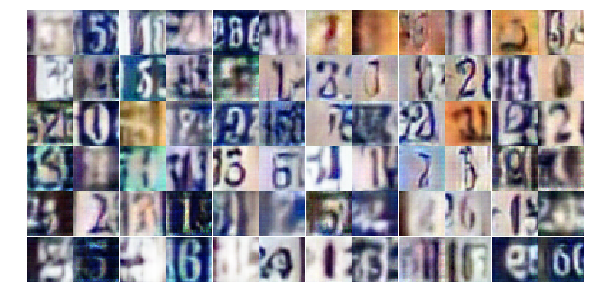

Epoch 15/25... Discriminator Loss: 1.5826... Generator Loss: 0.4132
Epoch 15/25... Discriminator Loss: 0.6099... Generator Loss: 1.3216
Epoch 15/25... Discriminator Loss: 0.5605... Generator Loss: 1.4095
Epoch 15/25... Discriminator Loss: 1.0379... Generator Loss: 0.6322
Epoch 15/25... Discriminator Loss: 1.1487... Generator Loss: 0.5482
Epoch 15/25... Discriminator Loss: 0.7407... Generator Loss: 1.1186
Epoch 15/25... Discriminator Loss: 0.8079... Generator Loss: 0.8764
Epoch 15/25... Discriminator Loss: 0.7521... Generator Loss: 0.9234
Epoch 15/25... Discriminator Loss: 0.6798... Generator Loss: 0.9681
Epoch 15/25... Discriminator Loss: 1.4076... Generator Loss: 0.4055


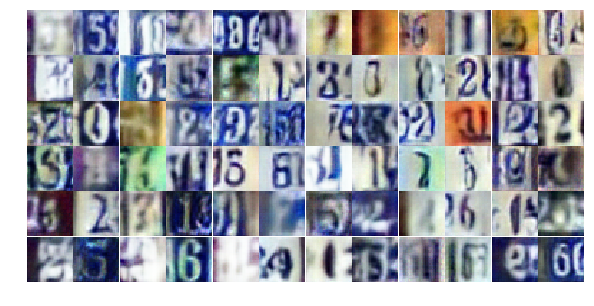

Epoch 15/25... Discriminator Loss: 0.7364... Generator Loss: 0.9303
Epoch 15/25... Discriminator Loss: 0.7128... Generator Loss: 0.9715
Epoch 15/25... Discriminator Loss: 0.4792... Generator Loss: 1.3516
Epoch 15/25... Discriminator Loss: 0.6662... Generator Loss: 1.0446
Epoch 15/25... Discriminator Loss: 0.6073... Generator Loss: 1.1011
Epoch 15/25... Discriminator Loss: 0.5949... Generator Loss: 1.3686
Epoch 15/25... Discriminator Loss: 0.5379... Generator Loss: 1.5292
Epoch 15/25... Discriminator Loss: 0.6546... Generator Loss: 1.6154
Epoch 15/25... Discriminator Loss: 0.5569... Generator Loss: 1.3000
Epoch 15/25... Discriminator Loss: 0.6414... Generator Loss: 1.0356


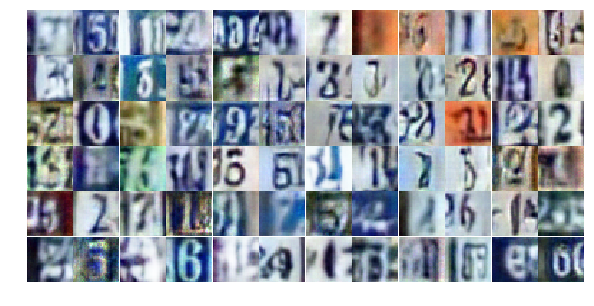

Epoch 15/25... Discriminator Loss: 0.8884... Generator Loss: 0.7795
Epoch 15/25... Discriminator Loss: 1.3323... Generator Loss: 0.3836
Epoch 15/25... Discriminator Loss: 0.7626... Generator Loss: 0.9886
Epoch 15/25... Discriminator Loss: 0.4532... Generator Loss: 1.4978
Epoch 15/25... Discriminator Loss: 0.4312... Generator Loss: 1.5939
Epoch 15/25... Discriminator Loss: 1.4450... Generator Loss: 0.4504
Epoch 15/25... Discriminator Loss: 0.5157... Generator Loss: 1.3547
Epoch 15/25... Discriminator Loss: 0.7711... Generator Loss: 0.9263
Epoch 15/25... Discriminator Loss: 0.6356... Generator Loss: 1.0697
Epoch 15/25... Discriminator Loss: 0.9123... Generator Loss: 0.8701


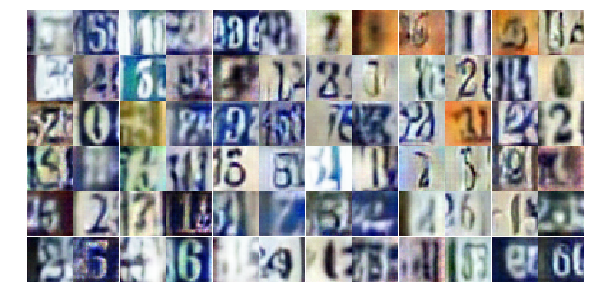

Epoch 15/25... Discriminator Loss: 1.2135... Generator Loss: 0.4997
Epoch 15/25... Discriminator Loss: 0.7502... Generator Loss: 1.0142
Epoch 15/25... Discriminator Loss: 0.5314... Generator Loss: 1.1711
Epoch 15/25... Discriminator Loss: 1.7933... Generator Loss: 0.2423
Epoch 15/25... Discriminator Loss: 0.9771... Generator Loss: 0.7433
Epoch 15/25... Discriminator Loss: 0.9733... Generator Loss: 0.6759
Epoch 15/25... Discriminator Loss: 0.8292... Generator Loss: 0.8381
Epoch 15/25... Discriminator Loss: 0.5773... Generator Loss: 1.3469
Epoch 15/25... Discriminator Loss: 1.3825... Generator Loss: 0.3964
Epoch 16/25... Discriminator Loss: 0.9681... Generator Loss: 0.6603


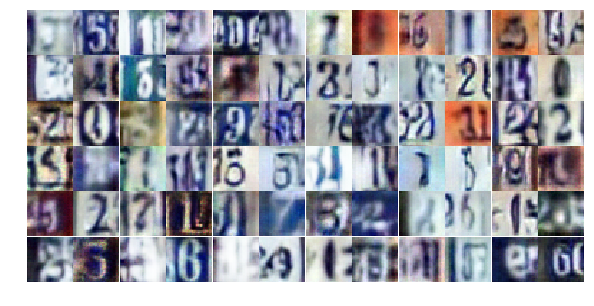

Epoch 16/25... Discriminator Loss: 0.7098... Generator Loss: 1.0703
Epoch 16/25... Discriminator Loss: 0.7295... Generator Loss: 1.0161
Epoch 16/25... Discriminator Loss: 0.9569... Generator Loss: 0.6956
Epoch 16/25... Discriminator Loss: 0.7548... Generator Loss: 0.9403
Epoch 16/25... Discriminator Loss: 0.4558... Generator Loss: 1.9653
Epoch 16/25... Discriminator Loss: 0.7751... Generator Loss: 1.2852
Epoch 16/25... Discriminator Loss: 1.6809... Generator Loss: 0.2890
Epoch 16/25... Discriminator Loss: 0.8895... Generator Loss: 0.7889
Epoch 16/25... Discriminator Loss: 0.4737... Generator Loss: 1.4991
Epoch 16/25... Discriminator Loss: 0.5849... Generator Loss: 1.1473


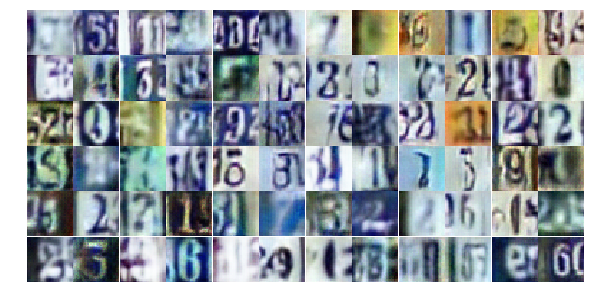

Epoch 16/25... Discriminator Loss: 1.0998... Generator Loss: 0.5903
Epoch 16/25... Discriminator Loss: 0.6227... Generator Loss: 1.1381
Epoch 16/25... Discriminator Loss: 0.7878... Generator Loss: 0.8891
Epoch 16/25... Discriminator Loss: 1.4344... Generator Loss: 0.3993
Epoch 16/25... Discriminator Loss: 0.4016... Generator Loss: 1.7774
Epoch 16/25... Discriminator Loss: 0.5583... Generator Loss: 1.3810
Epoch 16/25... Discriminator Loss: 1.4319... Generator Loss: 0.4473
Epoch 16/25... Discriminator Loss: 0.4298... Generator Loss: 1.6376
Epoch 16/25... Discriminator Loss: 0.5272... Generator Loss: 1.3268
Epoch 16/25... Discriminator Loss: 0.8162... Generator Loss: 0.8037


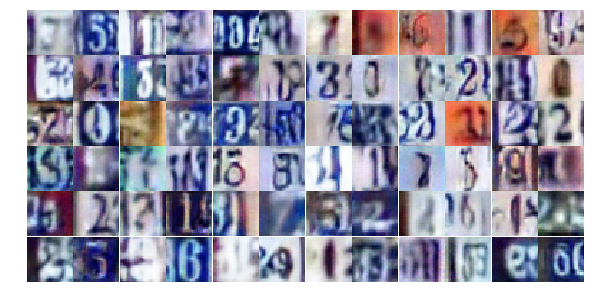

Epoch 16/25... Discriminator Loss: 0.6293... Generator Loss: 1.5955
Epoch 16/25... Discriminator Loss: 0.5458... Generator Loss: 1.6783
Epoch 16/25... Discriminator Loss: 0.8150... Generator Loss: 0.7993
Epoch 16/25... Discriminator Loss: 1.2936... Generator Loss: 0.4085
Epoch 16/25... Discriminator Loss: 0.5974... Generator Loss: 1.1630
Epoch 16/25... Discriminator Loss: 0.6675... Generator Loss: 1.1145
Epoch 16/25... Discriminator Loss: 0.7361... Generator Loss: 0.9134
Epoch 16/25... Discriminator Loss: 0.4919... Generator Loss: 1.4168
Epoch 16/25... Discriminator Loss: 0.9124... Generator Loss: 0.8485
Epoch 16/25... Discriminator Loss: 0.6887... Generator Loss: 0.9501


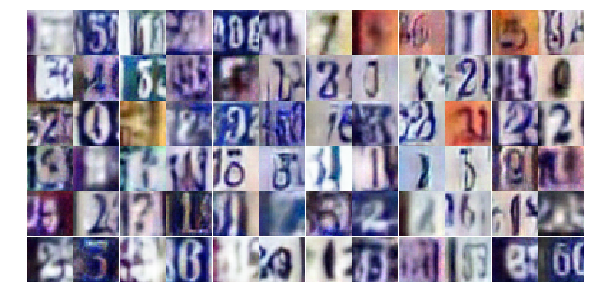

Epoch 16/25... Discriminator Loss: 0.7172... Generator Loss: 1.0170
Epoch 16/25... Discriminator Loss: 0.6049... Generator Loss: 1.1630
Epoch 16/25... Discriminator Loss: 0.6353... Generator Loss: 1.0206
Epoch 16/25... Discriminator Loss: 0.6736... Generator Loss: 1.4076
Epoch 16/25... Discriminator Loss: 1.3978... Generator Loss: 0.4034
Epoch 16/25... Discriminator Loss: 0.6178... Generator Loss: 1.2131
Epoch 16/25... Discriminator Loss: 0.7850... Generator Loss: 0.9416
Epoch 16/25... Discriminator Loss: 1.2681... Generator Loss: 0.5204
Epoch 16/25... Discriminator Loss: 0.9809... Generator Loss: 0.6859
Epoch 16/25... Discriminator Loss: 0.6482... Generator Loss: 1.1749


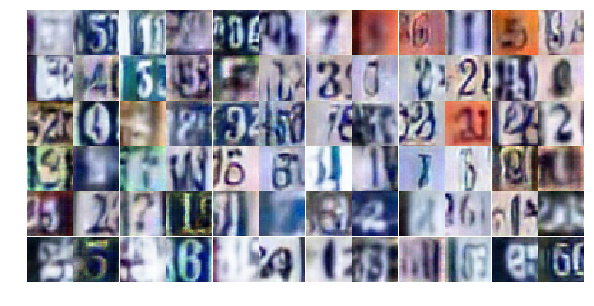

Epoch 16/25... Discriminator Loss: 0.5187... Generator Loss: 1.4003
Epoch 16/25... Discriminator Loss: 0.5455... Generator Loss: 1.5250
Epoch 16/25... Discriminator Loss: 1.0409... Generator Loss: 0.6634
Epoch 16/25... Discriminator Loss: 1.0130... Generator Loss: 0.6652
Epoch 16/25... Discriminator Loss: 0.5783... Generator Loss: 1.2590
Epoch 16/25... Discriminator Loss: 0.9920... Generator Loss: 0.7614
Epoch 16/25... Discriminator Loss: 0.4065... Generator Loss: 1.6612
Epoch 16/25... Discriminator Loss: 0.8015... Generator Loss: 0.9441
Epoch 16/25... Discriminator Loss: 0.6083... Generator Loss: 1.0447
Epoch 16/25... Discriminator Loss: 1.2511... Generator Loss: 0.5029


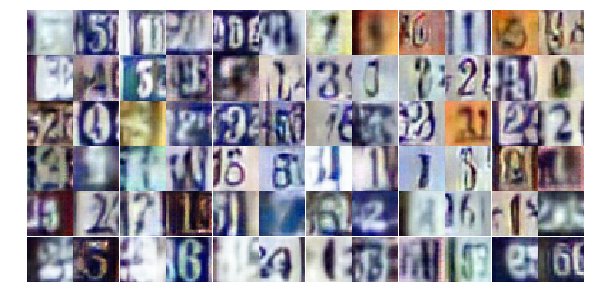

Epoch 16/25... Discriminator Loss: 1.2771... Generator Loss: 0.5278
Epoch 16/25... Discriminator Loss: 2.0843... Generator Loss: 4.1275
Epoch 16/25... Discriminator Loss: 2.1441... Generator Loss: 0.2544
Epoch 16/25... Discriminator Loss: 0.6467... Generator Loss: 1.1402
Epoch 16/25... Discriminator Loss: 0.8756... Generator Loss: 0.7461
Epoch 16/25... Discriminator Loss: 0.6404... Generator Loss: 1.1645
Epoch 17/25... Discriminator Loss: 0.7247... Generator Loss: 0.9874
Epoch 17/25... Discriminator Loss: 0.7440... Generator Loss: 0.9461
Epoch 17/25... Discriminator Loss: 0.7305... Generator Loss: 0.9533
Epoch 17/25... Discriminator Loss: 0.7884... Generator Loss: 0.9571


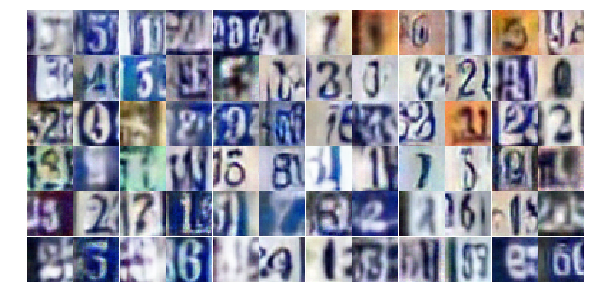

Epoch 17/25... Discriminator Loss: 0.5383... Generator Loss: 1.3112
Epoch 17/25... Discriminator Loss: 0.7376... Generator Loss: 0.8647
Epoch 17/25... Discriminator Loss: 0.9140... Generator Loss: 0.7673
Epoch 17/25... Discriminator Loss: 0.7148... Generator Loss: 0.9297
Epoch 17/25... Discriminator Loss: 1.1285... Generator Loss: 0.5849
Epoch 17/25... Discriminator Loss: 0.8588... Generator Loss: 0.8634
Epoch 17/25... Discriminator Loss: 0.7791... Generator Loss: 0.9569
Epoch 17/25... Discriminator Loss: 0.4871... Generator Loss: 1.3874
Epoch 17/25... Discriminator Loss: 0.3205... Generator Loss: 1.8546
Epoch 17/25... Discriminator Loss: 0.5486... Generator Loss: 1.3712


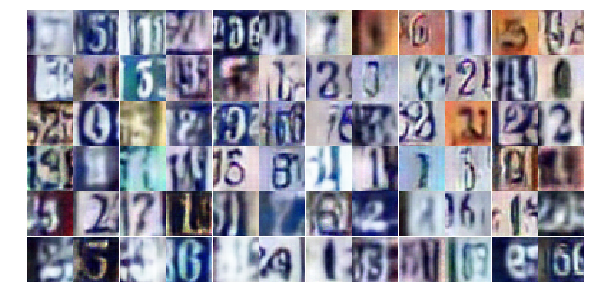

Epoch 17/25... Discriminator Loss: 0.8744... Generator Loss: 0.8085
Epoch 17/25... Discriminator Loss: 0.7738... Generator Loss: 0.9661
Epoch 17/25... Discriminator Loss: 0.7050... Generator Loss: 0.9703
Epoch 17/25... Discriminator Loss: 0.5573... Generator Loss: 1.4531
Epoch 17/25... Discriminator Loss: 0.4182... Generator Loss: 1.6056
Epoch 17/25... Discriminator Loss: 0.8859... Generator Loss: 0.7599
Epoch 17/25... Discriminator Loss: 0.5230... Generator Loss: 1.9974
Epoch 17/25... Discriminator Loss: 0.5767... Generator Loss: 1.3332
Epoch 17/25... Discriminator Loss: 0.6974... Generator Loss: 1.0154
Epoch 17/25... Discriminator Loss: 0.5794... Generator Loss: 1.2868


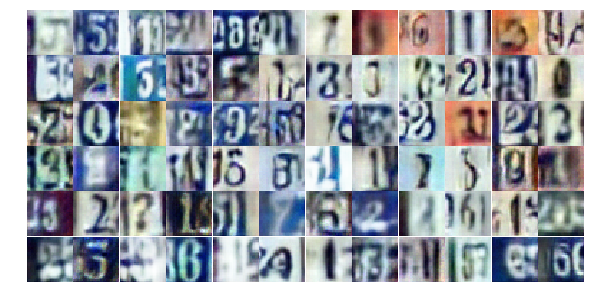

Epoch 17/25... Discriminator Loss: 1.4626... Generator Loss: 0.4068
Epoch 17/25... Discriminator Loss: 0.4848... Generator Loss: 1.4568
Epoch 17/25... Discriminator Loss: 0.4469... Generator Loss: 1.4776
Epoch 17/25... Discriminator Loss: 0.7289... Generator Loss: 1.0590
Epoch 17/25... Discriminator Loss: 1.6899... Generator Loss: 0.2666
Epoch 17/25... Discriminator Loss: 0.3740... Generator Loss: 1.6737
Epoch 17/25... Discriminator Loss: 0.6042... Generator Loss: 1.2259
Epoch 17/25... Discriminator Loss: 1.0359... Generator Loss: 0.6154
Epoch 17/25... Discriminator Loss: 1.0801... Generator Loss: 0.6614
Epoch 17/25... Discriminator Loss: 0.4729... Generator Loss: 1.4834


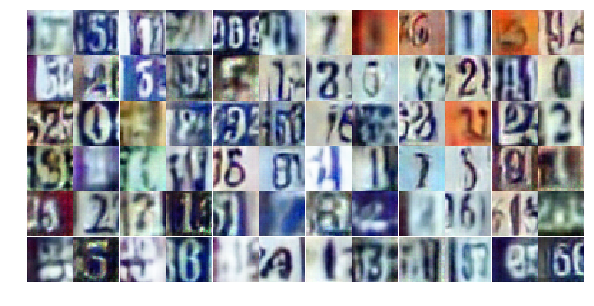

Epoch 17/25... Discriminator Loss: 0.5592... Generator Loss: 1.5436
Epoch 17/25... Discriminator Loss: 1.0551... Generator Loss: 0.5901
Epoch 17/25... Discriminator Loss: 0.5734... Generator Loss: 1.5816
Epoch 17/25... Discriminator Loss: 0.7235... Generator Loss: 1.0636
Epoch 17/25... Discriminator Loss: 1.2947... Generator Loss: 0.5005
Epoch 17/25... Discriminator Loss: 0.5216... Generator Loss: 1.2475
Epoch 17/25... Discriminator Loss: 1.0503... Generator Loss: 0.6424
Epoch 17/25... Discriminator Loss: 0.4986... Generator Loss: 1.4321
Epoch 17/25... Discriminator Loss: 0.3389... Generator Loss: 1.8013
Epoch 17/25... Discriminator Loss: 0.8590... Generator Loss: 0.7822


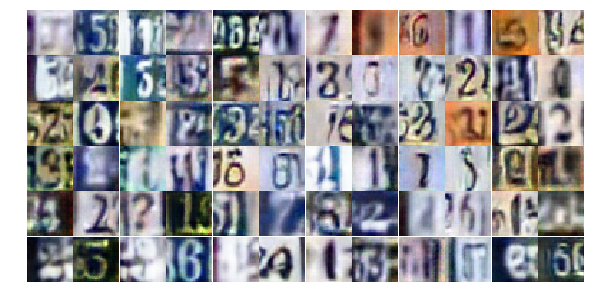

Epoch 17/25... Discriminator Loss: 0.8705... Generator Loss: 1.1099
Epoch 17/25... Discriminator Loss: 0.3434... Generator Loss: 1.8104
Epoch 17/25... Discriminator Loss: 0.7816... Generator Loss: 1.0444
Epoch 17/25... Discriminator Loss: 0.3695... Generator Loss: 1.8913
Epoch 17/25... Discriminator Loss: 0.7164... Generator Loss: 1.0093
Epoch 17/25... Discriminator Loss: 0.6766... Generator Loss: 1.2948
Epoch 17/25... Discriminator Loss: 1.2918... Generator Loss: 0.4635
Epoch 17/25... Discriminator Loss: 0.6635... Generator Loss: 1.0594
Epoch 17/25... Discriminator Loss: 0.6714... Generator Loss: 1.1163
Epoch 17/25... Discriminator Loss: 1.9432... Generator Loss: 0.2196


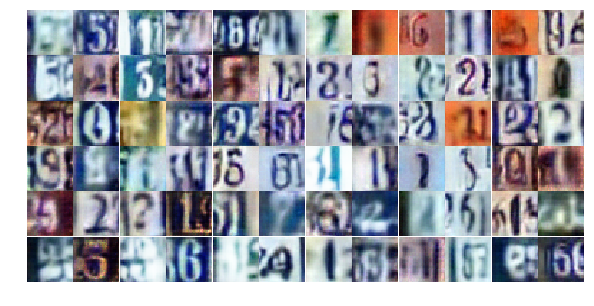

Epoch 17/25... Discriminator Loss: 1.4197... Generator Loss: 0.4182
Epoch 17/25... Discriminator Loss: 1.0716... Generator Loss: 2.3847
Epoch 17/25... Discriminator Loss: 0.7862... Generator Loss: 1.0138
Epoch 17/25... Discriminator Loss: 0.7713... Generator Loss: 2.4329
Epoch 18/25... Discriminator Loss: 0.7579... Generator Loss: 0.9329
Epoch 18/25... Discriminator Loss: 0.7413... Generator Loss: 0.9425
Epoch 18/25... Discriminator Loss: 0.9197... Generator Loss: 0.7744
Epoch 18/25... Discriminator Loss: 0.7125... Generator Loss: 0.9400
Epoch 18/25... Discriminator Loss: 1.3655... Generator Loss: 0.4247
Epoch 18/25... Discriminator Loss: 0.9562... Generator Loss: 0.6851


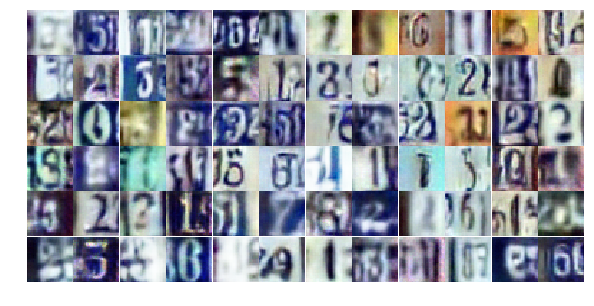

Epoch 18/25... Discriminator Loss: 0.4961... Generator Loss: 2.1981
Epoch 18/25... Discriminator Loss: 1.1057... Generator Loss: 0.5564
Epoch 18/25... Discriminator Loss: 0.9053... Generator Loss: 0.7088
Epoch 18/25... Discriminator Loss: 0.5083... Generator Loss: 1.7899
Epoch 18/25... Discriminator Loss: 0.6889... Generator Loss: 1.1094
Epoch 18/25... Discriminator Loss: 0.8492... Generator Loss: 0.8032
Epoch 18/25... Discriminator Loss: 0.5798... Generator Loss: 1.1171
Epoch 18/25... Discriminator Loss: 0.6063... Generator Loss: 1.1065
Epoch 18/25... Discriminator Loss: 0.9886... Generator Loss: 0.6211
Epoch 18/25... Discriminator Loss: 0.3374... Generator Loss: 1.7278


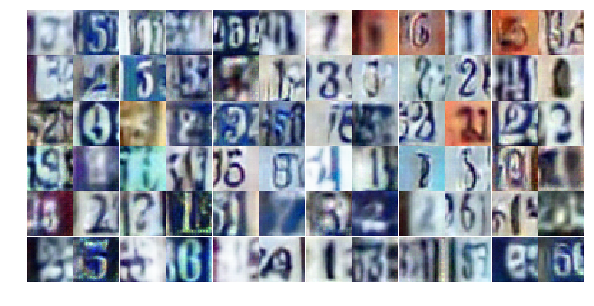

Epoch 18/25... Discriminator Loss: 1.4055... Generator Loss: 0.5441
Epoch 18/25... Discriminator Loss: 0.6859... Generator Loss: 2.0418
Epoch 18/25... Discriminator Loss: 1.4434... Generator Loss: 1.4046
Epoch 18/25... Discriminator Loss: 0.6157... Generator Loss: 1.1753
Epoch 18/25... Discriminator Loss: 0.6715... Generator Loss: 1.0408
Epoch 18/25... Discriminator Loss: 1.0560... Generator Loss: 0.6415
Epoch 18/25... Discriminator Loss: 0.8316... Generator Loss: 0.9597
Epoch 18/25... Discriminator Loss: 0.7697... Generator Loss: 0.9193
Epoch 18/25... Discriminator Loss: 0.8054... Generator Loss: 0.8888
Epoch 18/25... Discriminator Loss: 0.5602... Generator Loss: 1.3841


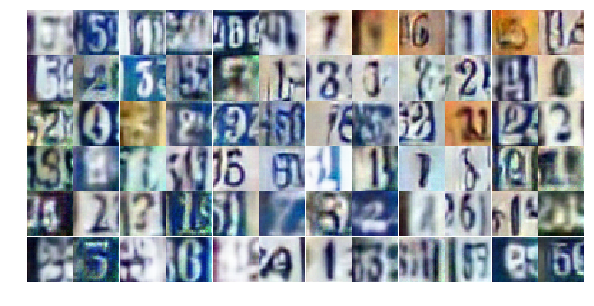

Epoch 18/25... Discriminator Loss: 0.4292... Generator Loss: 1.8797
Epoch 18/25... Discriminator Loss: 0.8630... Generator Loss: 0.9833
Epoch 18/25... Discriminator Loss: 0.7628... Generator Loss: 0.8883
Epoch 18/25... Discriminator Loss: 0.5731... Generator Loss: 1.2286
Epoch 18/25... Discriminator Loss: 0.9870... Generator Loss: 0.6373
Epoch 18/25... Discriminator Loss: 0.5635... Generator Loss: 1.4170
Epoch 18/25... Discriminator Loss: 0.5771... Generator Loss: 1.2508
Epoch 18/25... Discriminator Loss: 0.4361... Generator Loss: 1.8130
Epoch 18/25... Discriminator Loss: 0.5502... Generator Loss: 1.2619
Epoch 18/25... Discriminator Loss: 0.6554... Generator Loss: 1.1443


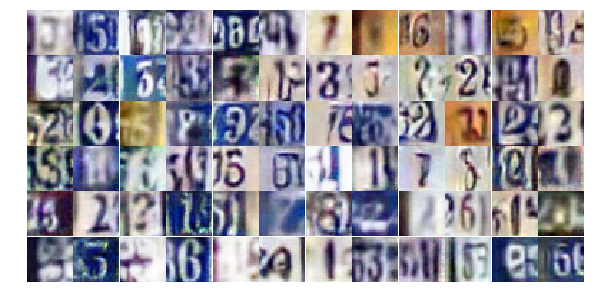

Epoch 18/25... Discriminator Loss: 0.5759... Generator Loss: 1.3642
Epoch 18/25... Discriminator Loss: 0.7590... Generator Loss: 0.8831
Epoch 18/25... Discriminator Loss: 0.7063... Generator Loss: 0.9001
Epoch 18/25... Discriminator Loss: 0.7009... Generator Loss: 1.0164
Epoch 18/25... Discriminator Loss: 1.1048... Generator Loss: 0.6527
Epoch 18/25... Discriminator Loss: 0.5728... Generator Loss: 1.1197
Epoch 18/25... Discriminator Loss: 1.1808... Generator Loss: 0.5609
Epoch 18/25... Discriminator Loss: 2.1628... Generator Loss: 3.8091
Epoch 18/25... Discriminator Loss: 1.8235... Generator Loss: 0.3052
Epoch 18/25... Discriminator Loss: 0.5027... Generator Loss: 1.3982


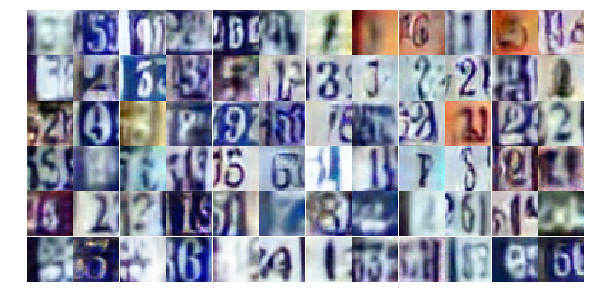

Epoch 18/25... Discriminator Loss: 0.6872... Generator Loss: 0.9852
Epoch 18/25... Discriminator Loss: 1.1726... Generator Loss: 0.5491
Epoch 18/25... Discriminator Loss: 0.8064... Generator Loss: 1.6822
Epoch 18/25... Discriminator Loss: 0.7882... Generator Loss: 1.0272
Epoch 18/25... Discriminator Loss: 0.7784... Generator Loss: 0.8718
Epoch 18/25... Discriminator Loss: 0.7860... Generator Loss: 0.8528
Epoch 18/25... Discriminator Loss: 0.6677... Generator Loss: 1.0732
Epoch 18/25... Discriminator Loss: 0.5434... Generator Loss: 1.6192
Epoch 18/25... Discriminator Loss: 0.8259... Generator Loss: 0.9332
Epoch 18/25... Discriminator Loss: 1.2428... Generator Loss: 0.4871


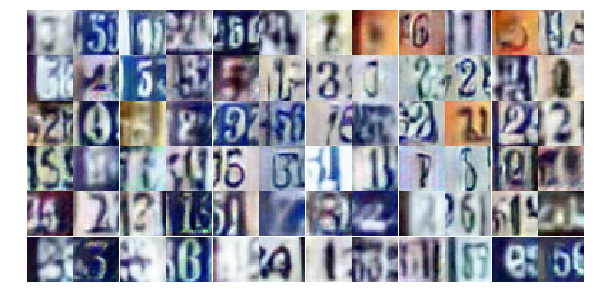

Epoch 18/25... Discriminator Loss: 0.7229... Generator Loss: 2.7267
Epoch 19/25... Discriminator Loss: 1.1446... Generator Loss: 0.5424
Epoch 19/25... Discriminator Loss: 0.9604... Generator Loss: 0.7114
Epoch 19/25... Discriminator Loss: 0.8578... Generator Loss: 0.8234
Epoch 19/25... Discriminator Loss: 0.4347... Generator Loss: 1.8354
Epoch 19/25... Discriminator Loss: 0.8676... Generator Loss: 0.7743
Epoch 19/25... Discriminator Loss: 0.6352... Generator Loss: 1.1360
Epoch 19/25... Discriminator Loss: 0.9220... Generator Loss: 0.7498
Epoch 19/25... Discriminator Loss: 0.6332... Generator Loss: 1.7983
Epoch 19/25... Discriminator Loss: 0.9321... Generator Loss: 0.7484


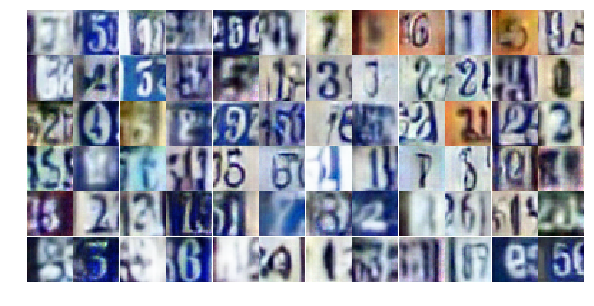

Epoch 19/25... Discriminator Loss: 0.6744... Generator Loss: 0.9774
Epoch 19/25... Discriminator Loss: 0.8664... Generator Loss: 0.7919
Epoch 19/25... Discriminator Loss: 1.0362... Generator Loss: 0.6539
Epoch 19/25... Discriminator Loss: 0.8300... Generator Loss: 0.9839
Epoch 19/25... Discriminator Loss: 1.7205... Generator Loss: 0.2773
Epoch 19/25... Discriminator Loss: 0.6433... Generator Loss: 1.2188
Epoch 19/25... Discriminator Loss: 0.9603... Generator Loss: 0.7169
Epoch 19/25... Discriminator Loss: 0.8804... Generator Loss: 0.7999
Epoch 19/25... Discriminator Loss: 3.6597... Generator Loss: 0.0825
Epoch 19/25... Discriminator Loss: 1.7445... Generator Loss: 0.3810


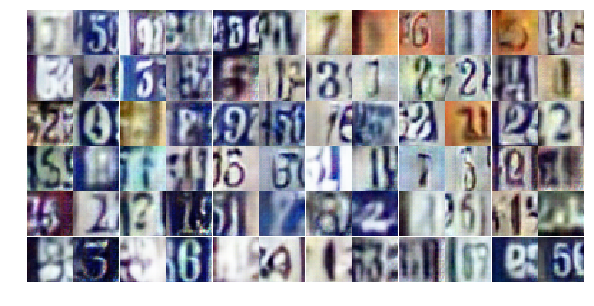

Epoch 19/25... Discriminator Loss: 0.7489... Generator Loss: 0.9982
Epoch 19/25... Discriminator Loss: 1.0833... Generator Loss: 0.8028
Epoch 19/25... Discriminator Loss: 1.3474... Generator Loss: 0.5451
Epoch 19/25... Discriminator Loss: 0.8347... Generator Loss: 0.8682
Epoch 19/25... Discriminator Loss: 1.2432... Generator Loss: 0.5088
Epoch 19/25... Discriminator Loss: 0.7422... Generator Loss: 1.1620
Epoch 19/25... Discriminator Loss: 0.5431... Generator Loss: 1.2990
Epoch 19/25... Discriminator Loss: 0.7122... Generator Loss: 0.9676
Epoch 19/25... Discriminator Loss: 0.6442... Generator Loss: 1.1081
Epoch 19/25... Discriminator Loss: 0.8539... Generator Loss: 0.9903


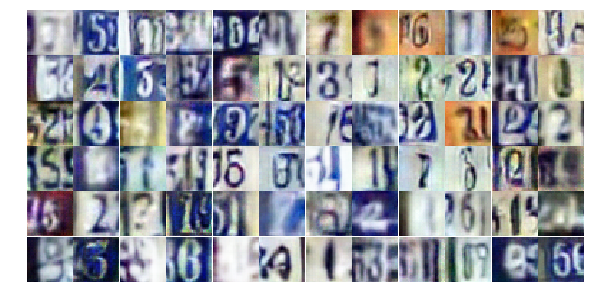

Epoch 19/25... Discriminator Loss: 0.7380... Generator Loss: 0.9291
Epoch 19/25... Discriminator Loss: 0.9181... Generator Loss: 0.7159
Epoch 19/25... Discriminator Loss: 1.0687... Generator Loss: 0.6118
Epoch 19/25... Discriminator Loss: 0.7084... Generator Loss: 0.8937
Epoch 19/25... Discriminator Loss: 0.4786... Generator Loss: 1.4869
Epoch 19/25... Discriminator Loss: 0.9165... Generator Loss: 0.7309
Epoch 19/25... Discriminator Loss: 0.9642... Generator Loss: 0.7540
Epoch 19/25... Discriminator Loss: 0.4956... Generator Loss: 1.6087
Epoch 19/25... Discriminator Loss: 0.7107... Generator Loss: 0.9781
Epoch 19/25... Discriminator Loss: 0.4402... Generator Loss: 1.8080


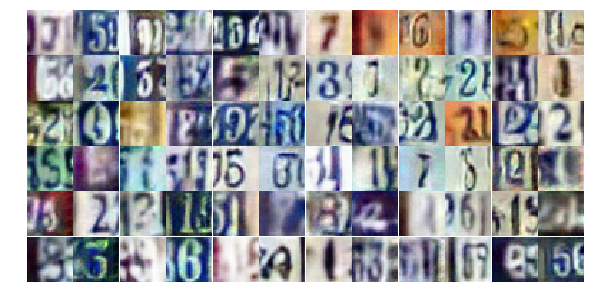

Epoch 19/25... Discriminator Loss: 0.7151... Generator Loss: 0.8671
Epoch 19/25... Discriminator Loss: 0.6750... Generator Loss: 1.0251
Epoch 19/25... Discriminator Loss: 0.8209... Generator Loss: 0.8170
Epoch 19/25... Discriminator Loss: 0.6267... Generator Loss: 1.1167
Epoch 19/25... Discriminator Loss: 0.9475... Generator Loss: 0.7168
Epoch 19/25... Discriminator Loss: 0.7450... Generator Loss: 1.0678
Epoch 19/25... Discriminator Loss: 0.8755... Generator Loss: 0.7500
Epoch 19/25... Discriminator Loss: 0.5361... Generator Loss: 1.2928
Epoch 19/25... Discriminator Loss: 0.7333... Generator Loss: 1.0461
Epoch 19/25... Discriminator Loss: 0.6912... Generator Loss: 1.0196


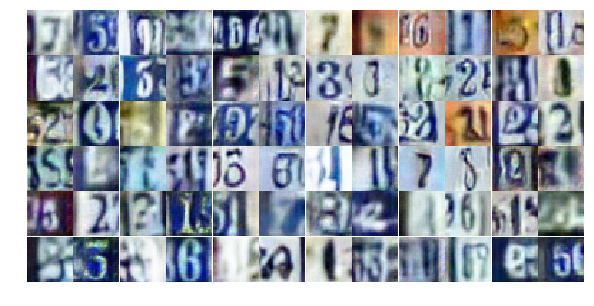

Epoch 19/25... Discriminator Loss: 0.9336... Generator Loss: 0.7253
Epoch 19/25... Discriminator Loss: 0.7059... Generator Loss: 0.9935
Epoch 19/25... Discriminator Loss: 0.6660... Generator Loss: 2.5001
Epoch 19/25... Discriminator Loss: 1.0482... Generator Loss: 0.6518
Epoch 19/25... Discriminator Loss: 0.9958... Generator Loss: 2.4378
Epoch 19/25... Discriminator Loss: 1.0812... Generator Loss: 0.6851
Epoch 19/25... Discriminator Loss: 1.4472... Generator Loss: 0.4007
Epoch 19/25... Discriminator Loss: 0.5449... Generator Loss: 1.3039
Epoch 20/25... Discriminator Loss: 0.5897... Generator Loss: 1.3247
Epoch 20/25... Discriminator Loss: 0.9849... Generator Loss: 0.6598


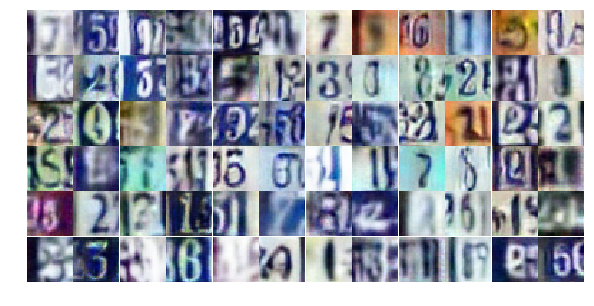

Epoch 20/25... Discriminator Loss: 0.6600... Generator Loss: 1.0214
Epoch 20/25... Discriminator Loss: 0.9343... Generator Loss: 0.7521
Epoch 20/25... Discriminator Loss: 1.1619... Generator Loss: 0.5589
Epoch 20/25... Discriminator Loss: 1.4170... Generator Loss: 0.4405
Epoch 20/25... Discriminator Loss: 0.5898... Generator Loss: 1.1102
Epoch 20/25... Discriminator Loss: 1.2068... Generator Loss: 0.5534
Epoch 20/25... Discriminator Loss: 0.8018... Generator Loss: 0.8541
Epoch 20/25... Discriminator Loss: 0.7785... Generator Loss: 0.8891
Epoch 20/25... Discriminator Loss: 0.8022... Generator Loss: 0.9831
Epoch 20/25... Discriminator Loss: 0.6903... Generator Loss: 0.9596


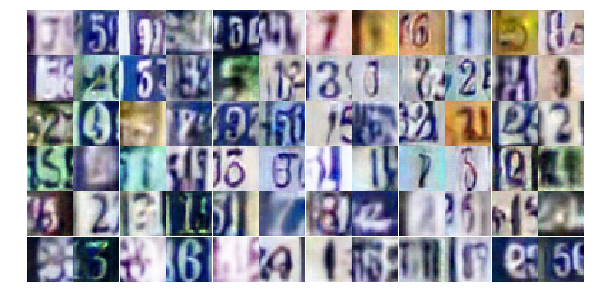

Epoch 20/25... Discriminator Loss: 1.5547... Generator Loss: 0.4414
Epoch 20/25... Discriminator Loss: 0.9724... Generator Loss: 0.7403
Epoch 20/25... Discriminator Loss: 0.8699... Generator Loss: 0.8729
Epoch 20/25... Discriminator Loss: 0.7783... Generator Loss: 0.9135
Epoch 20/25... Discriminator Loss: 0.9742... Generator Loss: 0.6624
Epoch 20/25... Discriminator Loss: 0.7817... Generator Loss: 0.8191
Epoch 20/25... Discriminator Loss: 2.1715... Generator Loss: 0.1862
Epoch 20/25... Discriminator Loss: 0.6376... Generator Loss: 2.1742
Epoch 20/25... Discriminator Loss: 0.7117... Generator Loss: 1.0243
Epoch 20/25... Discriminator Loss: 1.1941... Generator Loss: 0.5373


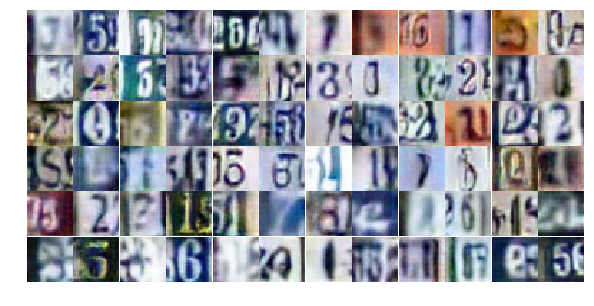

Epoch 20/25... Discriminator Loss: 0.6305... Generator Loss: 1.0830
Epoch 20/25... Discriminator Loss: 0.8508... Generator Loss: 0.7758
Epoch 20/25... Discriminator Loss: 0.3891... Generator Loss: 1.4006
Epoch 20/25... Discriminator Loss: 1.6547... Generator Loss: 0.3967
Epoch 20/25... Discriminator Loss: 1.1210... Generator Loss: 0.6500
Epoch 20/25... Discriminator Loss: 0.4597... Generator Loss: 1.7058
Epoch 20/25... Discriminator Loss: 1.0154... Generator Loss: 3.5679
Epoch 20/25... Discriminator Loss: 2.1484... Generator Loss: 0.2527
Epoch 20/25... Discriminator Loss: 0.9331... Generator Loss: 0.7349
Epoch 20/25... Discriminator Loss: 0.5496... Generator Loss: 1.2079


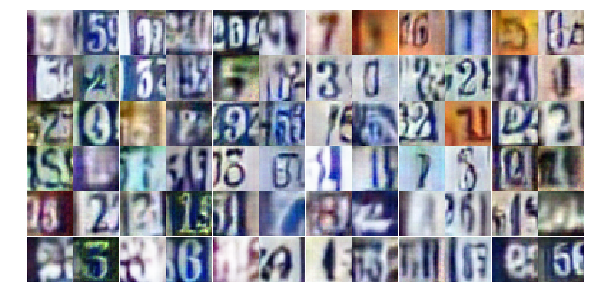

Epoch 20/25... Discriminator Loss: 0.7279... Generator Loss: 1.0329
Epoch 20/25... Discriminator Loss: 0.4881... Generator Loss: 1.3732
Epoch 20/25... Discriminator Loss: 1.1759... Generator Loss: 0.5732
Epoch 20/25... Discriminator Loss: 0.6908... Generator Loss: 1.3131
Epoch 20/25... Discriminator Loss: 0.8492... Generator Loss: 0.8702
Epoch 20/25... Discriminator Loss: 0.5492... Generator Loss: 1.4049
Epoch 20/25... Discriminator Loss: 0.8921... Generator Loss: 0.7366
Epoch 20/25... Discriminator Loss: 0.8329... Generator Loss: 0.9298
Epoch 20/25... Discriminator Loss: 0.6898... Generator Loss: 1.1843
Epoch 20/25... Discriminator Loss: 1.1843... Generator Loss: 0.5185


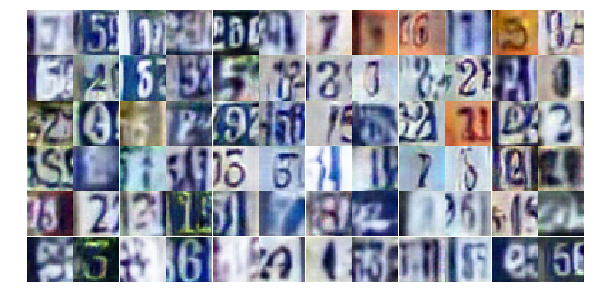

Epoch 20/25... Discriminator Loss: 0.9288... Generator Loss: 0.7679
Epoch 20/25... Discriminator Loss: 0.8934... Generator Loss: 0.7512
Epoch 20/25... Discriminator Loss: 0.8146... Generator Loss: 2.2965
Epoch 20/25... Discriminator Loss: 0.7867... Generator Loss: 0.8911
Epoch 20/25... Discriminator Loss: 0.8135... Generator Loss: 0.8731
Epoch 20/25... Discriminator Loss: 0.8462... Generator Loss: 0.7924
Epoch 20/25... Discriminator Loss: 1.0391... Generator Loss: 0.6472
Epoch 20/25... Discriminator Loss: 0.4740... Generator Loss: 1.4186
Epoch 20/25... Discriminator Loss: 0.6953... Generator Loss: 1.1918
Epoch 20/25... Discriminator Loss: 0.6023... Generator Loss: 1.2347


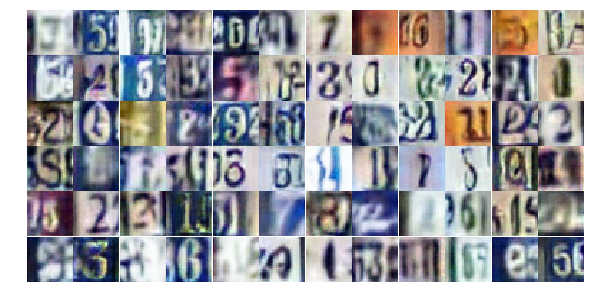

Epoch 20/25... Discriminator Loss: 0.5421... Generator Loss: 1.6286
Epoch 20/25... Discriminator Loss: 1.3524... Generator Loss: 2.9711
Epoch 20/25... Discriminator Loss: 0.8468... Generator Loss: 1.6953
Epoch 20/25... Discriminator Loss: 0.9745... Generator Loss: 0.9845
Epoch 20/25... Discriminator Loss: 0.6678... Generator Loss: 1.0093
Epoch 20/25... Discriminator Loss: 0.5395... Generator Loss: 1.2947
Epoch 21/25... Discriminator Loss: 0.8666... Generator Loss: 0.7948
Epoch 21/25... Discriminator Loss: 0.9174... Generator Loss: 0.6967
Epoch 21/25... Discriminator Loss: 1.3174... Generator Loss: 0.4995
Epoch 21/25... Discriminator Loss: 1.0984... Generator Loss: 0.6364


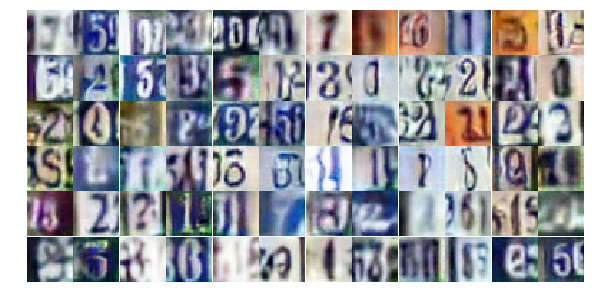

Epoch 21/25... Discriminator Loss: 0.5555... Generator Loss: 1.4799
Epoch 21/25... Discriminator Loss: 1.9588... Generator Loss: 0.2145
Epoch 21/25... Discriminator Loss: 0.5014... Generator Loss: 1.6015
Epoch 21/25... Discriminator Loss: 0.4495... Generator Loss: 1.3986
Epoch 21/25... Discriminator Loss: 0.9337... Generator Loss: 0.7450
Epoch 21/25... Discriminator Loss: 0.4709... Generator Loss: 1.4323
Epoch 21/25... Discriminator Loss: 0.9649... Generator Loss: 0.7243
Epoch 21/25... Discriminator Loss: 0.8299... Generator Loss: 0.8448
Epoch 21/25... Discriminator Loss: 0.7899... Generator Loss: 0.8995
Epoch 21/25... Discriminator Loss: 1.0307... Generator Loss: 0.5997


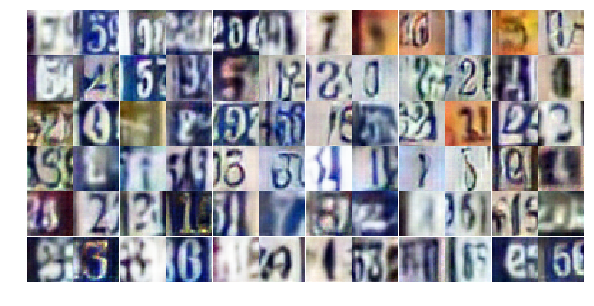

Epoch 21/25... Discriminator Loss: 0.4776... Generator Loss: 1.2918
Epoch 21/25... Discriminator Loss: 1.0510... Generator Loss: 0.5892
Epoch 21/25... Discriminator Loss: 1.5416... Generator Loss: 0.3801
Epoch 21/25... Discriminator Loss: 0.7523... Generator Loss: 0.9122
Epoch 21/25... Discriminator Loss: 0.6142... Generator Loss: 1.1450
Epoch 21/25... Discriminator Loss: 1.0196... Generator Loss: 0.7175
Epoch 21/25... Discriminator Loss: 0.6809... Generator Loss: 1.1215
Epoch 21/25... Discriminator Loss: 0.4601... Generator Loss: 1.3919
Epoch 21/25... Discriminator Loss: 0.5850... Generator Loss: 1.2329
Epoch 21/25... Discriminator Loss: 0.7612... Generator Loss: 0.9789


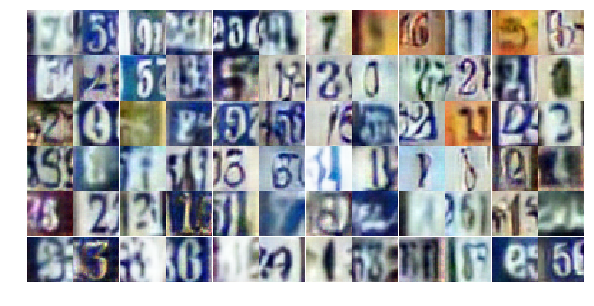

Epoch 21/25... Discriminator Loss: 1.3897... Generator Loss: 0.4318
Epoch 21/25... Discriminator Loss: 0.3772... Generator Loss: 1.6158
Epoch 21/25... Discriminator Loss: 1.0589... Generator Loss: 0.8374
Epoch 21/25... Discriminator Loss: 0.7156... Generator Loss: 1.1565
Epoch 21/25... Discriminator Loss: 0.8028... Generator Loss: 0.9418
Epoch 21/25... Discriminator Loss: 0.8593... Generator Loss: 1.1718
Epoch 21/25... Discriminator Loss: 0.9397... Generator Loss: 0.7149
Epoch 21/25... Discriminator Loss: 0.7799... Generator Loss: 0.9220
Epoch 21/25... Discriminator Loss: 1.2147... Generator Loss: 0.5327
Epoch 21/25... Discriminator Loss: 1.3969... Generator Loss: 0.4230


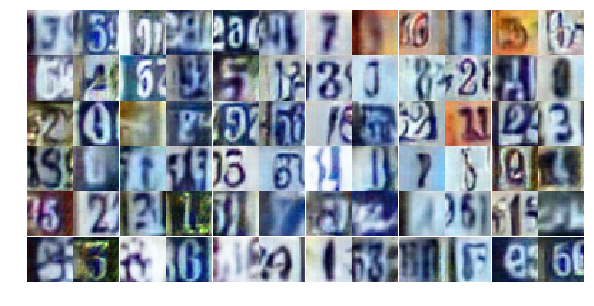

Epoch 21/25... Discriminator Loss: 1.0391... Generator Loss: 0.6473
Epoch 21/25... Discriminator Loss: 1.0127... Generator Loss: 0.7357
Epoch 21/25... Discriminator Loss: 1.2704... Generator Loss: 1.0841
Epoch 21/25... Discriminator Loss: 0.4303... Generator Loss: 1.9987
Epoch 21/25... Discriminator Loss: 0.7245... Generator Loss: 1.0770
Epoch 21/25... Discriminator Loss: 0.9516... Generator Loss: 0.7039
Epoch 21/25... Discriminator Loss: 0.8925... Generator Loss: 0.7220
Epoch 21/25... Discriminator Loss: 1.1566... Generator Loss: 0.6068
Epoch 21/25... Discriminator Loss: 0.7267... Generator Loss: 0.9152
Epoch 21/25... Discriminator Loss: 0.8670... Generator Loss: 0.9165


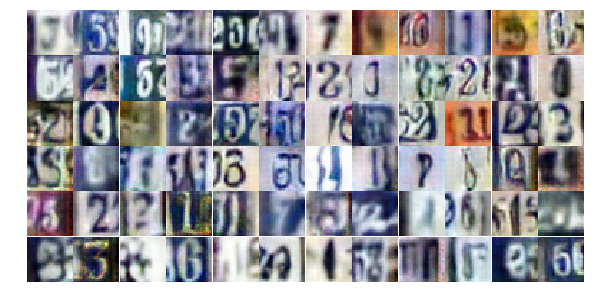

Epoch 21/25... Discriminator Loss: 0.7784... Generator Loss: 2.9682
Epoch 21/25... Discriminator Loss: 1.1806... Generator Loss: 0.5653
Epoch 21/25... Discriminator Loss: 0.6989... Generator Loss: 0.9844
Epoch 21/25... Discriminator Loss: 1.0053... Generator Loss: 0.7391
Epoch 21/25... Discriminator Loss: 0.5541... Generator Loss: 1.4318
Epoch 21/25... Discriminator Loss: 0.7273... Generator Loss: 0.9730
Epoch 21/25... Discriminator Loss: 0.8159... Generator Loss: 0.8841
Epoch 21/25... Discriminator Loss: 0.8915... Generator Loss: 0.7589
Epoch 21/25... Discriminator Loss: 1.4276... Generator Loss: 0.4031
Epoch 21/25... Discriminator Loss: 0.5247... Generator Loss: 1.3010


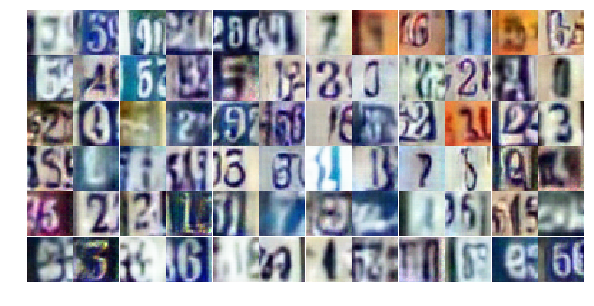

Epoch 21/25... Discriminator Loss: 0.7351... Generator Loss: 1.0029
Epoch 21/25... Discriminator Loss: 0.8603... Generator Loss: 1.0973
Epoch 21/25... Discriminator Loss: 0.9010... Generator Loss: 0.7990
Epoch 22/25... Discriminator Loss: 1.0290... Generator Loss: 2.3916
Epoch 22/25... Discriminator Loss: 0.9025... Generator Loss: 0.8249
Epoch 22/25... Discriminator Loss: 0.6654... Generator Loss: 1.1028
Epoch 22/25... Discriminator Loss: 0.5372... Generator Loss: 1.2964
Epoch 22/25... Discriminator Loss: 0.4987... Generator Loss: 1.1563
Epoch 22/25... Discriminator Loss: 0.9510... Generator Loss: 0.7436
Epoch 22/25... Discriminator Loss: 0.8113... Generator Loss: 0.7966


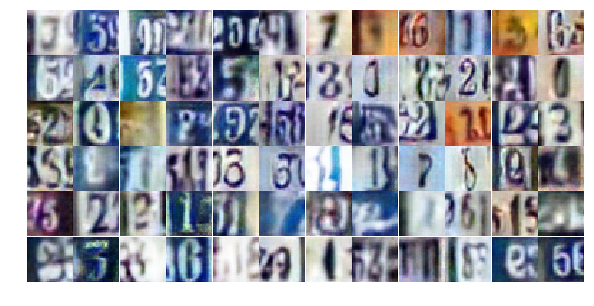

Epoch 22/25... Discriminator Loss: 0.6375... Generator Loss: 1.4581
Epoch 22/25... Discriminator Loss: 0.8336... Generator Loss: 0.8257
Epoch 22/25... Discriminator Loss: 1.5746... Generator Loss: 0.4178
Epoch 22/25... Discriminator Loss: 0.7344... Generator Loss: 1.0081
Epoch 22/25... Discriminator Loss: 0.9865... Generator Loss: 0.6772
Epoch 22/25... Discriminator Loss: 0.5725... Generator Loss: 1.5767
Epoch 22/25... Discriminator Loss: 0.7454... Generator Loss: 0.8826
Epoch 22/25... Discriminator Loss: 0.5234... Generator Loss: 1.7531
Epoch 22/25... Discriminator Loss: 1.0813... Generator Loss: 0.5938
Epoch 22/25... Discriminator Loss: 1.2138... Generator Loss: 0.4942


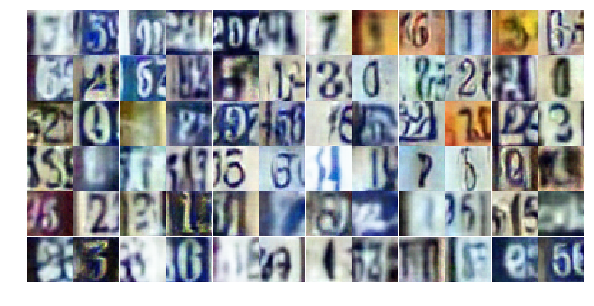

Epoch 22/25... Discriminator Loss: 0.6059... Generator Loss: 1.3491
Epoch 22/25... Discriminator Loss: 0.6454... Generator Loss: 1.0882
Epoch 22/25... Discriminator Loss: 0.8757... Generator Loss: 0.8038
Epoch 22/25... Discriminator Loss: 0.5469... Generator Loss: 1.1661
Epoch 22/25... Discriminator Loss: 0.5465... Generator Loss: 1.3095
Epoch 22/25... Discriminator Loss: 1.8727... Generator Loss: 0.2731
Epoch 22/25... Discriminator Loss: 0.6803... Generator Loss: 2.3734
Epoch 22/25... Discriminator Loss: 0.5377... Generator Loss: 1.4113
Epoch 22/25... Discriminator Loss: 0.6626... Generator Loss: 2.1789
Epoch 22/25... Discriminator Loss: 0.9672... Generator Loss: 0.8151


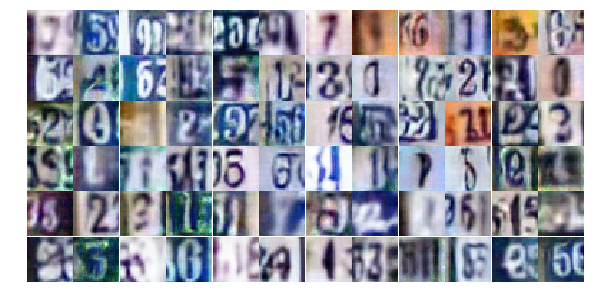

Epoch 22/25... Discriminator Loss: 0.4811... Generator Loss: 1.3299
Epoch 22/25... Discriminator Loss: 0.6096... Generator Loss: 1.0947
Epoch 22/25... Discriminator Loss: 0.8331... Generator Loss: 0.9407
Epoch 22/25... Discriminator Loss: 1.0743... Generator Loss: 0.5735
Epoch 22/25... Discriminator Loss: 0.9571... Generator Loss: 0.8981
Epoch 22/25... Discriminator Loss: 0.9453... Generator Loss: 0.7940
Epoch 22/25... Discriminator Loss: 1.1289... Generator Loss: 0.5642
Epoch 22/25... Discriminator Loss: 0.6323... Generator Loss: 1.1694
Epoch 22/25... Discriminator Loss: 0.8582... Generator Loss: 0.8802
Epoch 22/25... Discriminator Loss: 1.2677... Generator Loss: 0.5338


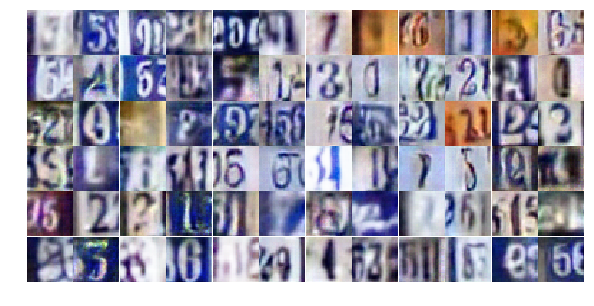

Epoch 22/25... Discriminator Loss: 0.8047... Generator Loss: 1.1658
Epoch 22/25... Discriminator Loss: 0.7118... Generator Loss: 0.9946
Epoch 22/25... Discriminator Loss: 0.4544... Generator Loss: 1.3013
Epoch 22/25... Discriminator Loss: 0.7453... Generator Loss: 0.9856
Epoch 22/25... Discriminator Loss: 0.4253... Generator Loss: 1.9688
Epoch 22/25... Discriminator Loss: 0.4142... Generator Loss: 1.6525
Epoch 22/25... Discriminator Loss: 0.6987... Generator Loss: 0.9806
Epoch 22/25... Discriminator Loss: 1.5570... Generator Loss: 0.4842
Epoch 22/25... Discriminator Loss: 1.0542... Generator Loss: 0.7770
Epoch 22/25... Discriminator Loss: 0.5938... Generator Loss: 1.4212


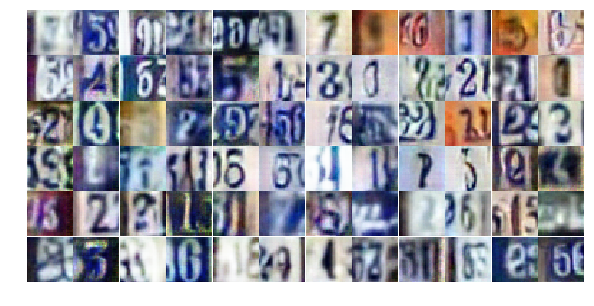

Epoch 22/25... Discriminator Loss: 1.3970... Generator Loss: 0.4206
Epoch 22/25... Discriminator Loss: 0.6707... Generator Loss: 2.7124
Epoch 22/25... Discriminator Loss: 0.7304... Generator Loss: 0.9703
Epoch 22/25... Discriminator Loss: 1.2317... Generator Loss: 0.6078
Epoch 22/25... Discriminator Loss: 0.8325... Generator Loss: 0.8508
Epoch 22/25... Discriminator Loss: 0.7464... Generator Loss: 1.8116
Epoch 22/25... Discriminator Loss: 0.8589... Generator Loss: 1.2064
Epoch 22/25... Discriminator Loss: 0.7441... Generator Loss: 0.9179
Epoch 22/25... Discriminator Loss: 0.8433... Generator Loss: 1.1263
Epoch 22/25... Discriminator Loss: 1.0387... Generator Loss: 0.6475


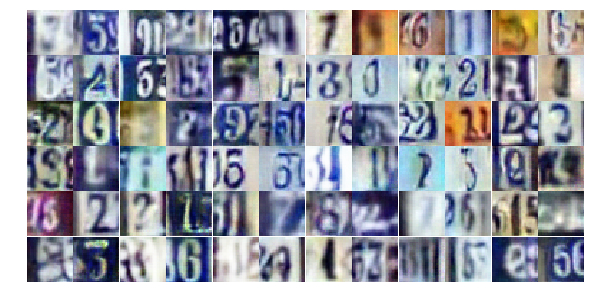

Epoch 23/25... Discriminator Loss: 0.3563... Generator Loss: 1.8743
Epoch 23/25... Discriminator Loss: 0.6492... Generator Loss: 1.0721
Epoch 23/25... Discriminator Loss: 0.7979... Generator Loss: 0.8975
Epoch 23/25... Discriminator Loss: 0.5308... Generator Loss: 1.2657
Epoch 23/25... Discriminator Loss: 1.0024... Generator Loss: 0.6008
Epoch 23/25... Discriminator Loss: 1.2285... Generator Loss: 0.5014
Epoch 23/25... Discriminator Loss: 1.6251... Generator Loss: 0.3489
Epoch 23/25... Discriminator Loss: 0.9255... Generator Loss: 0.7826
Epoch 23/25... Discriminator Loss: 0.9905... Generator Loss: 0.6724
Epoch 23/25... Discriminator Loss: 0.4190... Generator Loss: 1.4632


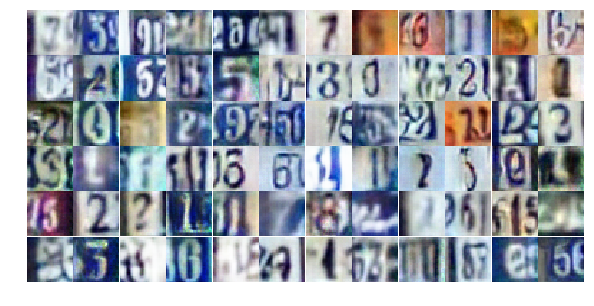

Epoch 23/25... Discriminator Loss: 0.8790... Generator Loss: 0.8103
Epoch 23/25... Discriminator Loss: 0.5506... Generator Loss: 1.4383
Epoch 23/25... Discriminator Loss: 0.8801... Generator Loss: 0.8156
Epoch 23/25... Discriminator Loss: 0.7085... Generator Loss: 1.1019
Epoch 23/25... Discriminator Loss: 0.4017... Generator Loss: 1.5613
Epoch 23/25... Discriminator Loss: 1.0059... Generator Loss: 0.7204
Epoch 23/25... Discriminator Loss: 0.9823... Generator Loss: 0.6605
Epoch 23/25... Discriminator Loss: 0.9099... Generator Loss: 0.7103
Epoch 23/25... Discriminator Loss: 0.6756... Generator Loss: 1.0064
Epoch 23/25... Discriminator Loss: 1.1124... Generator Loss: 0.5459


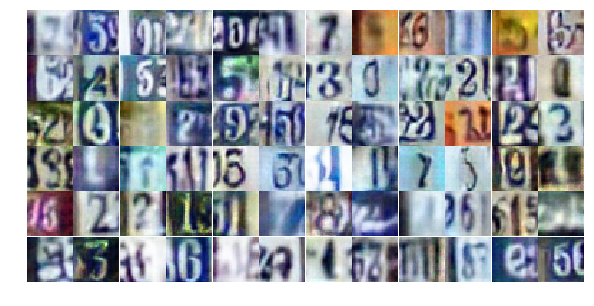

Epoch 23/25... Discriminator Loss: 1.3256... Generator Loss: 0.5256
Epoch 23/25... Discriminator Loss: 0.6919... Generator Loss: 1.0013
Epoch 23/25... Discriminator Loss: 1.2275... Generator Loss: 0.5667
Epoch 23/25... Discriminator Loss: 0.8720... Generator Loss: 0.7587
Epoch 23/25... Discriminator Loss: 1.0980... Generator Loss: 0.6361
Epoch 23/25... Discriminator Loss: 0.7740... Generator Loss: 1.4378
Epoch 23/25... Discriminator Loss: 0.8746... Generator Loss: 0.8248
Epoch 23/25... Discriminator Loss: 0.7787... Generator Loss: 0.8870
Epoch 23/25... Discriminator Loss: 0.5093... Generator Loss: 1.3175
Epoch 23/25... Discriminator Loss: 0.7617... Generator Loss: 1.5116


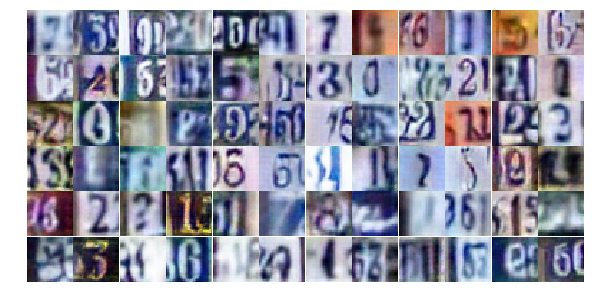

Epoch 23/25... Discriminator Loss: 0.5053... Generator Loss: 1.3258
Epoch 23/25... Discriminator Loss: 0.6728... Generator Loss: 1.0340
Epoch 23/25... Discriminator Loss: 0.8159... Generator Loss: 0.8835
Epoch 23/25... Discriminator Loss: 1.2246... Generator Loss: 0.5138
Epoch 23/25... Discriminator Loss: 2.4167... Generator Loss: 0.2959
Epoch 23/25... Discriminator Loss: 1.4345... Generator Loss: 0.5059
Epoch 23/25... Discriminator Loss: 1.2564... Generator Loss: 0.4885
Epoch 23/25... Discriminator Loss: 0.7927... Generator Loss: 0.9133
Epoch 23/25... Discriminator Loss: 0.4749... Generator Loss: 1.7460
Epoch 23/25... Discriminator Loss: 0.4624... Generator Loss: 1.4428


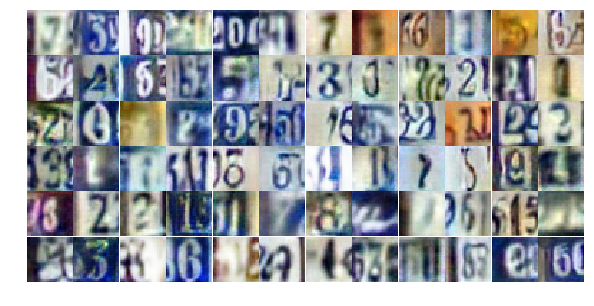

Epoch 23/25... Discriminator Loss: 1.1660... Generator Loss: 0.6886
Epoch 23/25... Discriminator Loss: 0.7555... Generator Loss: 0.9428
Epoch 23/25... Discriminator Loss: 1.3212... Generator Loss: 0.5195
Epoch 23/25... Discriminator Loss: 0.6949... Generator Loss: 0.9794
Epoch 23/25... Discriminator Loss: 0.7392... Generator Loss: 0.9313
Epoch 23/25... Discriminator Loss: 0.8420... Generator Loss: 0.8054
Epoch 23/25... Discriminator Loss: 0.6053... Generator Loss: 1.1957
Epoch 23/25... Discriminator Loss: 1.0170... Generator Loss: 0.6609
Epoch 23/25... Discriminator Loss: 0.7248... Generator Loss: 1.0363
Epoch 23/25... Discriminator Loss: 0.8260... Generator Loss: 0.8319


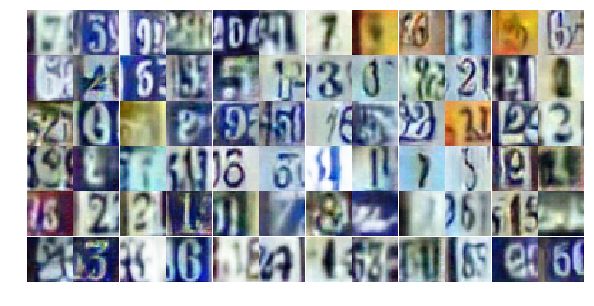

Epoch 23/25... Discriminator Loss: 0.5997... Generator Loss: 1.2147
Epoch 23/25... Discriminator Loss: 1.5451... Generator Loss: 0.4288
Epoch 23/25... Discriminator Loss: 0.9231... Generator Loss: 0.9535
Epoch 23/25... Discriminator Loss: 0.3587... Generator Loss: 1.6556
Epoch 23/25... Discriminator Loss: 1.2590... Generator Loss: 0.5248
Epoch 23/25... Discriminator Loss: 0.6430... Generator Loss: 1.1811
Epoch 23/25... Discriminator Loss: 0.8919... Generator Loss: 0.9010
Epoch 24/25... Discriminator Loss: 1.4227... Generator Loss: 0.4435
Epoch 24/25... Discriminator Loss: 0.7280... Generator Loss: 1.2797
Epoch 24/25... Discriminator Loss: 1.0698... Generator Loss: 0.6304


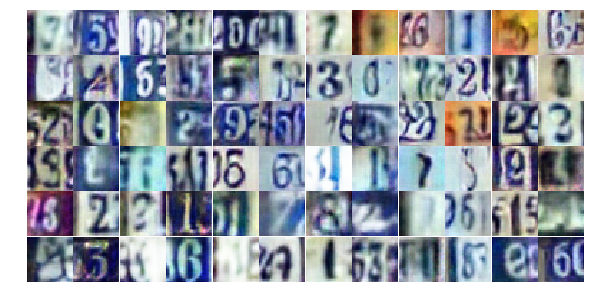

Epoch 24/25... Discriminator Loss: 0.7537... Generator Loss: 1.9426
Epoch 24/25... Discriminator Loss: 0.6631... Generator Loss: 1.0132
Epoch 24/25... Discriminator Loss: 1.0368... Generator Loss: 0.6222
Epoch 24/25... Discriminator Loss: 0.9330... Generator Loss: 0.7335
Epoch 24/25... Discriminator Loss: 0.7238... Generator Loss: 0.9039
Epoch 24/25... Discriminator Loss: 1.0873... Generator Loss: 0.7161
Epoch 24/25... Discriminator Loss: 0.6950... Generator Loss: 1.6500
Epoch 24/25... Discriminator Loss: 1.4857... Generator Loss: 0.3927
Epoch 24/25... Discriminator Loss: 0.2861... Generator Loss: 1.9323
Epoch 24/25... Discriminator Loss: 0.4520... Generator Loss: 1.5715


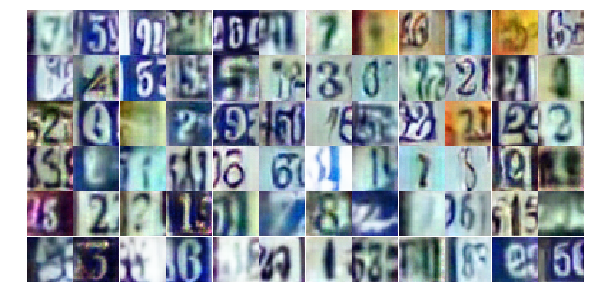

Epoch 24/25... Discriminator Loss: 1.2479... Generator Loss: 0.4882
Epoch 24/25... Discriminator Loss: 0.8739... Generator Loss: 0.8572
Epoch 24/25... Discriminator Loss: 1.2232... Generator Loss: 0.4690
Epoch 24/25... Discriminator Loss: 0.9288... Generator Loss: 0.7268
Epoch 24/25... Discriminator Loss: 1.0729... Generator Loss: 0.6297
Epoch 24/25... Discriminator Loss: 1.1956... Generator Loss: 0.5559
Epoch 24/25... Discriminator Loss: 0.6518... Generator Loss: 1.0924
Epoch 24/25... Discriminator Loss: 1.6058... Generator Loss: 0.3143
Epoch 24/25... Discriminator Loss: 0.8513... Generator Loss: 0.8146
Epoch 24/25... Discriminator Loss: 0.6123... Generator Loss: 1.1951


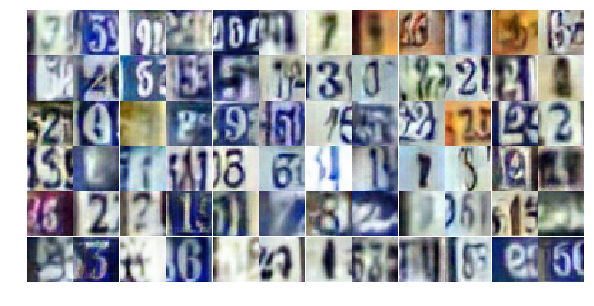

Epoch 24/25... Discriminator Loss: 0.7858... Generator Loss: 0.8699
Epoch 24/25... Discriminator Loss: 0.4776... Generator Loss: 1.5295
Epoch 24/25... Discriminator Loss: 0.6380... Generator Loss: 1.1895
Epoch 24/25... Discriminator Loss: 1.6495... Generator Loss: 0.2960
Epoch 24/25... Discriminator Loss: 0.8776... Generator Loss: 0.8197
Epoch 24/25... Discriminator Loss: 0.5484... Generator Loss: 1.2335
Epoch 24/25... Discriminator Loss: 0.8170... Generator Loss: 0.8463
Epoch 24/25... Discriminator Loss: 0.7438... Generator Loss: 0.8983
Epoch 24/25... Discriminator Loss: 0.6445... Generator Loss: 1.1100
Epoch 24/25... Discriminator Loss: 0.6464... Generator Loss: 1.0735


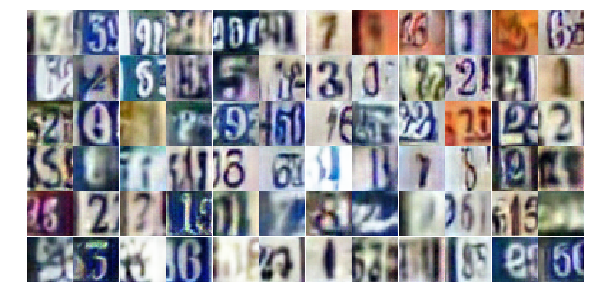

Epoch 24/25... Discriminator Loss: 0.4869... Generator Loss: 2.5457
Epoch 24/25... Discriminator Loss: 0.3593... Generator Loss: 1.7620
Epoch 24/25... Discriminator Loss: 1.0917... Generator Loss: 0.8389
Epoch 24/25... Discriminator Loss: 1.3906... Generator Loss: 0.4650
Epoch 24/25... Discriminator Loss: 0.9200... Generator Loss: 0.7968
Epoch 24/25... Discriminator Loss: 0.7503... Generator Loss: 0.9407
Epoch 24/25... Discriminator Loss: 0.8593... Generator Loss: 0.8822
Epoch 24/25... Discriminator Loss: 0.6932... Generator Loss: 1.2031
Epoch 24/25... Discriminator Loss: 0.7719... Generator Loss: 0.8836
Epoch 24/25... Discriminator Loss: 0.5782... Generator Loss: 1.4509


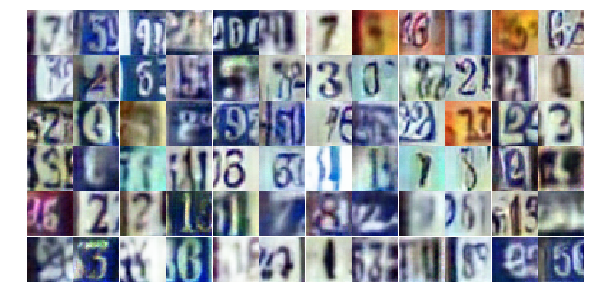

Epoch 24/25... Discriminator Loss: 0.6024... Generator Loss: 1.3085
Epoch 24/25... Discriminator Loss: 1.2124... Generator Loss: 0.5252
Epoch 24/25... Discriminator Loss: 1.7765... Generator Loss: 0.3097
Epoch 24/25... Discriminator Loss: 1.1744... Generator Loss: 0.6155
Epoch 24/25... Discriminator Loss: 1.7347... Generator Loss: 0.3071
Epoch 24/25... Discriminator Loss: 0.6209... Generator Loss: 1.2532
Epoch 24/25... Discriminator Loss: 0.9878... Generator Loss: 0.6920
Epoch 24/25... Discriminator Loss: 0.9353... Generator Loss: 0.7425
Epoch 24/25... Discriminator Loss: 1.3153... Generator Loss: 0.4650
Epoch 24/25... Discriminator Loss: 1.0736... Generator Loss: 0.6766


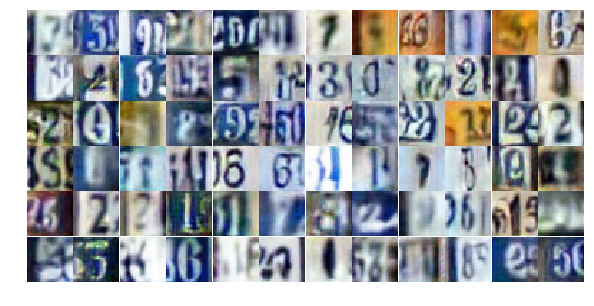

Epoch 24/25... Discriminator Loss: 0.7100... Generator Loss: 1.2797
Epoch 24/25... Discriminator Loss: 1.8303... Generator Loss: 1.6336
Epoch 24/25... Discriminator Loss: 1.8029... Generator Loss: 0.3040
Epoch 24/25... Discriminator Loss: 1.9306... Generator Loss: 0.2474
Epoch 24/25... Discriminator Loss: 1.5401... Generator Loss: 0.4531
Epoch 25/25... Discriminator Loss: 0.6047... Generator Loss: 1.2929
Epoch 25/25... Discriminator Loss: 0.6392... Generator Loss: 1.1877
Epoch 25/25... Discriminator Loss: 0.8103... Generator Loss: 0.8868
Epoch 25/25... Discriminator Loss: 0.8582... Generator Loss: 0.7721
Epoch 25/25... Discriminator Loss: 0.9350... Generator Loss: 0.7326


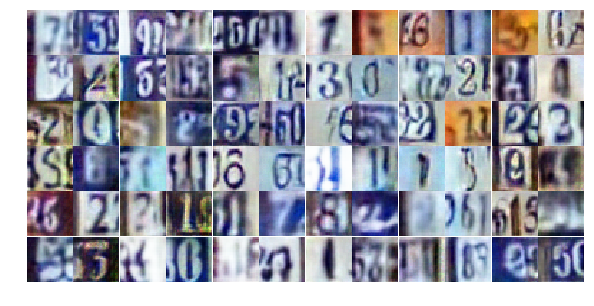

Epoch 25/25... Discriminator Loss: 1.4148... Generator Loss: 0.3972
Epoch 25/25... Discriminator Loss: 1.0226... Generator Loss: 0.8631
Epoch 25/25... Discriminator Loss: 0.9014... Generator Loss: 0.7228
Epoch 25/25... Discriminator Loss: 0.6308... Generator Loss: 1.1358
Epoch 25/25... Discriminator Loss: 0.9086... Generator Loss: 0.7687
Epoch 25/25... Discriminator Loss: 0.9116... Generator Loss: 0.7524
Epoch 25/25... Discriminator Loss: 0.7578... Generator Loss: 0.9773
Epoch 25/25... Discriminator Loss: 0.6190... Generator Loss: 1.2297
Epoch 25/25... Discriminator Loss: 0.5052... Generator Loss: 1.2850
Epoch 25/25... Discriminator Loss: 0.6348... Generator Loss: 1.1012


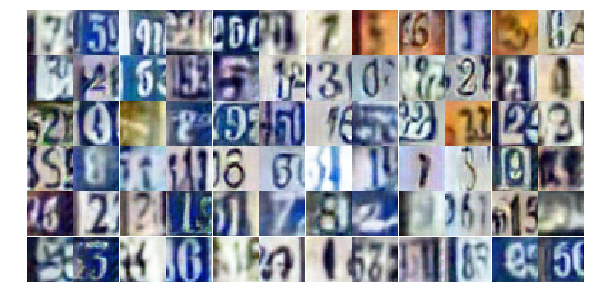

Epoch 25/25... Discriminator Loss: 0.8585... Generator Loss: 0.8253
Epoch 25/25... Discriminator Loss: 0.4689... Generator Loss: 2.3229
Epoch 25/25... Discriminator Loss: 1.0632... Generator Loss: 0.6475
Epoch 25/25... Discriminator Loss: 0.8130... Generator Loss: 1.0660
Epoch 25/25... Discriminator Loss: 0.6496... Generator Loss: 1.4223
Epoch 25/25... Discriminator Loss: 0.4520... Generator Loss: 1.5083
Epoch 25/25... Discriminator Loss: 0.8596... Generator Loss: 0.8084
Epoch 25/25... Discriminator Loss: 1.1016... Generator Loss: 0.6365
Epoch 25/25... Discriminator Loss: 0.5251... Generator Loss: 1.2707
Epoch 25/25... Discriminator Loss: 1.1329... Generator Loss: 0.6055


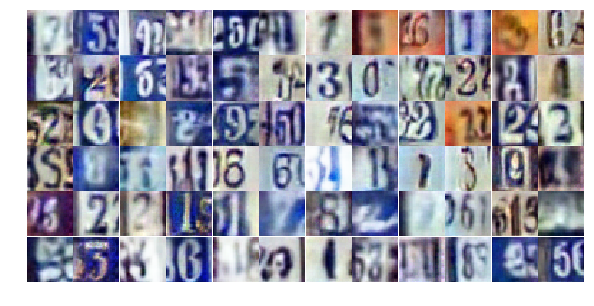

Epoch 25/25... Discriminator Loss: 0.7639... Generator Loss: 0.9300
Epoch 25/25... Discriminator Loss: 0.3955... Generator Loss: 1.9262
Epoch 25/25... Discriminator Loss: 1.7393... Generator Loss: 0.3255
Epoch 25/25... Discriminator Loss: 2.0539... Generator Loss: 0.2615
Epoch 25/25... Discriminator Loss: 1.5516... Generator Loss: 0.5245
Epoch 25/25... Discriminator Loss: 0.6623... Generator Loss: 1.1543
Epoch 25/25... Discriminator Loss: 0.7572... Generator Loss: 1.0432
Epoch 25/25... Discriminator Loss: 0.7911... Generator Loss: 0.9230
Epoch 25/25... Discriminator Loss: 0.8851... Generator Loss: 1.1376
Epoch 25/25... Discriminator Loss: 0.5099... Generator Loss: 1.4133


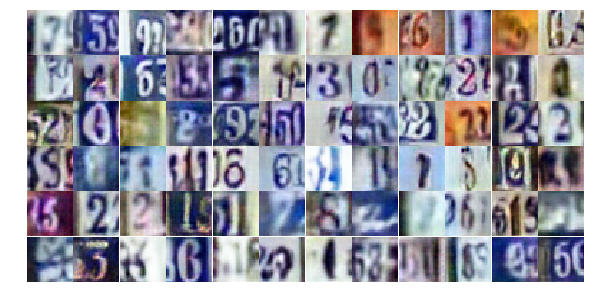

Epoch 25/25... Discriminator Loss: 1.1314... Generator Loss: 0.6180
Epoch 25/25... Discriminator Loss: 0.7594... Generator Loss: 0.8983
Epoch 25/25... Discriminator Loss: 0.9614... Generator Loss: 0.6805
Epoch 25/25... Discriminator Loss: 0.7984... Generator Loss: 0.8683
Epoch 25/25... Discriminator Loss: 1.5174... Generator Loss: 0.3808
Epoch 25/25... Discriminator Loss: 0.9524... Generator Loss: 0.7843
Epoch 25/25... Discriminator Loss: 0.5870... Generator Loss: 1.3402
Epoch 25/25... Discriminator Loss: 0.6044... Generator Loss: 1.1121
Epoch 25/25... Discriminator Loss: 1.4994... Generator Loss: 0.4503
Epoch 25/25... Discriminator Loss: 0.5842... Generator Loss: 1.1511


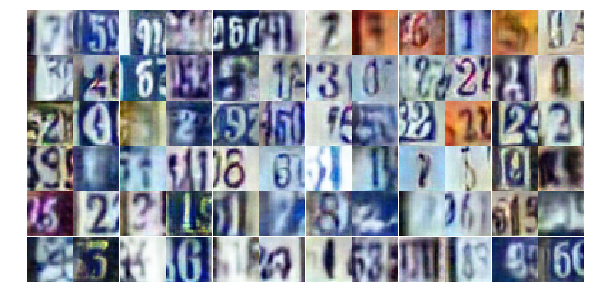

Epoch 25/25... Discriminator Loss: 0.8979... Generator Loss: 0.8343
Epoch 25/25... Discriminator Loss: 0.7381... Generator Loss: 0.9371
Epoch 25/25... Discriminator Loss: 0.8409... Generator Loss: 0.9207
Epoch 25/25... Discriminator Loss: 1.0971... Generator Loss: 0.6226
Epoch 25/25... Discriminator Loss: 0.9520... Generator Loss: 0.6763
Epoch 25/25... Discriminator Loss: 0.4949... Generator Loss: 2.2467
Epoch 25/25... Discriminator Loss: 1.9691... Generator Loss: 0.2184
Epoch 25/25... Discriminator Loss: 0.8444... Generator Loss: 0.8294
Epoch 25/25... Discriminator Loss: 0.9491... Generator Loss: 0.7040
Epoch 25/25... Discriminator Loss: 0.9300... Generator Loss: 1.0748


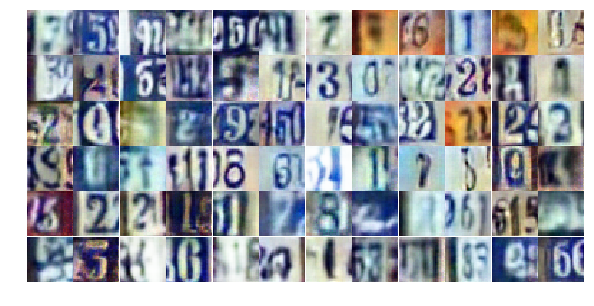

Epoch 25/25... Discriminator Loss: 0.4473... Generator Loss: 1.6779
Epoch 25/25... Discriminator Loss: 1.4512... Generator Loss: 0.3635


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

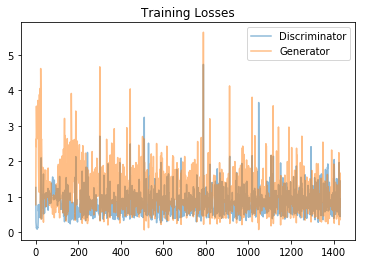

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

c:\users\jonat\anaconda3\envs\dl-py35\lib\site-packages\matplotlib\axes\_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


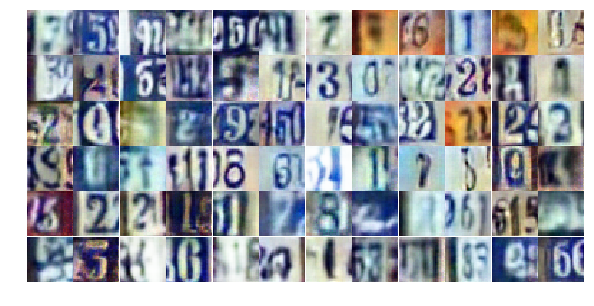

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))